In [1]:
import torch
import torchvision.models as models
from torch.utils.data import Dataset
import os
import pandas as pd
from torchvision.io import read_image
from torchvision import transforms
from torch.nn import CrossEntropyLoss
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader, random_split, Subset, ConcatDataset
import torch.nn as nn
from PIL import Image
from torchvision.transforms.functional import InterpolationMode
import numpy as np
import math
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

In [2]:
class OxfordIIITPetDataset(Dataset):
    @staticmethod
    def extract_breed(name):
        return ' '.join(name.split("_")[:-1]).lower().title()

    def __init__(self, img_dir, transform=None, transform_label=None):
        self.img_dir = img_dir
        self.image_names = [img_name for img_name in os.listdir(img_dir) if img_name.endswith('.jpg')]
        self.transform = transform
        self.transform_label = transform_label
        self.labels = list(set([self.extract_breed(name) for name in self.image_names]))
        self.labels_to_idx = {item: idx for idx, item in enumerate(self.labels)}
        self.values = {}

    def __len__(self):
        return len(self.image_names)
    
    def set_prediction(self, idx, value):
        self.values[idx] = value
    
    def unset_prediction(self, idx):
        if idx in self.values:
            del self.values[idx]

    def get_label(self, idx):
        image_name = self.image_names[idx]
        label = self.extract_breed(image_name)
        return label

    def __getitem__(self, idx):
        image_name = self.image_names[idx]
        img_path = os.path.join(self.img_dir, image_name)
        image = Image.open(img_path).convert('RGB')
        real_label = self.extract_breed(image_name)
        real_label = self.labels_to_idx[real_label]
        label = real_label
        if idx in self.values:
            label = self.values[idx]
        
        if self.transform:
            image = self.transform(image)
        if self.transform_label:
            label = self.transform_label(label)
        return image, label, idx, real_label
    
    def random_split_equal_distribution(self, split_ratios):
        assert sum(split_ratios) == 1.0, "Split ratios must sum to 1"

        label_indices = {label: [] for label in self.labels}

        # Group indices by label
        for idx in range(len(self)):
            label = self.get_label(idx)
            label_indices[label].append(idx)

        sub_indices = [[] for _ in range(len(split_ratios))]
        datasets = [None for _ in range(len(split_ratios))]

        # Shuffle indices within each label group and create subsets
        for label, indices in label_indices.items():
            np.random.shuffle(indices)
            num_samples = len(indices)
            start_idx = 0

            for i, ratio in enumerate(split_ratios):
                end_idx = start_idx + int(ratio * num_samples)
                sub_indices[i].extend(indices[start_idx:end_idx])
                start_idx = end_idx
            
        for i in range(len(split_ratios)):    
            datasets[i] = Subset(self, sub_indices[i])


        return datasets

In [3]:
transform = transforms.Compose([
    transforms.Resize((256, 256), interpolation=InterpolationMode.BILINEAR),
    transforms.CenterCrop((224, 224)), 
    transforms.RandomHorizontalFlip(p=0.2),
    transforms.ColorJitter(brightness=0.2, contrast=0.2),
    transforms.RandomRotation(degrees=15),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

In [4]:
dt = OxfordIIITPetDataset(img_dir='./Dataset/images', transform=transform)
l_dt, u_dt, t_dt = dt.random_split_equal_distribution([0.4, 0.4, 0.2])

In [5]:
def histogram_of_features(dataset, name):
# Initialize an empty dictionary to store the counts of each label
    label_counts = {}

    # Iterate through the dataset to count the occurrences of each label
    for i in range(len(dataset)):
        label = dataset.dataset.get_label(i)
        label = str(label)
        if label not in label_counts:
            label_counts[label] = 0
        label_counts[label] += 1

    # Extract labels and counts from the dictionary
    labels = list(label_counts.keys())
    counts = list(label_counts.values())

    # Plot the histogram
    plt.figure(figsize=(10, 6))
    plt.bar(labels, counts, color='skyblue')
    plt.xlabel('Labels')
    plt.ylabel('Counts')
    plt.title('Histogram of Labels in the Dataset %s' % name)
    plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better visibility
    plt.tight_layout()
    plt.show()

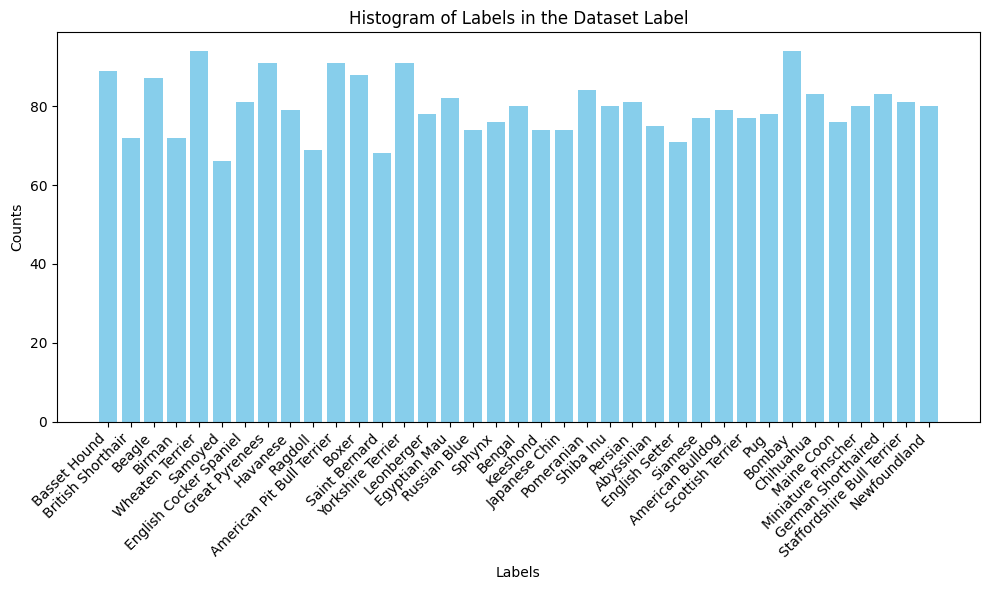

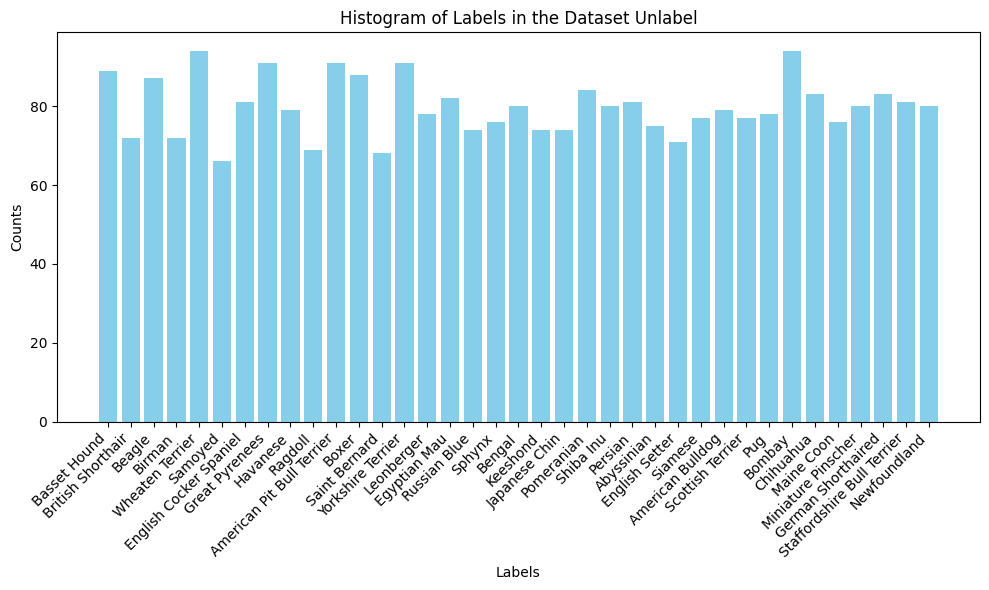

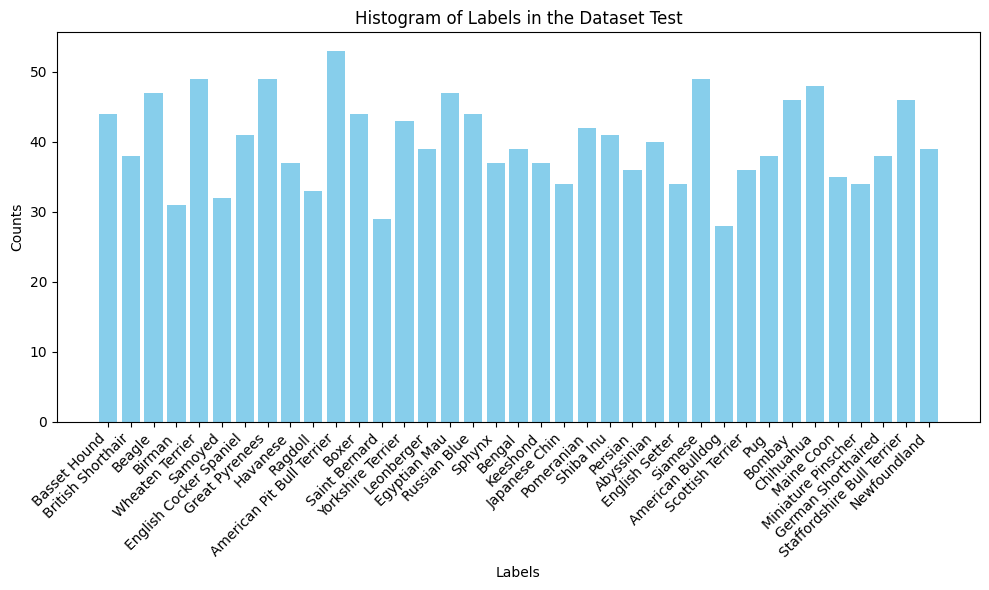

In [6]:
histogram_of_features(l_dt, 'Label')
histogram_of_features(u_dt, 'Unlabel')
histogram_of_features(t_dt, 'Test')

In [7]:
def build_model(n_features, extra_layers=[], enable_batch_norm=False): # None to get the same as previous, int size of the layer
    pretrained_model = models.resnet18(weights="IMAGENET1K_V1")

    for parameter in pretrained_model.parameters():
        parameter.requires_grad = False

    new_layers = []
    previous = pretrained_model.fc.in_features
    for m in extra_layers:
        if m is None:
            m = previous
        new_layers.append(nn.Linear(previous, m))
        if enable_batch_norm:
            new_layers.append(nn.BatchNorm1d(m))
        new_layers.append(nn.ReLU(inplace=True))
        previous = m

    new_layers.append(nn.Linear(previous, n_features))
    if enable_batch_norm:
        new_layers.append(nn.BatchNorm1d(n_features))


    pretrained_model.fc = nn.Sequential(*new_layers)
    return pretrained_model

In [8]:
def test_accuracy(model, test_loader: DataLoader, save_name=None):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    correct = 0
    total = 0
    model.eval()
    all_predictions = []
    all_labels = []

    with torch.no_grad():
        for inputs, labels, _, _ in test_loader:
            inputs = inputs.to(device)  # Move inputs to device (CPU or GPU)
            labels = labels.to(device)  # Move labels to device (CPU or GPU)
            
            # Forward pass
            outputs = model(inputs)
            
            # Get predictions
            _, predicted = torch.max(outputs, 1)

            all_labels.extend(labels.cpu().numpy())
            all_predictions.extend(predicted.cpu().numpy())
            
            # Update counts
            total += labels.size(0)
            correct += (predicted == labels).sum().item()
    
    # Calculate accuracy
    accuracy = correct / total

    if save_name is not None:
        cm = confusion_matrix(all_labels, all_predictions, labels=list(range(len(test_loader.dataset.dataset.labels))))
        cmd = ConfusionMatrixDisplay(cm, display_labels=test_loader.dataset.dataset.labels)
        fig, ax = plt.subplots(figsize=(20,20))
        cmd.plot(ax=ax)
        plt.xticks(rotation=45, ha='right')
        directory = os.path.dirname(save_name)
        if not os.path.exists(directory):
            os.makedirs(directory)
        plt.savefig(save_name, format='svg', bbox_inches='tight')
        plt.show()
    
    return accuracy

In [9]:
def train_model(model: OxfordIIITPetDataset, train_loader: DataLoader, optimizer, epochs, scheduler=None):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model.to(device)
    learning_rates = []

    loss_func = nn.CrossEntropyLoss()
    for epoch in range(epochs):  # loop over the dataset multiple times
        model.train()

        ii = 1
        i = 0

        running_loss = 0.0
        for inputs, labels, _, _ in train_loader:
            inputs = inputs.to(device)
            labels = labels.to(device)
            
            # zero the parameter gradients
            optimizer.zero_grad()

            # forward + backward + optimize
            outputs = model(inputs)
            loss = loss_func(outputs, labels)
            loss.backward()
            optimizer.step()
            if scheduler is not None:
                scheduler.step()
            
            lr = optimizer.param_groups[0]['lr']
            learning_rates.append(lr)

            # print statistics
            running_loss += loss.item()
            i += train_loader.batch_size
            if i >= 2000:    # print every 2000 mini-batches
                print(f'[{epoch + 1}, {i * ii:5d}] loss: {running_loss / 2000:.3f}')
                i = 0
                ii += 1
                running_loss = 0.0
        if i > 0:
            print(f'[{epoch + 1}, {2000 * ii + i:5d}] loss: {running_loss / 2000:.3f}')


    print('Finished Training')
    return learning_rates

In [10]:
def train_model(model: OxfordIIITPetDataset, train_loader: DataLoader, optimizer, epochs, scheduler=None):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model.to(device)
    learning_rates = []

    loss_func = nn.CrossEntropyLoss()
    for epoch in range(epochs):  # loop over the dataset multiple times
        model.train()

        ii = 1
        i = 0

        running_loss = 0.0
        for inputs, labels, idx, _ in train_loader:
            inputs = inputs.to(device)
            labels = labels.to(device)
            
            # zero the parameter gradients
            optimizer.zero_grad()

            try:
                # forward + backward + optimize
                outputs = model(inputs)
                loss = loss_func(outputs, labels)
                loss.backward()
                optimizer.step()
                if scheduler is not None:
                    scheduler.step()
                
                lr = optimizer.param_groups[0]['lr']
                learning_rates.append(lr)

                # print statistics
                running_loss += loss.item()
                i += train_loader.batch_size
                if i >= 2000:    # print every 2000 mini-batches
                    print(f'[{epoch + 1}, {i * ii:5d}] loss: {running_loss / 2000:.3f}')
                    i = 0
                    ii += 1
                    running_loss = 0.0
            except Exception as e:
                print(f"Error occurred at index {idx}: {e}")

        if i > 0:
            print(f'[{epoch + 1}, {2000 * ii + i:5d}] loss: {running_loss / 2000:.3f}')

    print('Finished Training')
    return learning_rates

In [11]:
def predict_unlabeled_data(model: OxfordIIITPetDataset, unlabel_dl, dataset, threshold, save_name=None, num=0):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model.eval()
    all_predictions = []
    all_labels = []
    no_threshold = len(dataset.labels)
    labaled_data = []
    predictions_by_class = {}

    with torch.no_grad():
        for inputs, _, idx, labels in unlabel_dl:
            inputs = inputs.to(device)  # Move inputs to device (CPU or GPU)
            labels = labels.to(device)  # Move labels to device (CPU or GPU)
            
            # Forward pass
            outputs = model(inputs)

            probabilities = nn.functional.softmax(outputs, dim=1)
            
            # Get predictions
            max_probabilities, predicted = torch.max(probabilities, 1)

            # all_labels.extend(labels.cpu().numpy())


            for i in range(len(predicted)):
                list_of_pred = predictions_by_class.get(predicted[i].item(), [])
                list_of_pred.append({'idx': idx[i].item(), 'prob': max_probabilities[i].item(), 'label': labels[i].item()})
                predictions_by_class[predicted[i].item()] = list_of_pred
                dataset.unset_prediction(idx[i].item())
                
        for pred_label, list_of_pred in predictions_by_class.items():
            for item in sorted(list(list_of_pred), key=lambda x: x['prob'], reverse=True)[:num]:
                dataset.set_prediction(item['idx'], pred_label)
                labaled_data.append(item['idx'])
                all_predictions.append(pred_label)
                all_labels.append(item['label'])

    cm = confusion_matrix(all_labels, all_predictions, labels=list(range(no_threshold)))
    cmd = ConfusionMatrixDisplay(cm, display_labels=dataset.labels)
    fig, ax = plt.subplots(figsize=(20,20))
    cmd.plot(ax=ax)
    plt.xticks(rotation=45, ha='right')
    if save_name is not None:
        directory = os.path.dirname(save_name)
        if not os.path.exists(directory):
            os.makedirs(directory)
        plt.savefig(save_name, format='svg', bbox_inches='tight')
    plt.show()
    return labaled_data

In [12]:
def plot_accuracies(accuracies):
    plt.plot(range(1, len(accuracies) + 1), accuracies, marker='o', linestyle='-')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.title('Accuracy over Epochs')
    plt.grid(True)
    plt.show()

def plot_lr(lr):
    plt.plot(lr, marker='o', linestyle='-')
    plt.xlabel('Updates steps')
    plt.ylabel('Learning rate')
    plt.title('Learning rate over Updates steps')
    plt.grid(True)
    plt.show()

In [13]:
def main(extra_layers, unlabeled_percentage=0, epochs=5, sched=None, enable_batch_norm=False, prediction_threshold=0):
    ulp = unlabeled_percentage
    unlabeled_percentage = 0.8 * unlabeled_percentage
    dataset = OxfordIIITPetDataset(img_dir='./Dataset/images', transform=transform)
    label_dataset, unlabel_dataset, test_dataset = dataset.random_split_equal_distribution([0.8 - unlabeled_percentage, unlabeled_percentage, 0.2])
    label_epochs = min(epochs, 5)
    label_batch = 50
    if (len(label_dataset) < 1000):
        label_epochs = 15
        label_batch = 100

    label_dl = DataLoader(label_dataset, batch_size=label_batch, shuffle=True)
    unlabel_dl = DataLoader(unlabel_dataset, batch_size=50, shuffle=True)
    test_dl = DataLoader(test_dataset, batch_size=25, shuffle=False)

    pretrained_model = build_model(n_features=len(label_dl.dataset.dataset.labels), extra_layers=extra_layers, enable_batch_norm=enable_batch_norm)

    optimizer = torch.optim.Adam(pretrained_model.parameters())

    scheduler = None

    if sched == 1:
        step_size = (len(label_dl.dataset) // label_dl.batch_size) // 2
        scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=step_size, gamma=0.9)

    learning_rates1 = train_model(pretrained_model, label_dl, optimizer, epochs=label_epochs, scheduler=scheduler)

    acc = test_accuracy(pretrained_model, test_dl)
    print('Accuracy on test data: %s' % acc)

    unlabeled_number = len(unlabel_dataset)
    unlabeled_labaled_indices = []
    i = 1
    fib = 1
    p_fib = 0

    while len(unlabeled_labaled_indices) < unlabeled_number:
        unlabeled_labaled_indices = predict_unlabeled_data(pretrained_model, unlabel_dl, dataset, threshold=prediction_threshold, save_name='./Pictures/%s_layer_%s_fib/%s.svg' % (len(extra_layers) + 1, str(ulp).replace('.', '_'), i), num=fib)

        train_dataset = Subset(dataset, indices=label_dataset.indices + unlabeled_labaled_indices)
        train_dl = DataLoader(train_dataset, batch_size=25, shuffle=True)
        
        learning_rates2 = train_model(pretrained_model, train_dl, optimizer, epochs=1, scheduler=scheduler)

        acc = test_accuracy(pretrained_model, test_dl)
        print('Accuracy on test data: %s' % acc)
        i += 1
        aux = fib
        fib += p_fib
        p_fib = aux
    
    train_model(pretrained_model, train_dl, optimizer, epochs=5, scheduler=scheduler)
    
    acc = test_accuracy(pretrained_model, test_dl, save_name='./Pictures/%s_layer_%s_fib/final_test.svg' % (len(extra_layers) + 1, str(ulp).replace('.', '_')))
    print('Final accuracy on test data: %s' % acc)
    torch.save(pretrained_model.state_dict(), './models/fib/%s_layer_model_%s.pth' % (len(extra_layers) + 1, str(ulp).replace('.', '_')))

    if sched is not None:
        plot_lr(learning_rates1)
        plot_lr(learning_rates2)

[1,  2100] loss: 0.002
[2,  2100] loss: 0.002
[3,  2100] loss: 0.001
[4,  2100] loss: 0.001
[5,  2100] loss: 0.001
[6,  2100] loss: 0.001
[7,  2100] loss: 0.001
[8,  2100] loss: 0.001
[9,  2100] loss: 0.001
[10,  2100] loss: 0.000
[11,  2100] loss: 0.000
[12,  2100] loss: 0.000
[13,  2100] loss: 0.000
[14,  2100] loss: 0.000
[15,  2100] loss: 0.000
Finished Training
Accuracy on test data: 0.34664861205145564


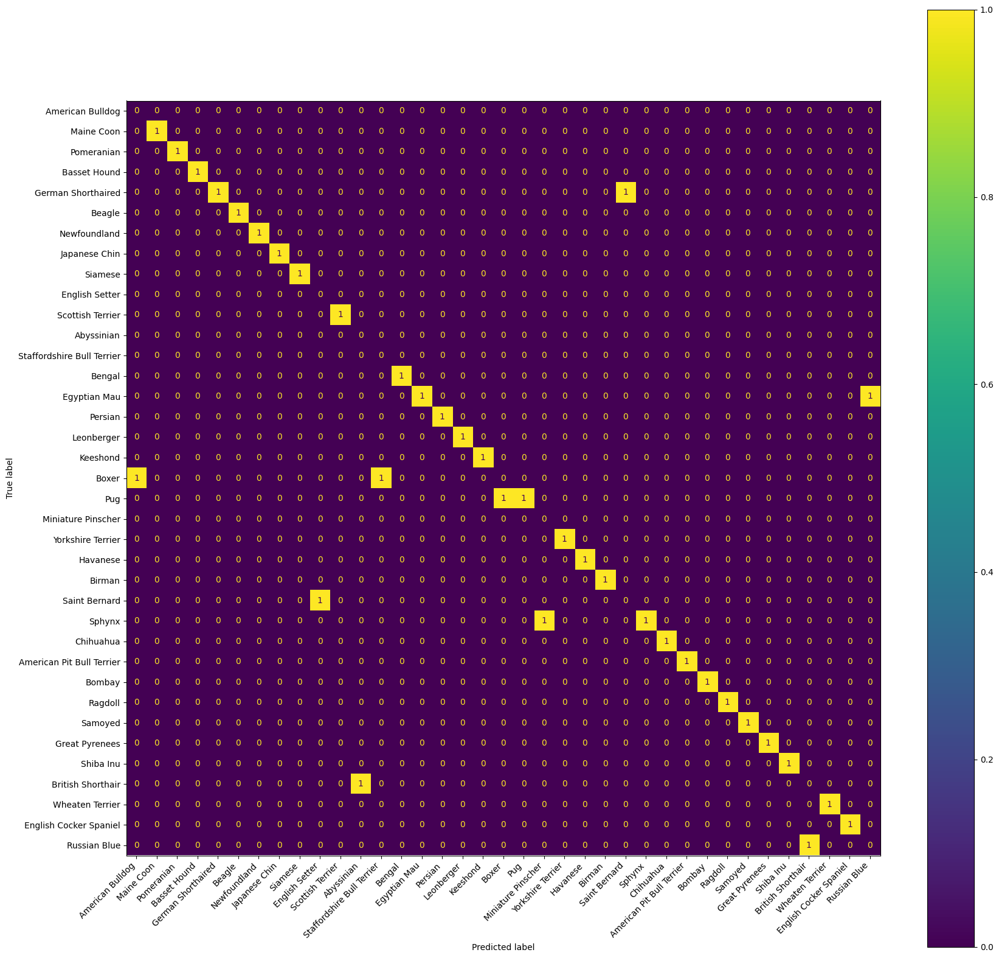

[1,  2075] loss: 0.001
Finished Training
Accuracy on test data: 0.3906567366283006


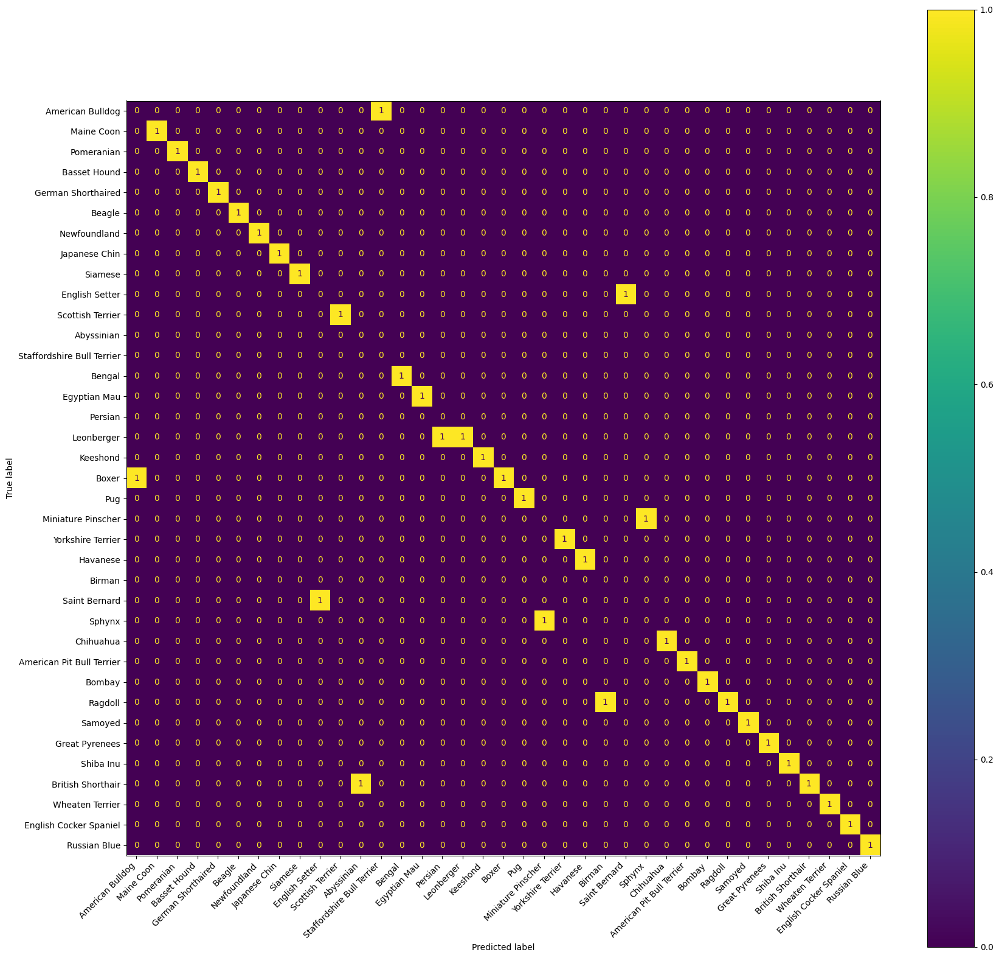

[1,  2075] loss: 0.002
Finished Training
Accuracy on test data: 0.4082599864590386


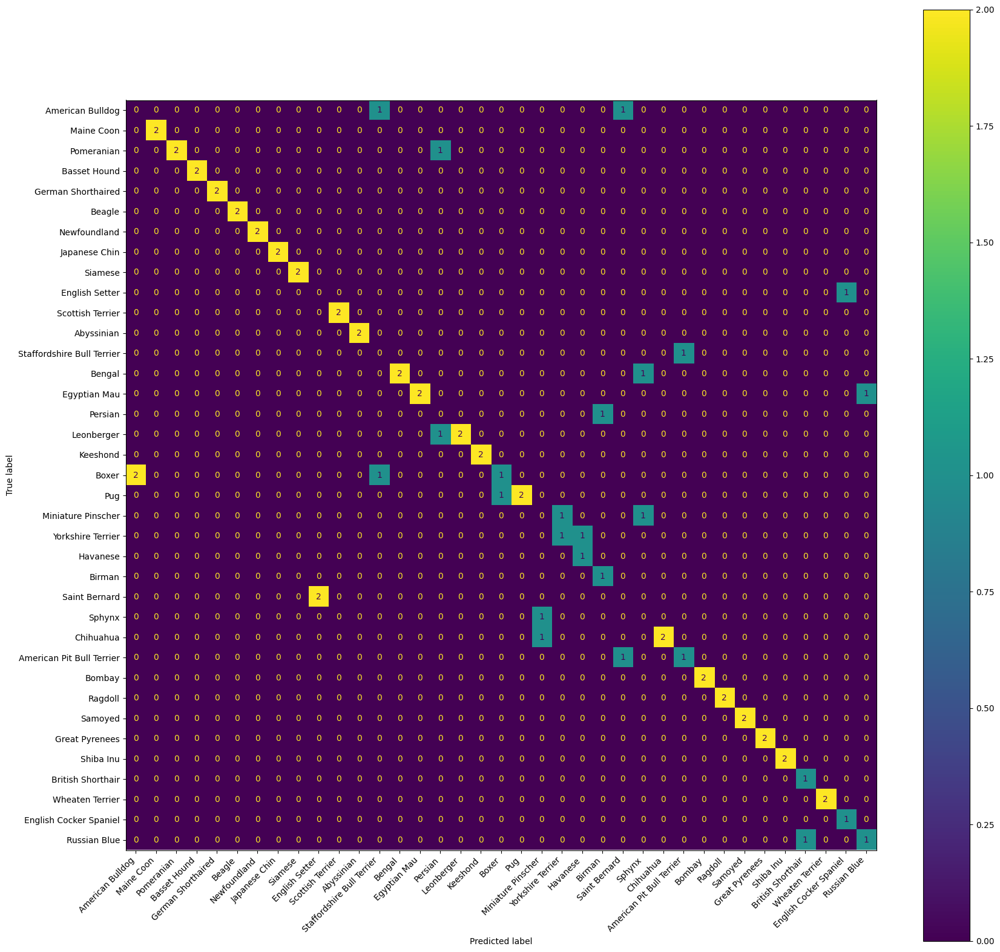

[1,  2125] loss: 0.003
Finished Training
Accuracy on test data: 0.4312796208530806


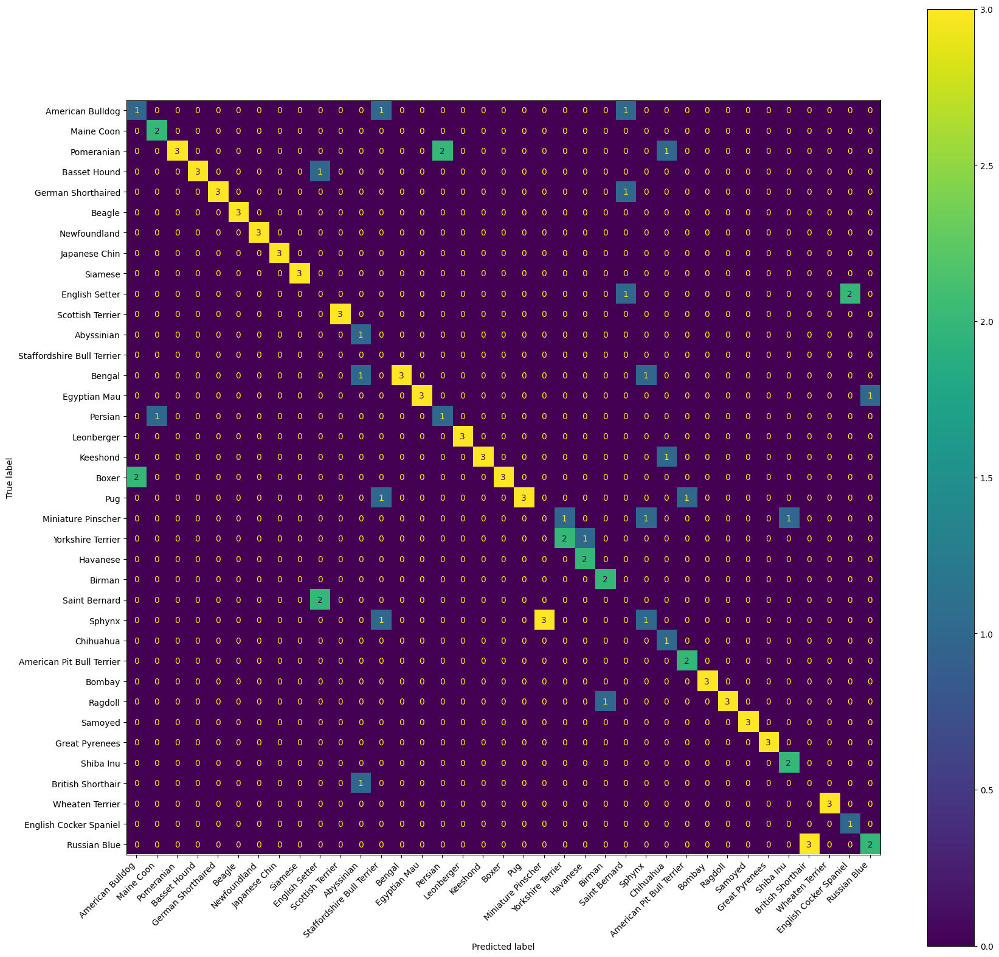

[1,  2150] loss: 0.003
Finished Training
Accuracy on test data: 0.45903859174001355


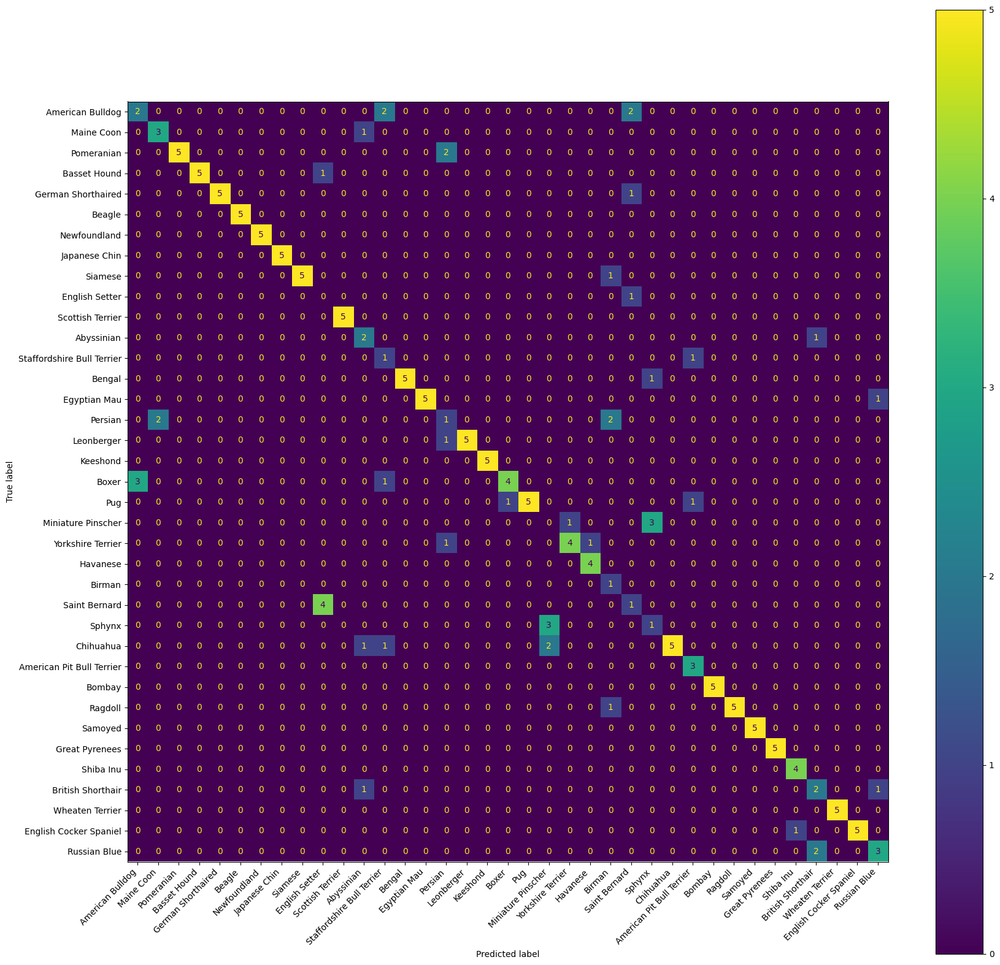

[1,  2225] loss: 0.005
Finished Training
Accuracy on test data: 0.4827352742044685


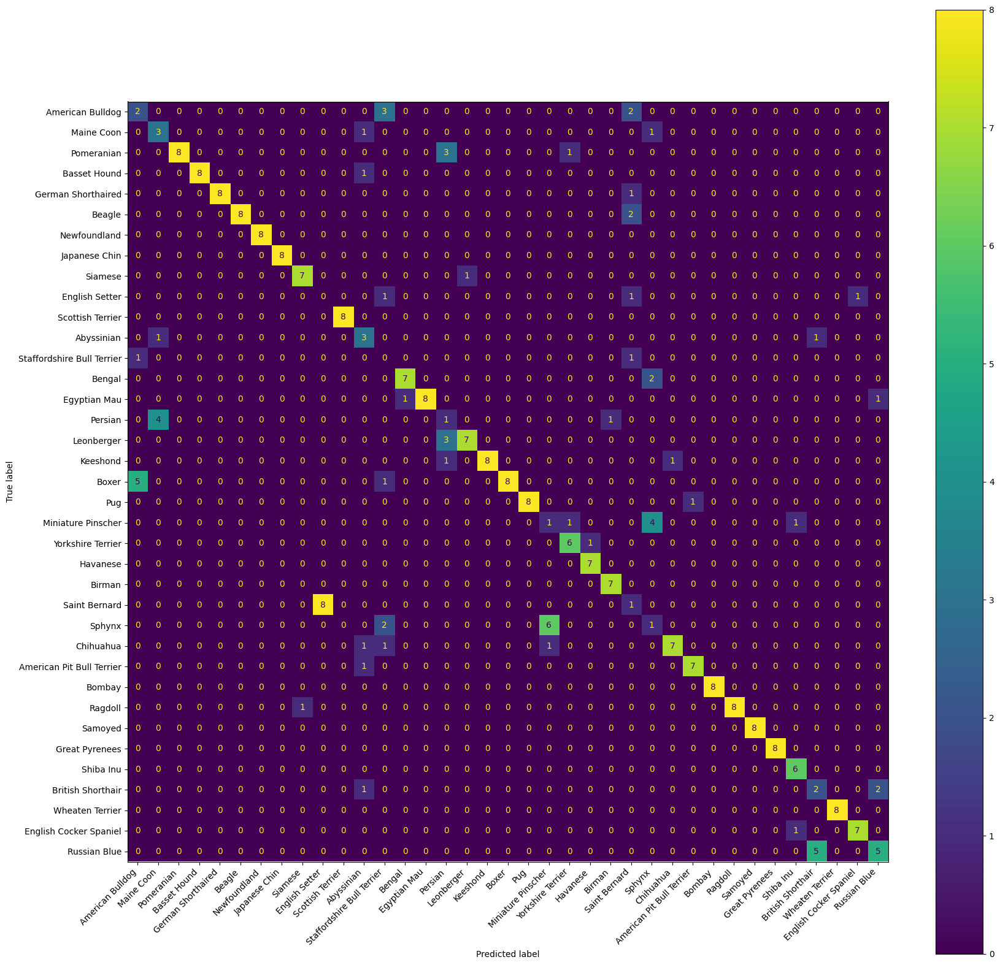

[1,  2350] loss: 0.008
Finished Training
Accuracy on test data: 0.5104942450914015


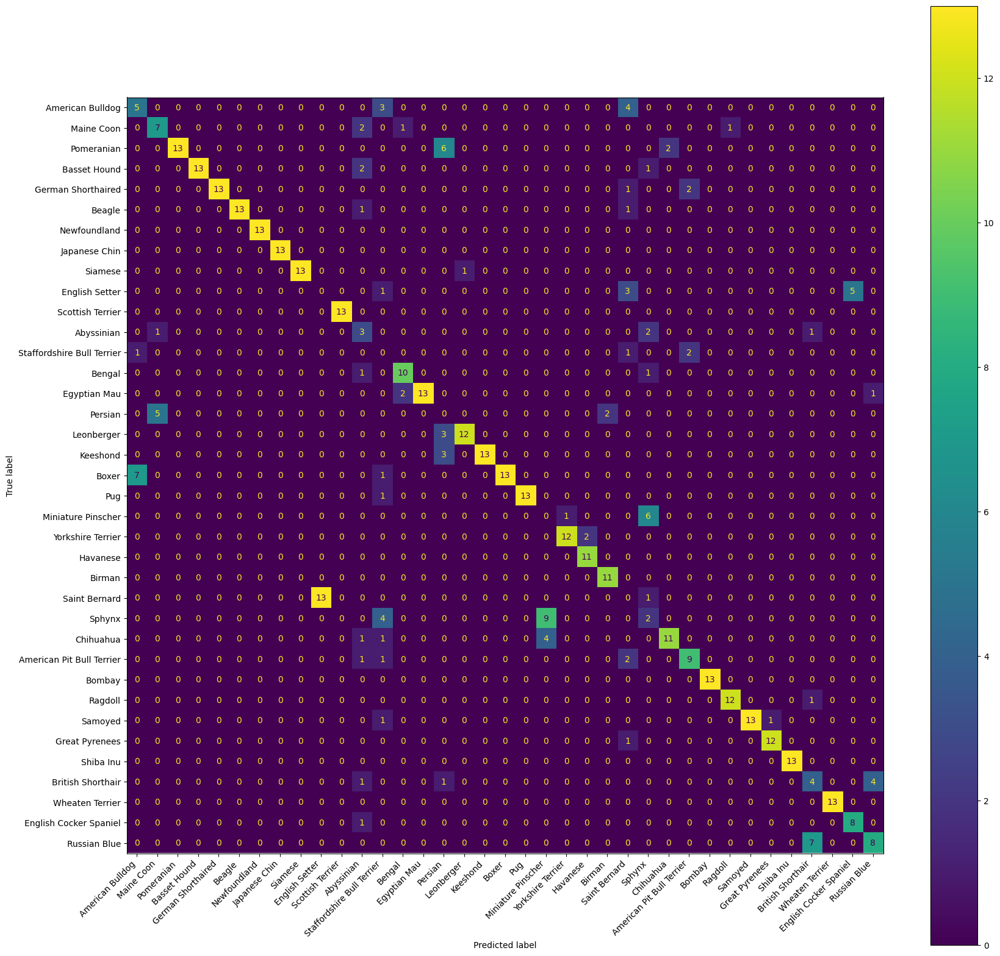

[1,  2525] loss: 0.012
Finished Training
Accuracy on test data: 0.5226811103588355


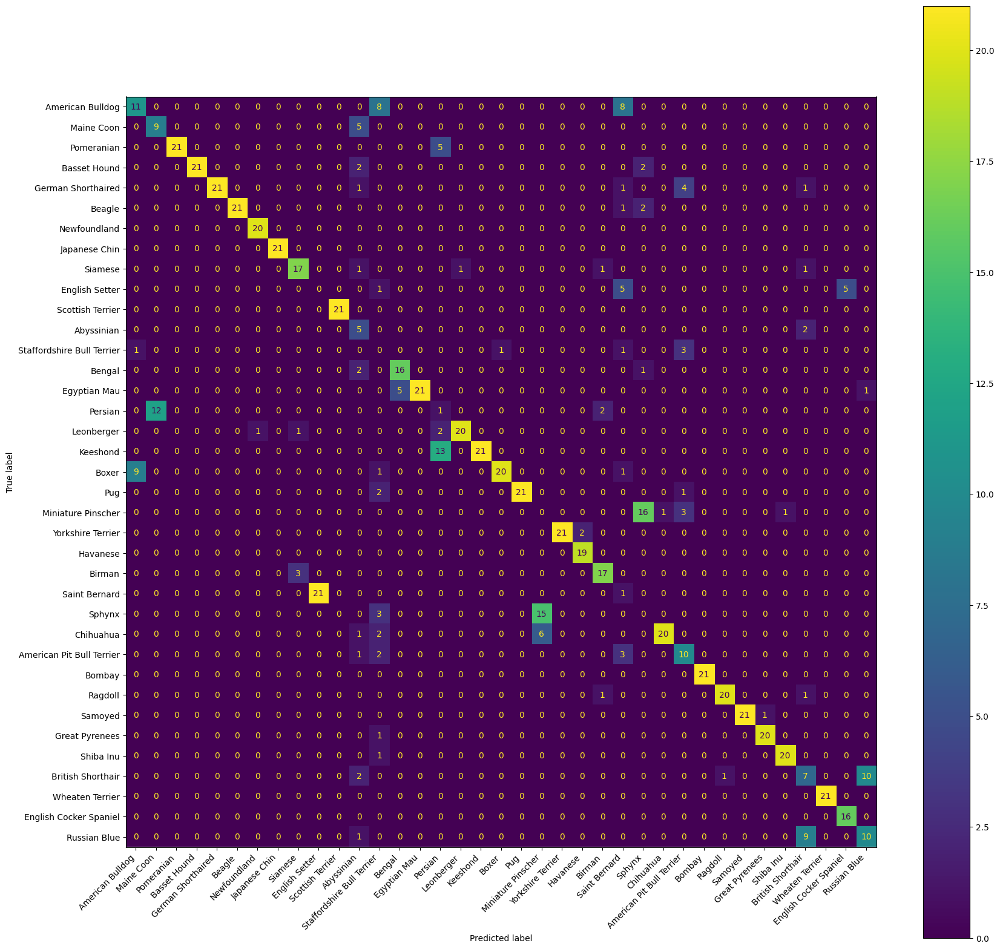

[1,  2825] loss: 0.018
Finished Training
Accuracy on test data: 0.5484089370345294


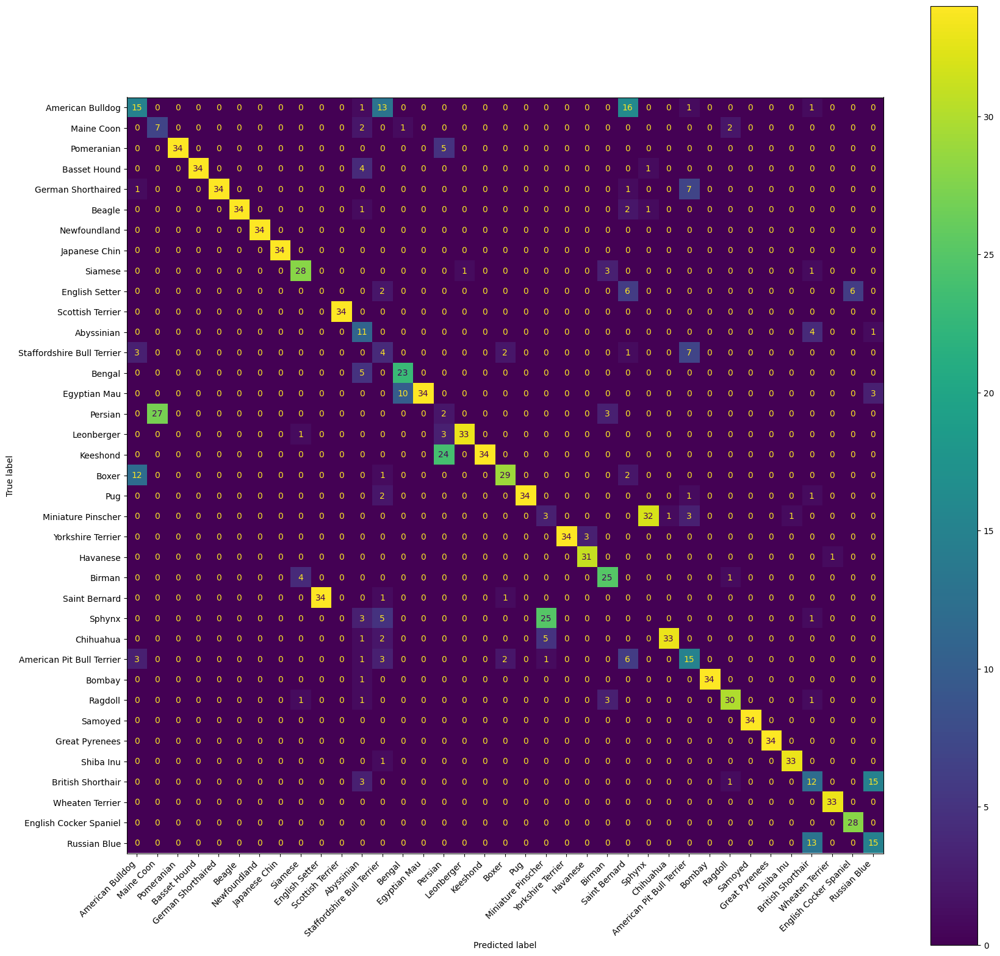

[1,  3300] loss: 0.027
Finished Training
Accuracy on test data: 0.5646580907244414


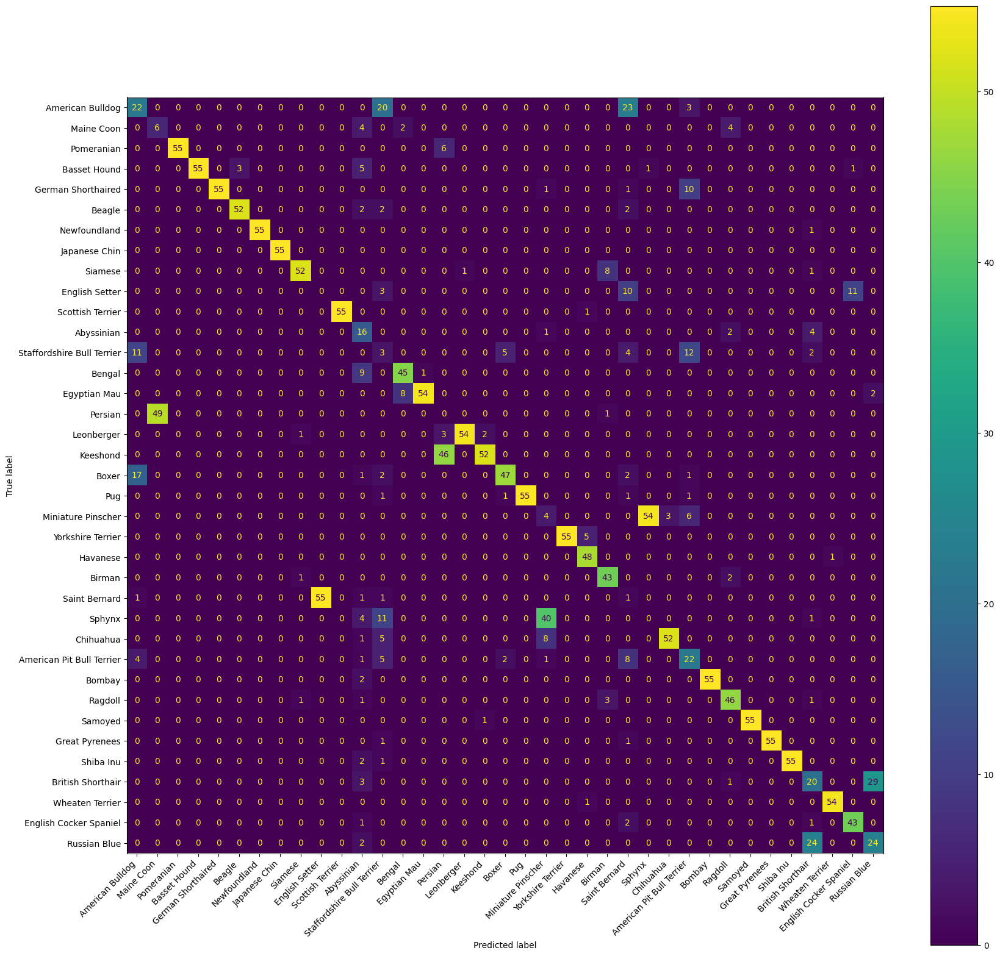

[1,  2000] loss: 0.040
[1,  4075] loss: 0.002
Finished Training
Accuracy on test data: 0.5775220040622884


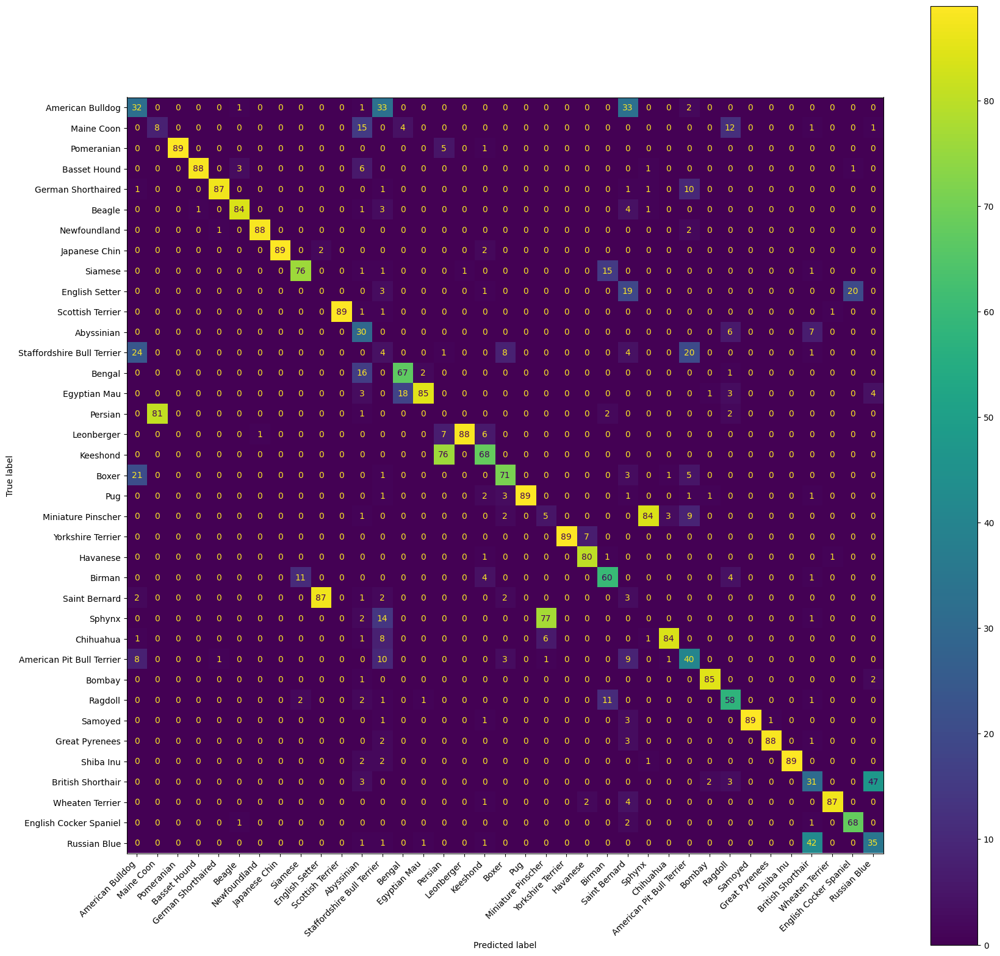

[1,  2000] loss: 0.042
[1,  5350] loss: 0.027
Finished Training
Accuracy on test data: 0.5890318212593094


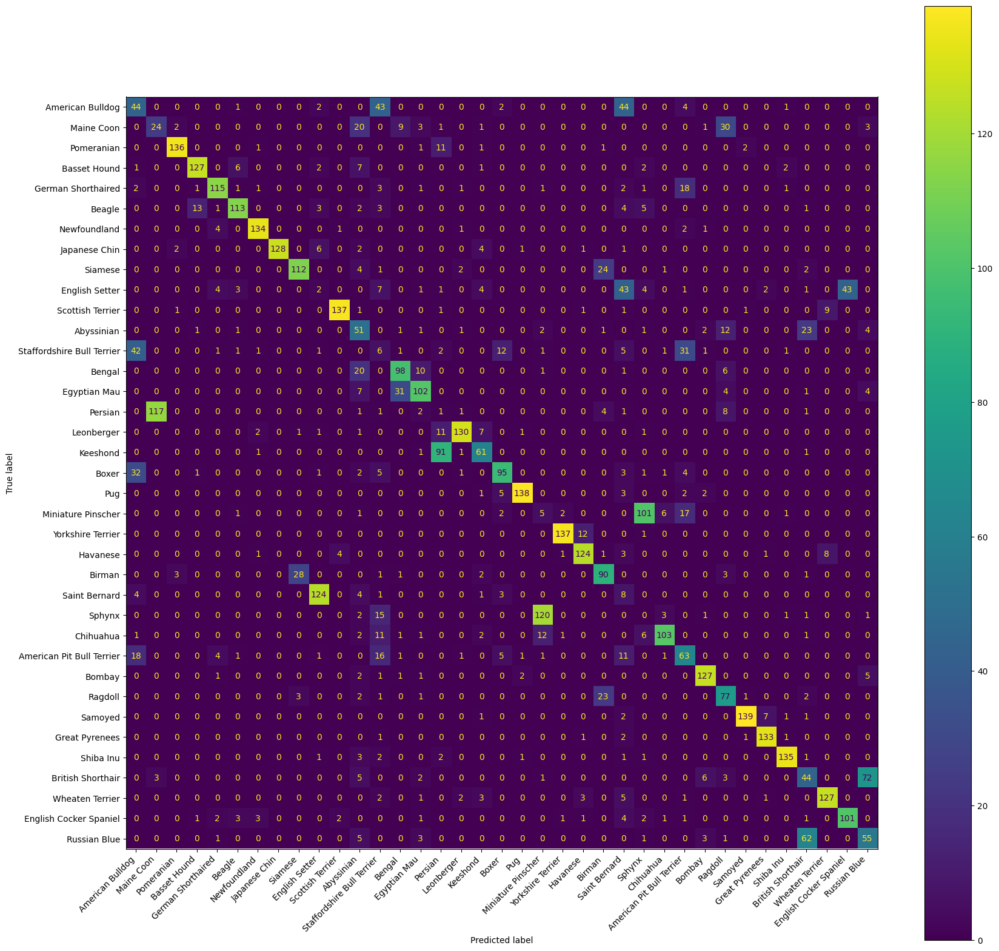

[1,  2000] loss: 0.045
[1,  4000] loss: 0.044
[1,  7150] loss: 0.025
Finished Training
Accuracy on test data: 0.6066350710900474


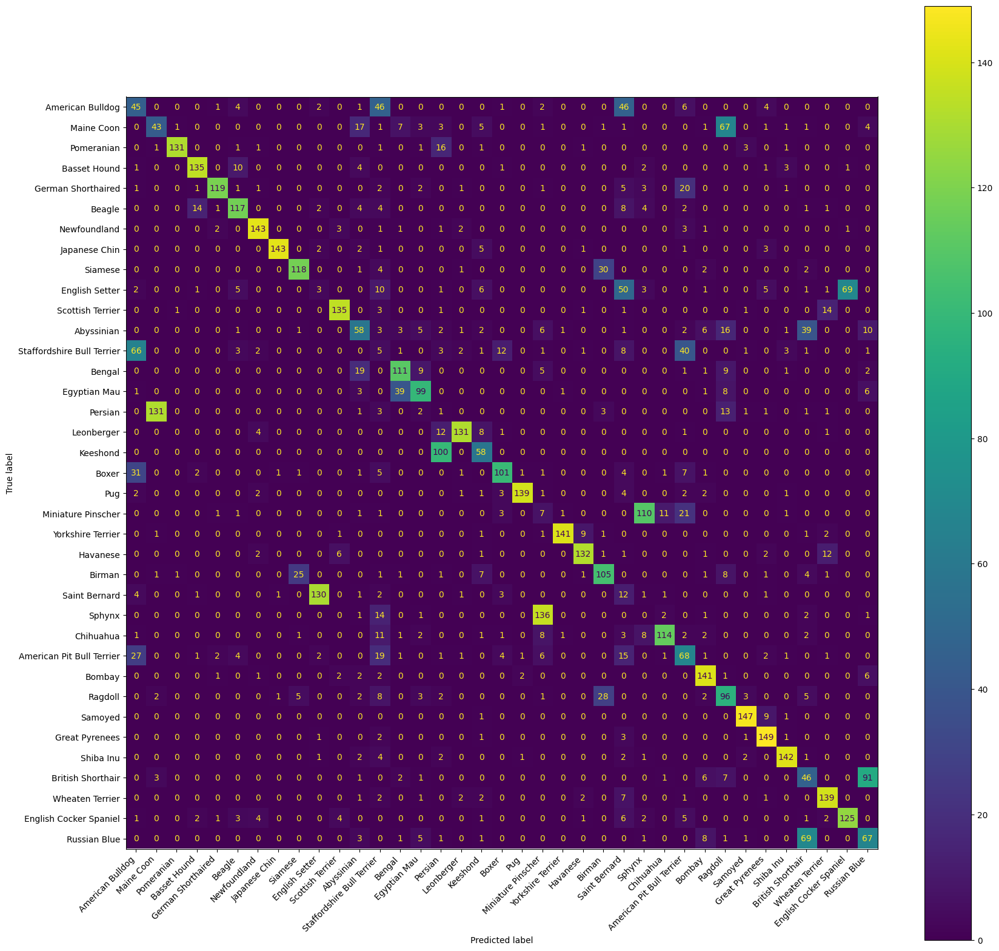

[1,  2000] loss: 0.046
[1,  4000] loss: 0.045
[1,  7875] loss: 0.041
Finished Training
Accuracy on test data: 0.6106973595125254
[1,  2000] loss: 0.040
[1,  4000] loss: 0.040
[1,  7875] loss: 0.039
[2,  2000] loss: 0.038
[2,  4000] loss: 0.037
[2,  7875] loss: 0.036
[3,  2000] loss: 0.037
[3,  4000] loss: 0.037
[3,  7875] loss: 0.034
[4,  2000] loss: 0.036
[4,  4000] loss: 0.035
[4,  7875] loss: 0.032
[5,  2000] loss: 0.033
[5,  4000] loss: 0.033
[5,  7875] loss: 0.031
Finished Training


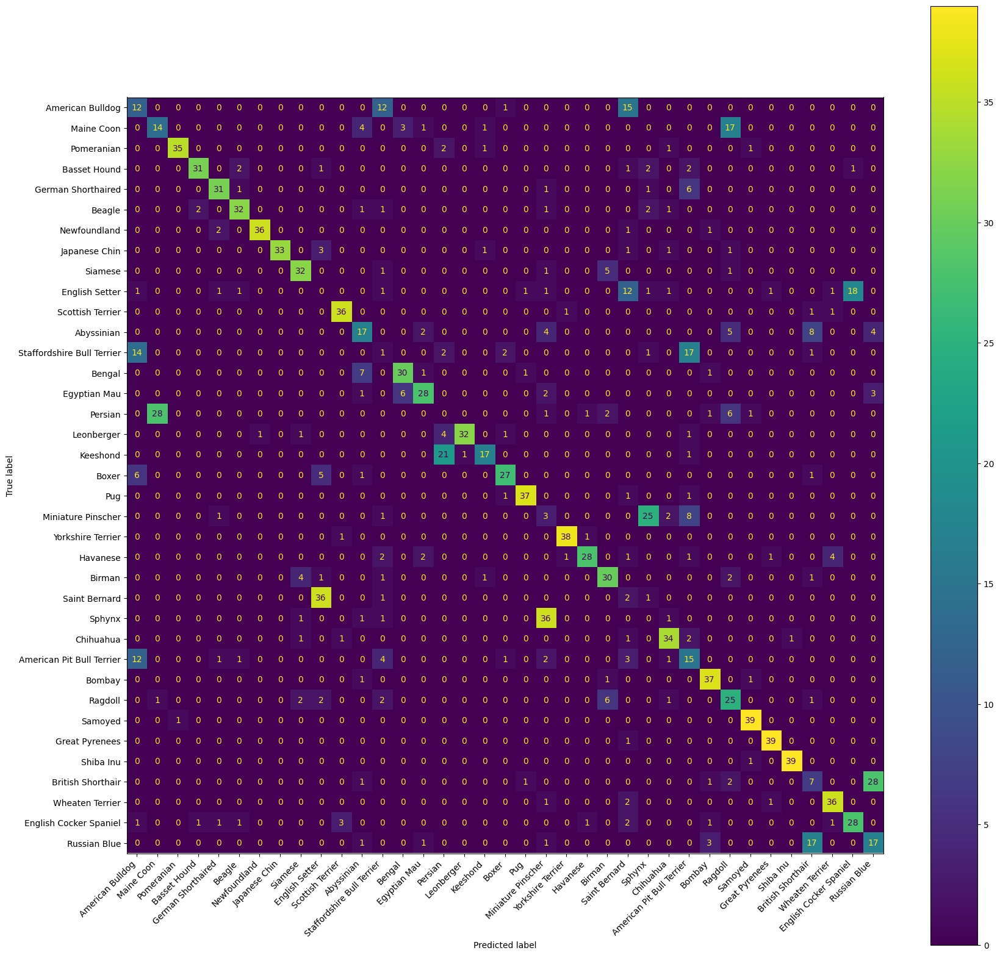

Final accuracy on test data: 0.6079891672308734


In [14]:
main(unlabeled_percentage=0.99, extra_layers=[], epochs=10, enable_batch_norm=True, prediction_threshold=0.45)

[1,  2100] loss: 0.002
[2,  2100] loss: 0.001
[3,  2100] loss: 0.000
[4,  2100] loss: 0.000
[5,  2100] loss: 0.000
[6,  2100] loss: 0.000
[7,  2100] loss: 0.000
[8,  2100] loss: 0.000
[9,  2100] loss: 0.000
[10,  2100] loss: 0.000
[11,  2100] loss: 0.000
[12,  2100] loss: 0.000
[13,  2100] loss: 0.000
[14,  2100] loss: 0.000
[15,  2100] loss: 0.000
Finished Training
Accuracy on test data: 0.43398781313473256


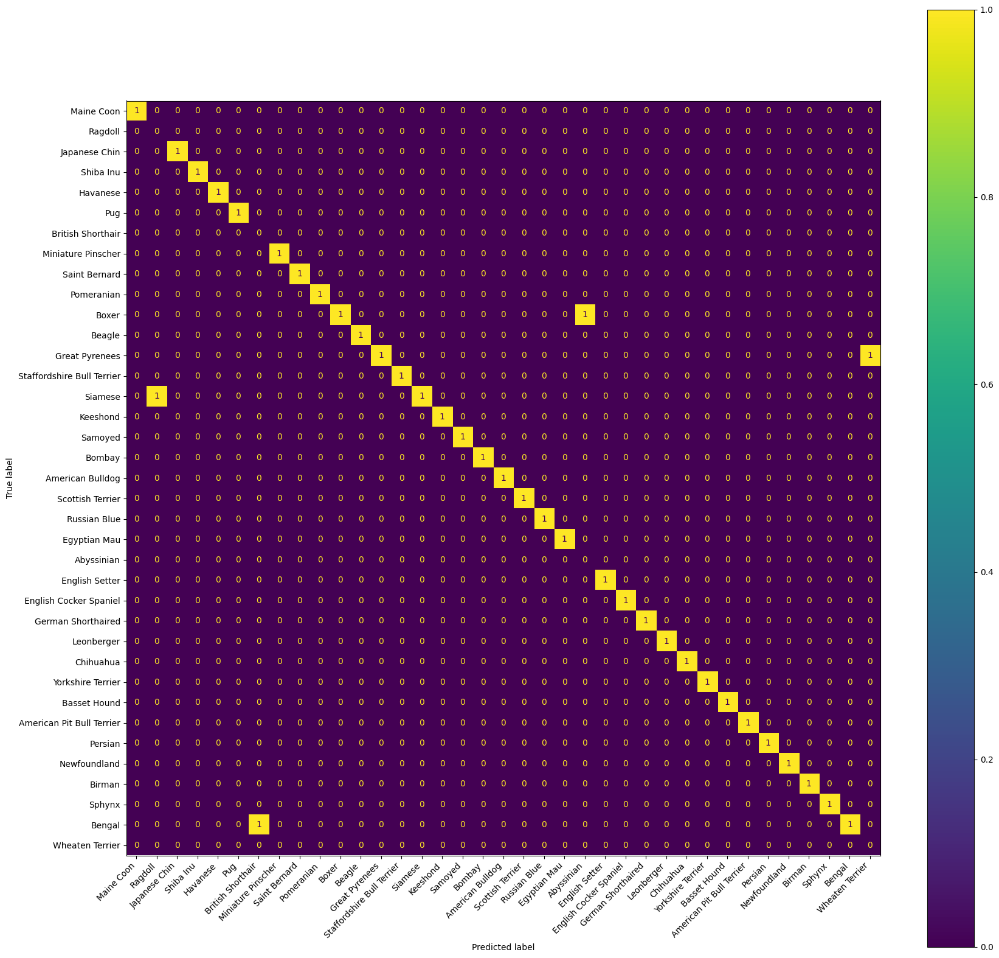

[1,  2075] loss: 0.001
Finished Training
Accuracy on test data: 0.45768449559918756


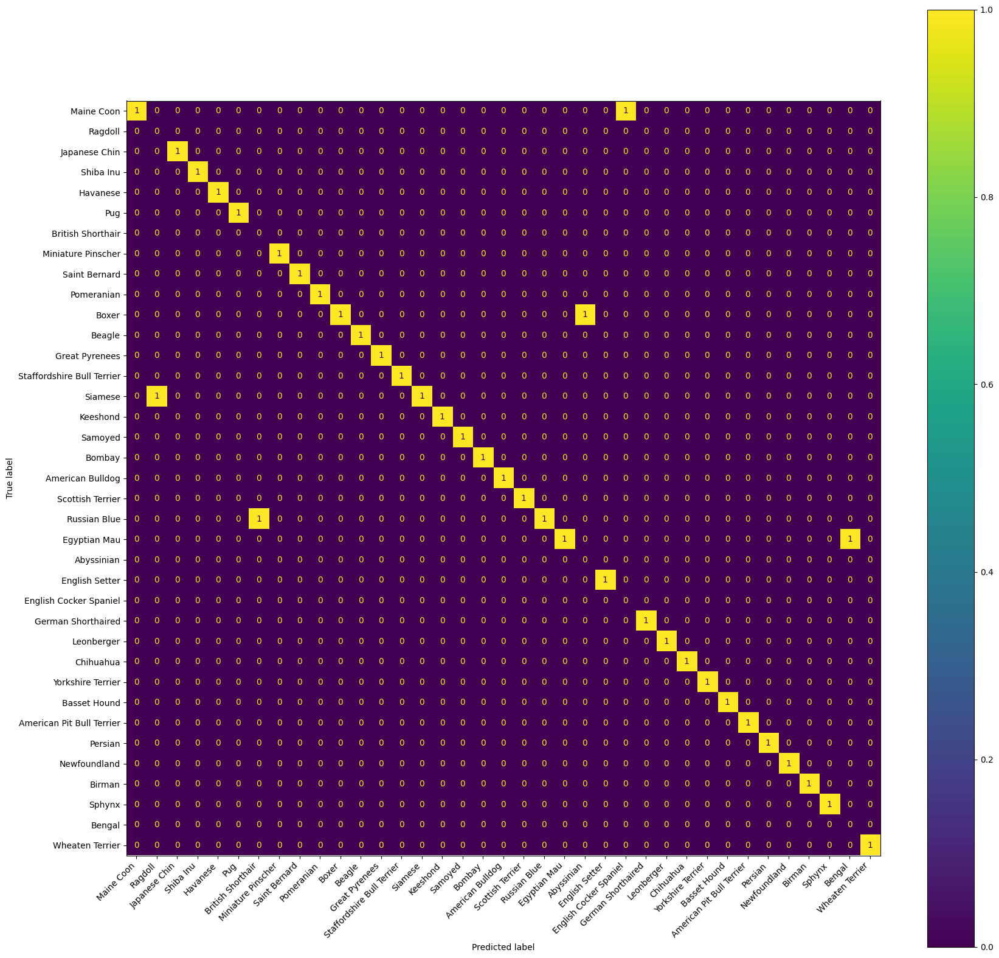

[1,  2075] loss: 0.001
Finished Training
Accuracy on test data: 0.4712254570074475


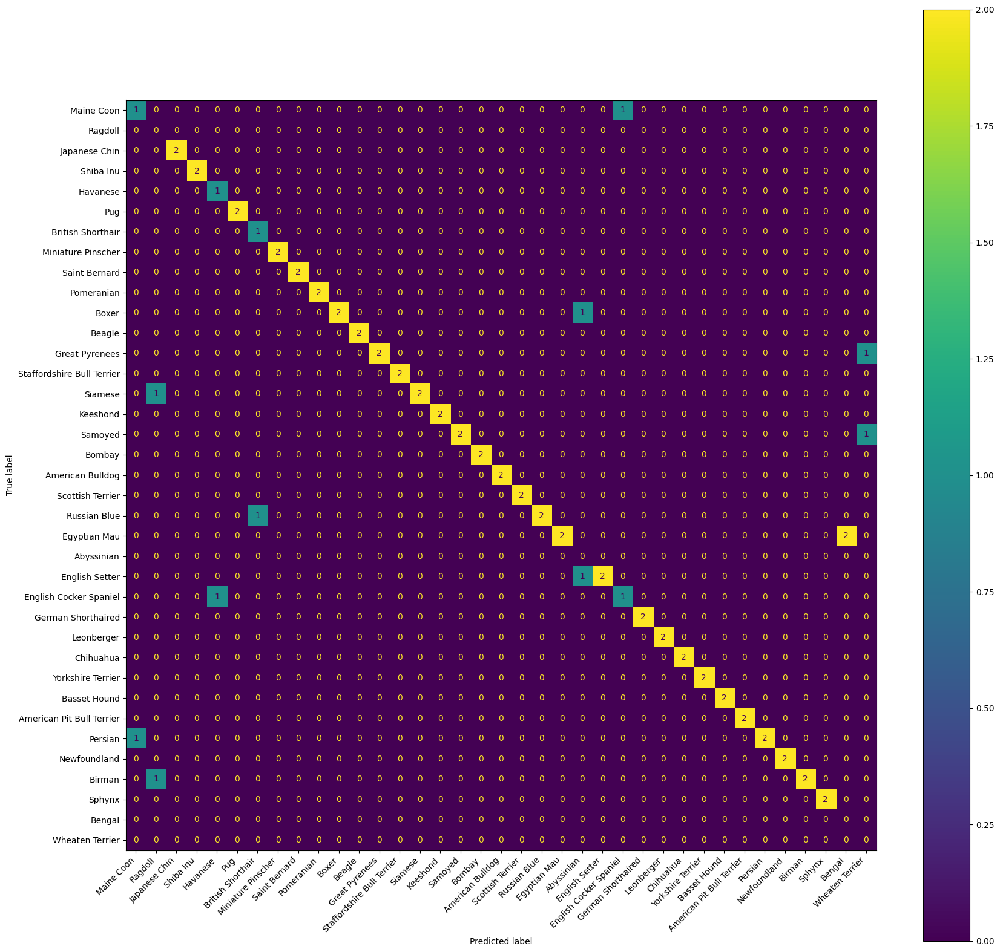

[1,  2125] loss: 0.003
Finished Training
Accuracy on test data: 0.4752877454299255


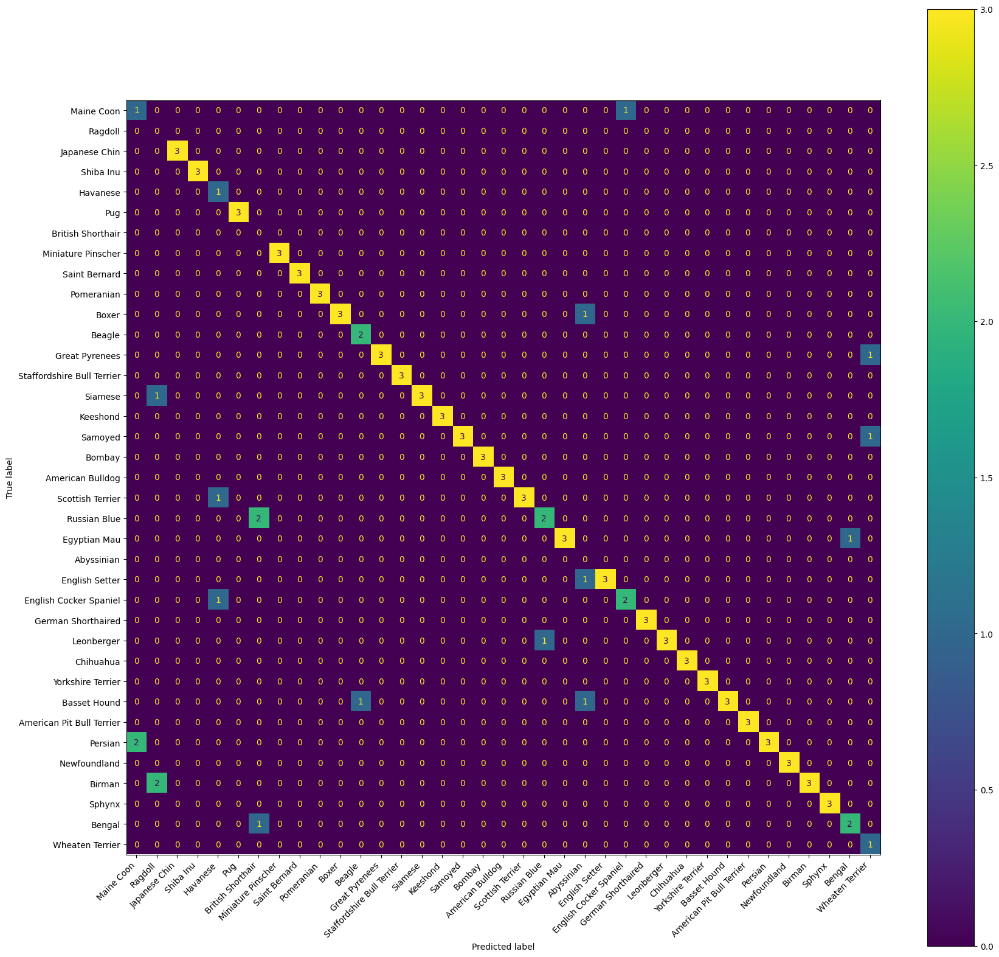

[1,  2150] loss: 0.002
Finished Training
Accuracy on test data: 0.4867975626269465


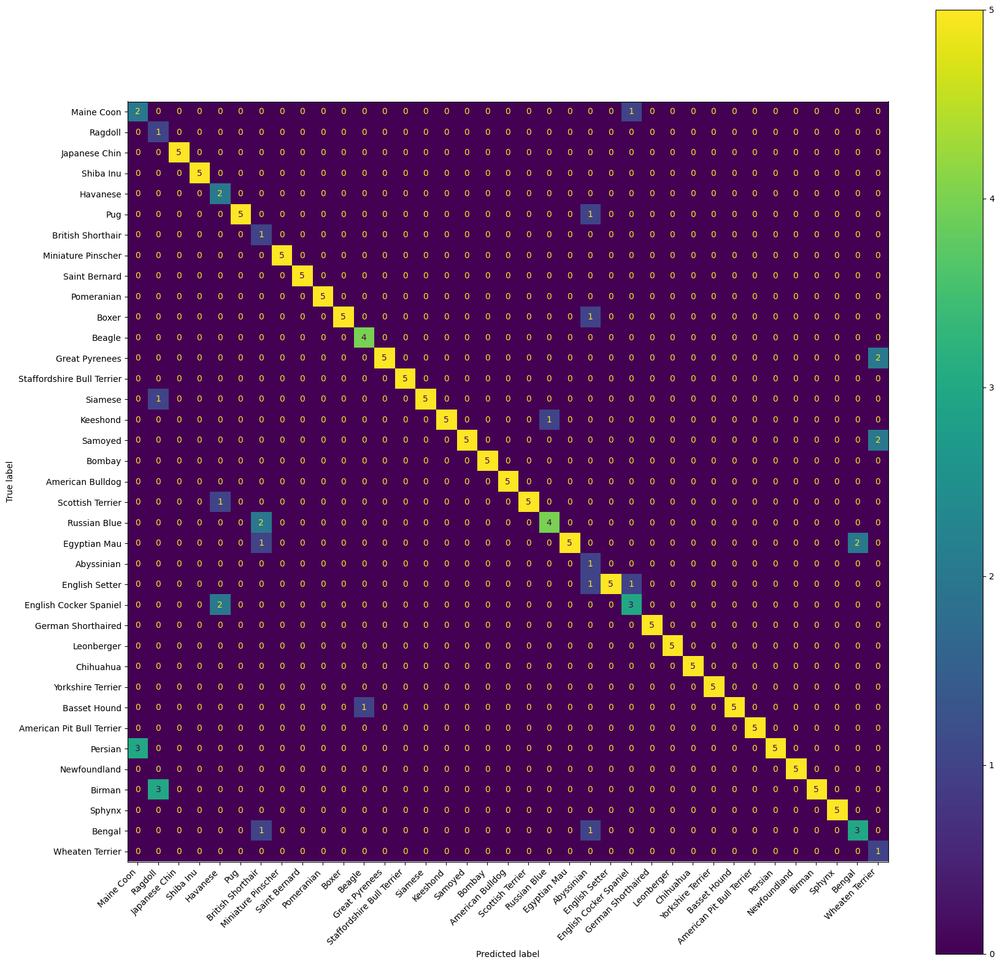

[1,  2225] loss: 0.004
Finished Training
Accuracy on test data: 0.5226811103588355


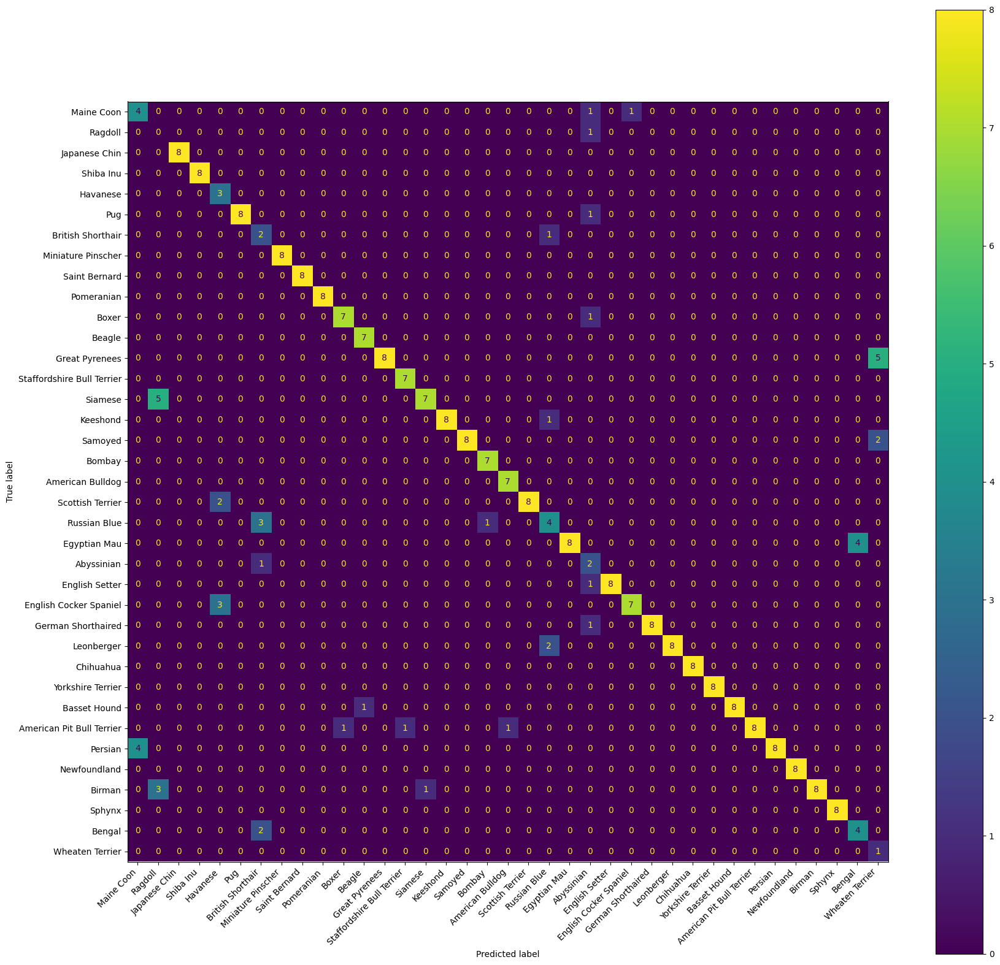

[1,  2350] loss: 0.007
Finished Training
Accuracy on test data: 0.5470548408937035


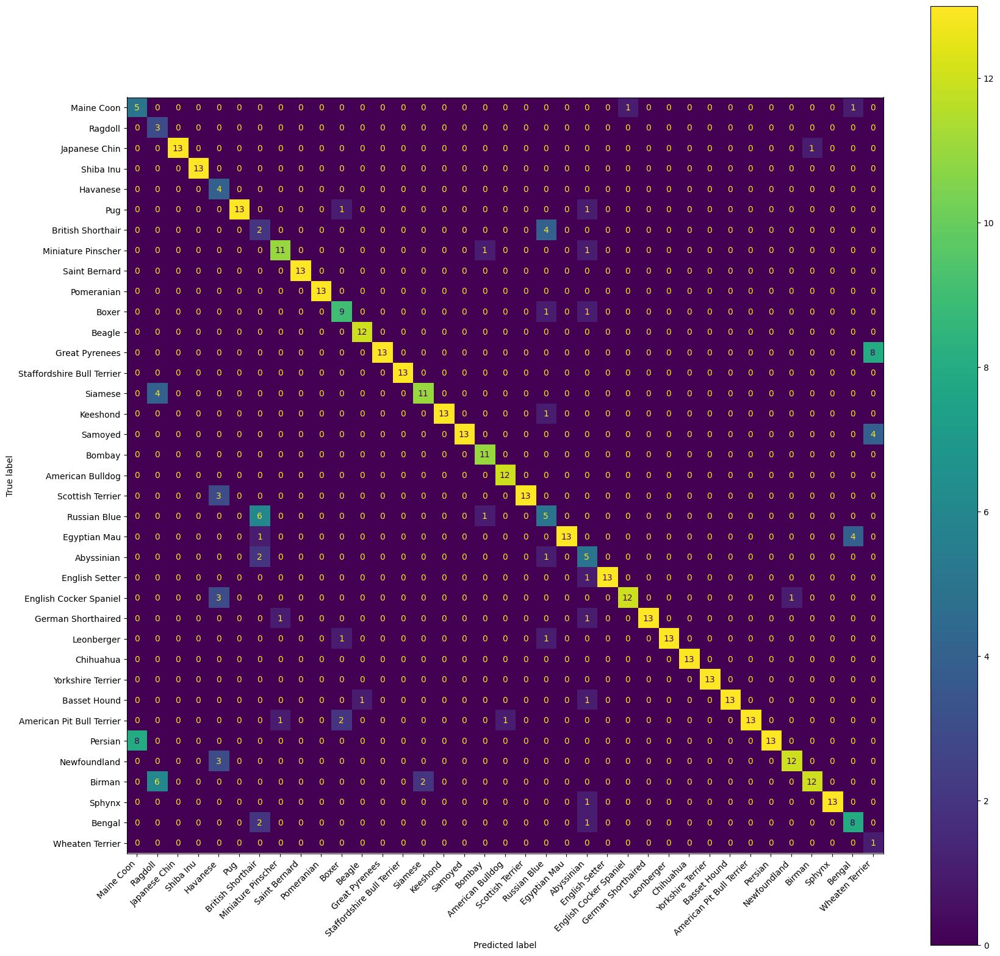

[1,  2525] loss: 0.010
Finished Training
Accuracy on test data: 0.5666892349356805


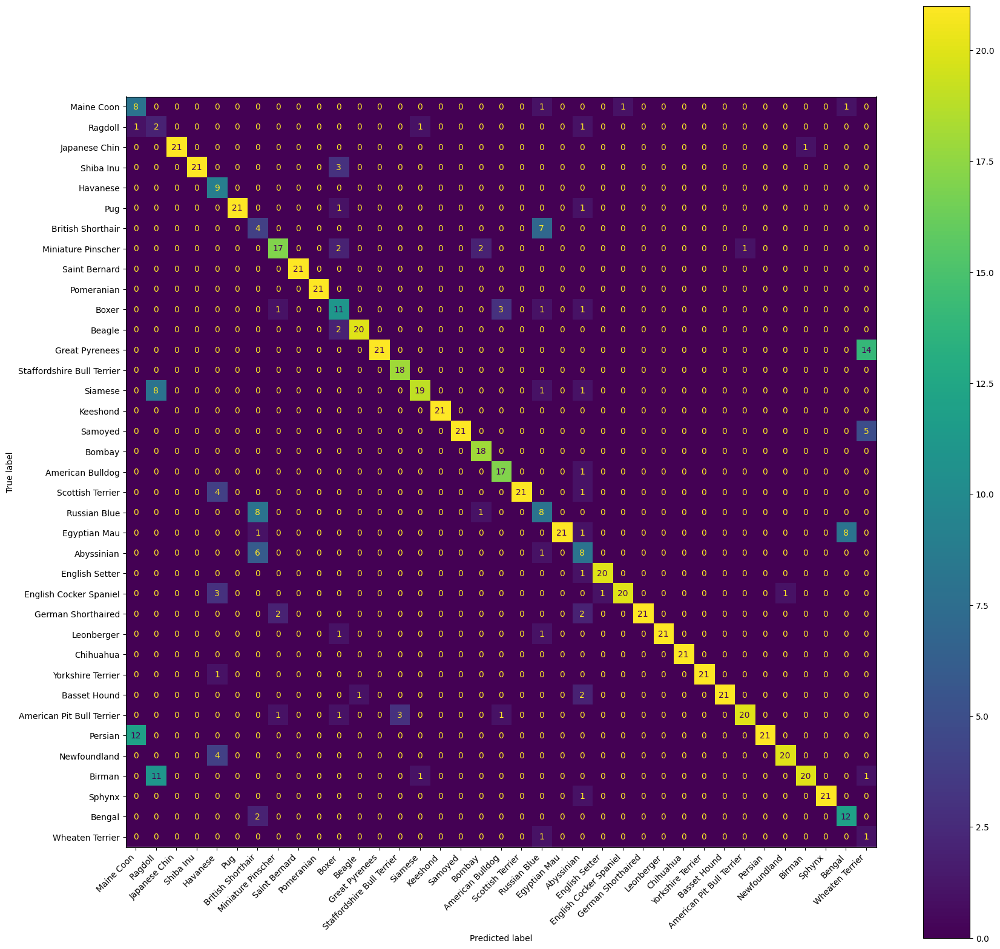

[1,  2825] loss: 0.014
Finished Training
Accuracy on test data: 0.5985104942450914


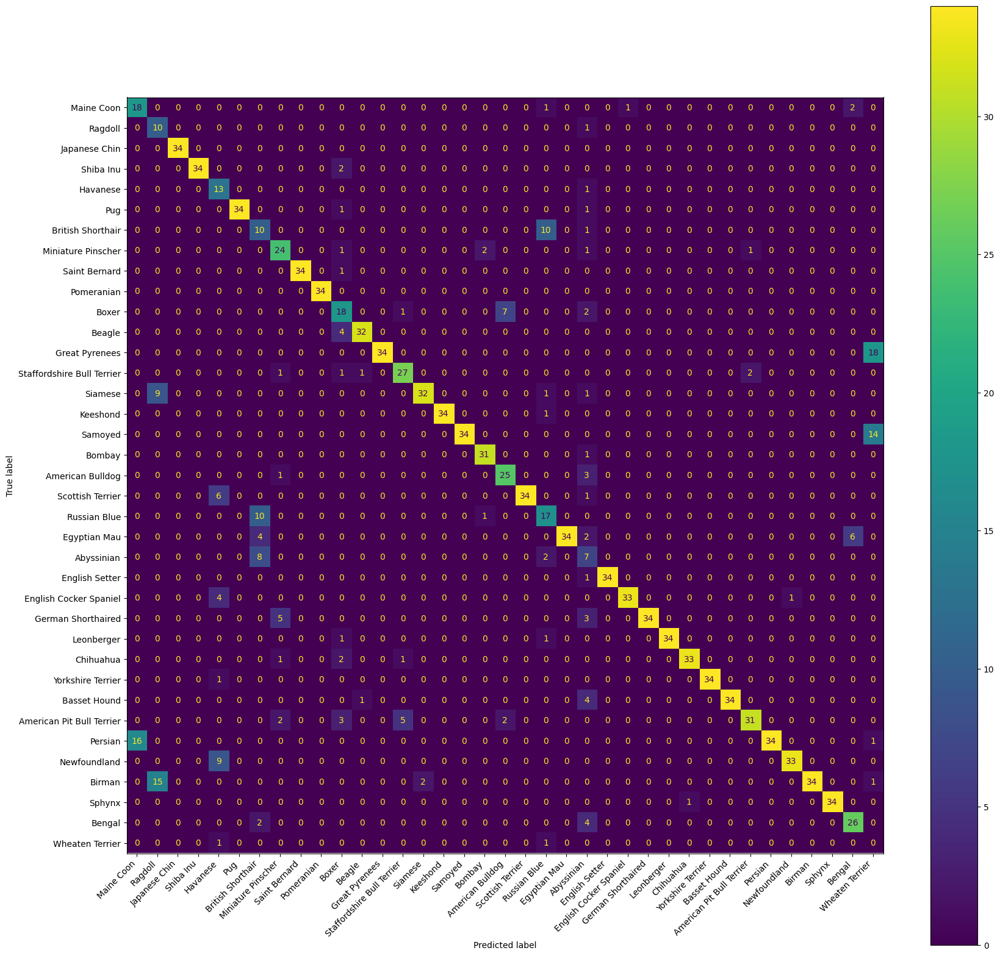

[1,  3300] loss: 0.023
Finished Training
Accuracy on test data: 0.6296547054840894


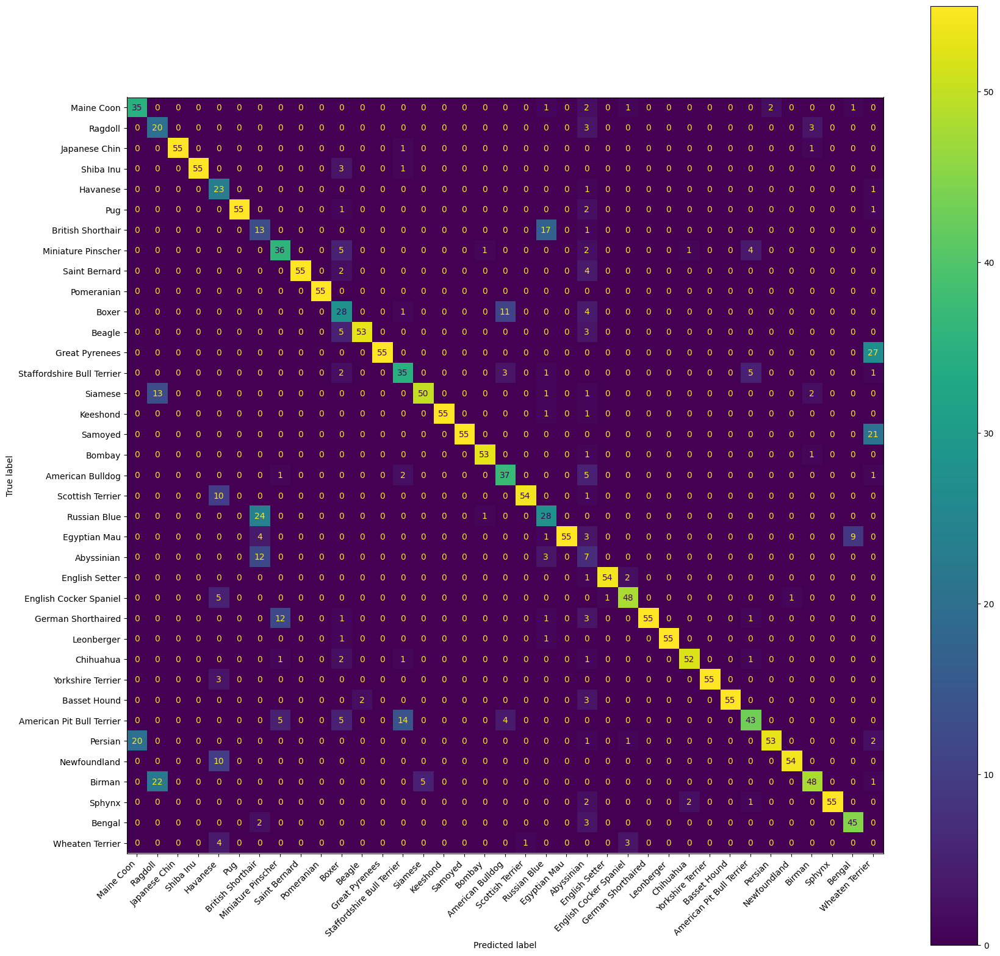

[1,  2000] loss: 0.036
[1,  4075] loss: 0.001
Finished Training
Accuracy on test data: 0.6459038591740014


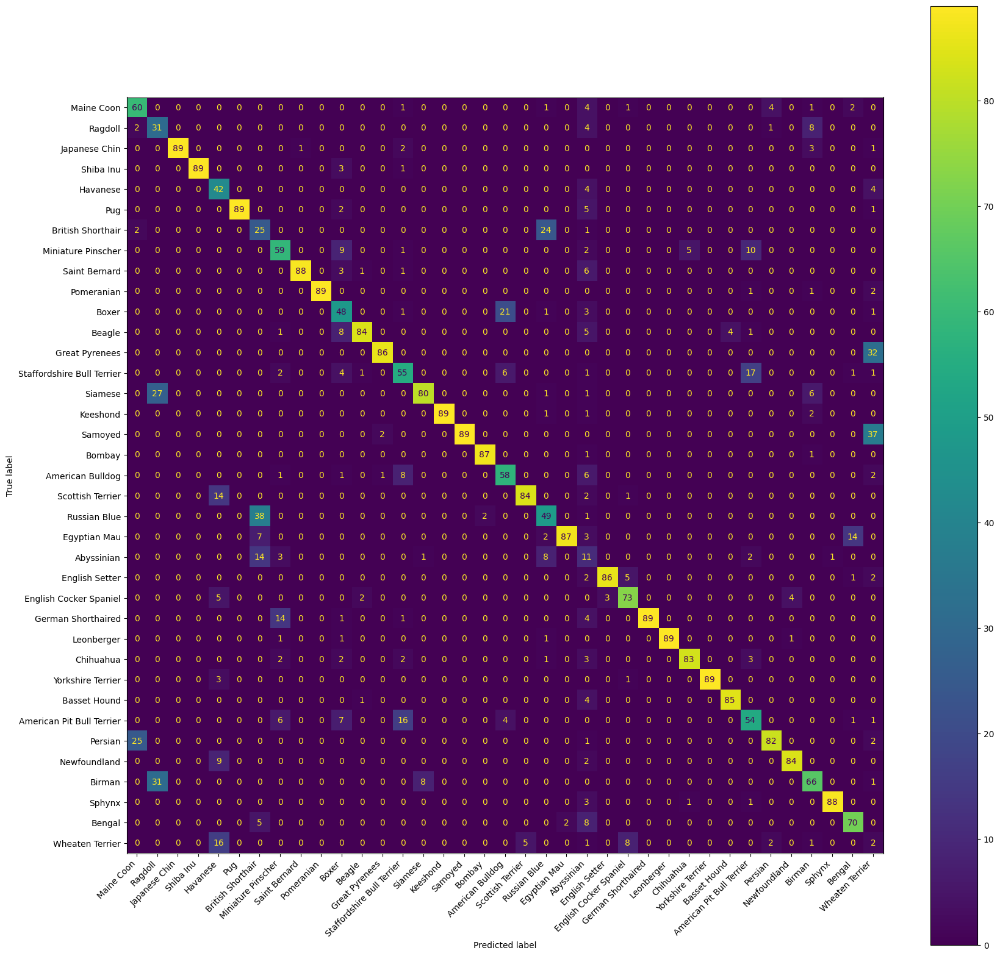

[1,  2000] loss: 0.037
[1,  5350] loss: 0.025
Finished Training
Accuracy on test data: 0.6966824644549763


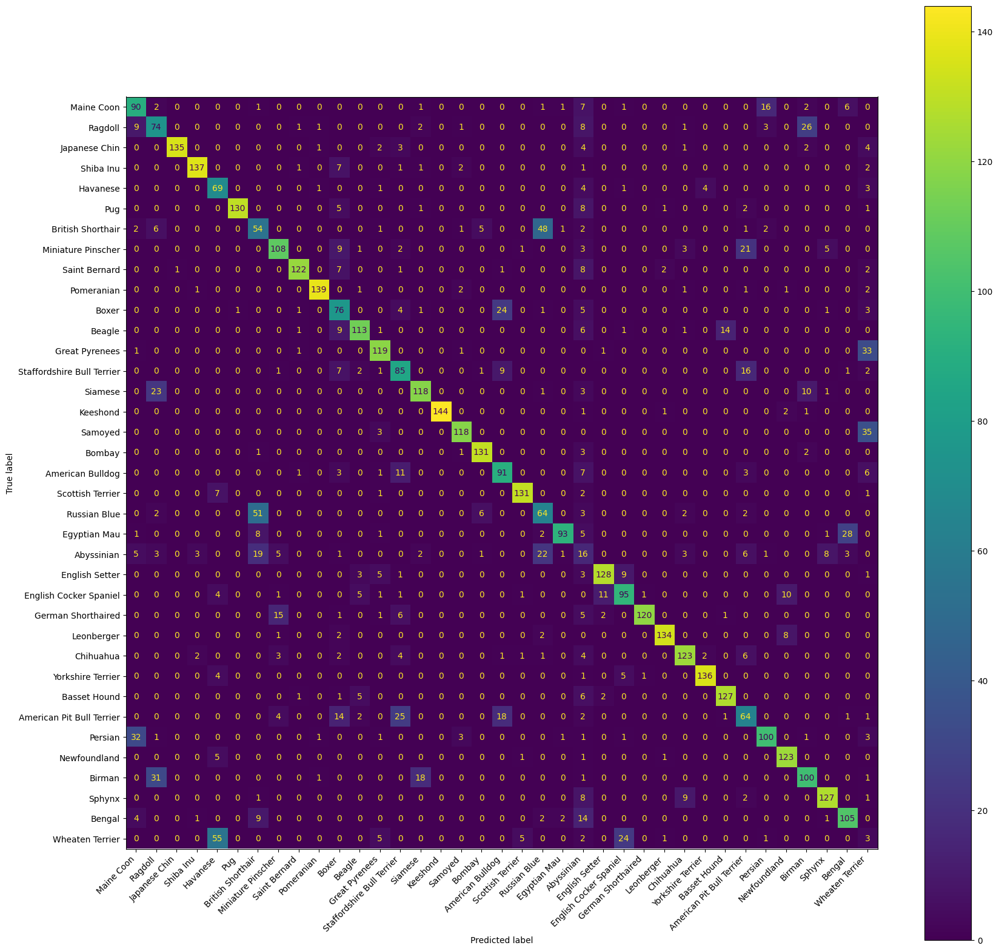

[1,  2000] loss: 0.040
[1,  4000] loss: 0.040
[1,  7150] loss: 0.023
Finished Training
Accuracy on test data: 0.7210561949898443


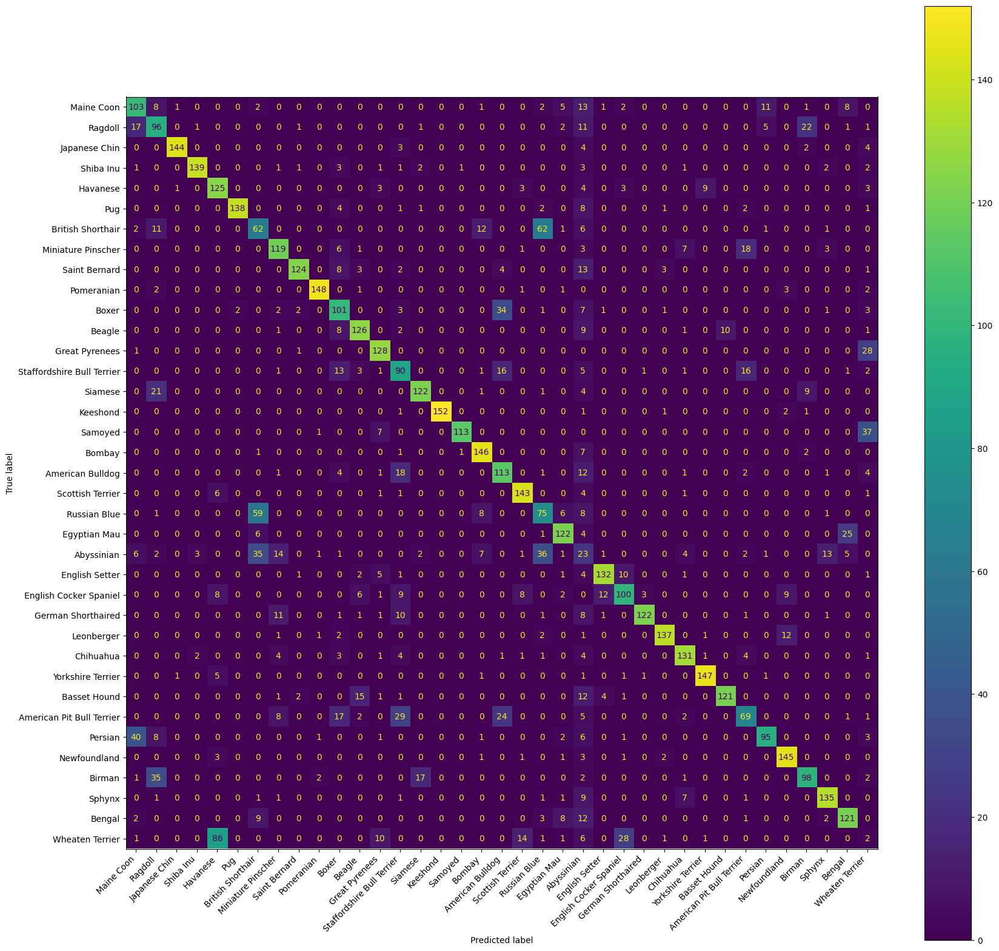

[1,  2000] loss: 0.041
[1,  4000] loss: 0.040
[1,  7875] loss: 0.037
Finished Training
Accuracy on test data: 0.7359512525389302


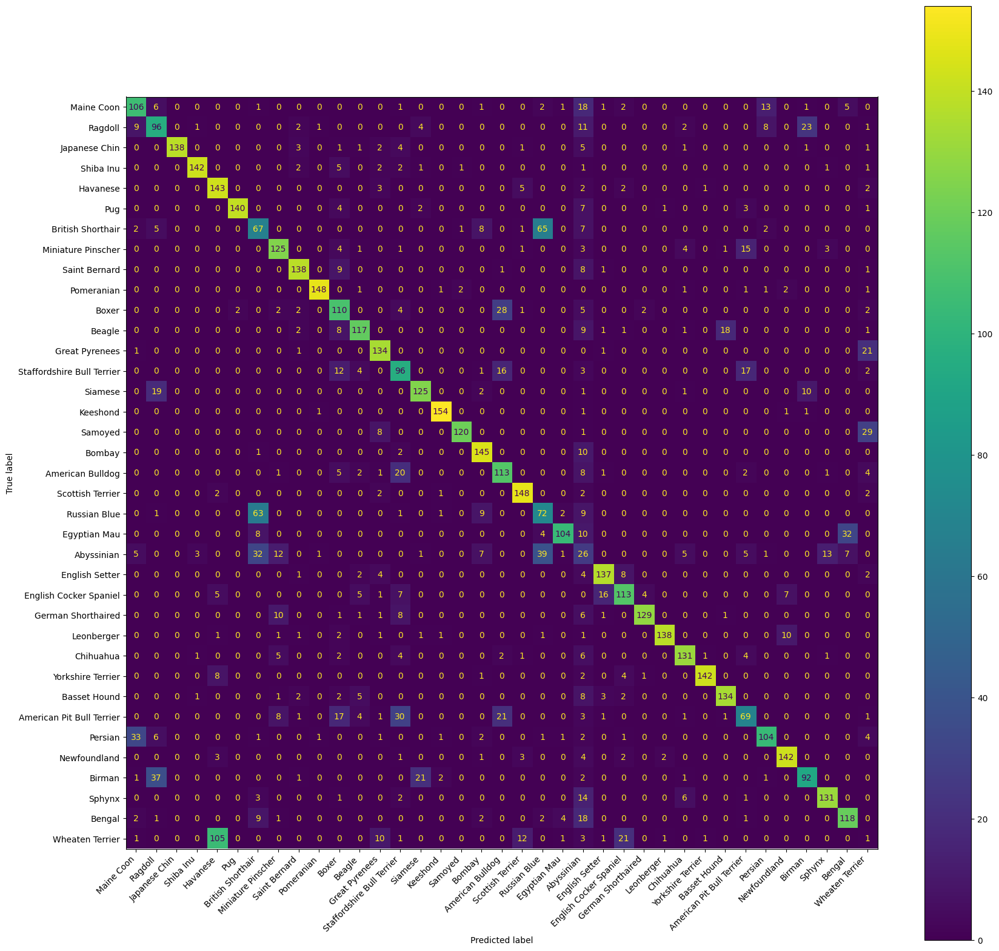

[1,  2000] loss: 0.036
[1,  4000] loss: 0.035
[1,  7875] loss: 0.034
Finished Training
Accuracy on test data: 0.7528774542992552
[1,  2000] loss: 0.032
[1,  4000] loss: 0.034
[1,  7875] loss: 0.031
[2,  2000] loss: 0.032
[2,  4000] loss: 0.031
[2,  7875] loss: 0.029
[3,  2000] loss: 0.029
[3,  4000] loss: 0.029
[3,  7875] loss: 0.027
[4,  2000] loss: 0.028
[4,  4000] loss: 0.028
[4,  7875] loss: 0.027
[5,  2000] loss: 0.025
[5,  4000] loss: 0.026
[5,  7875] loss: 0.024
Finished Training


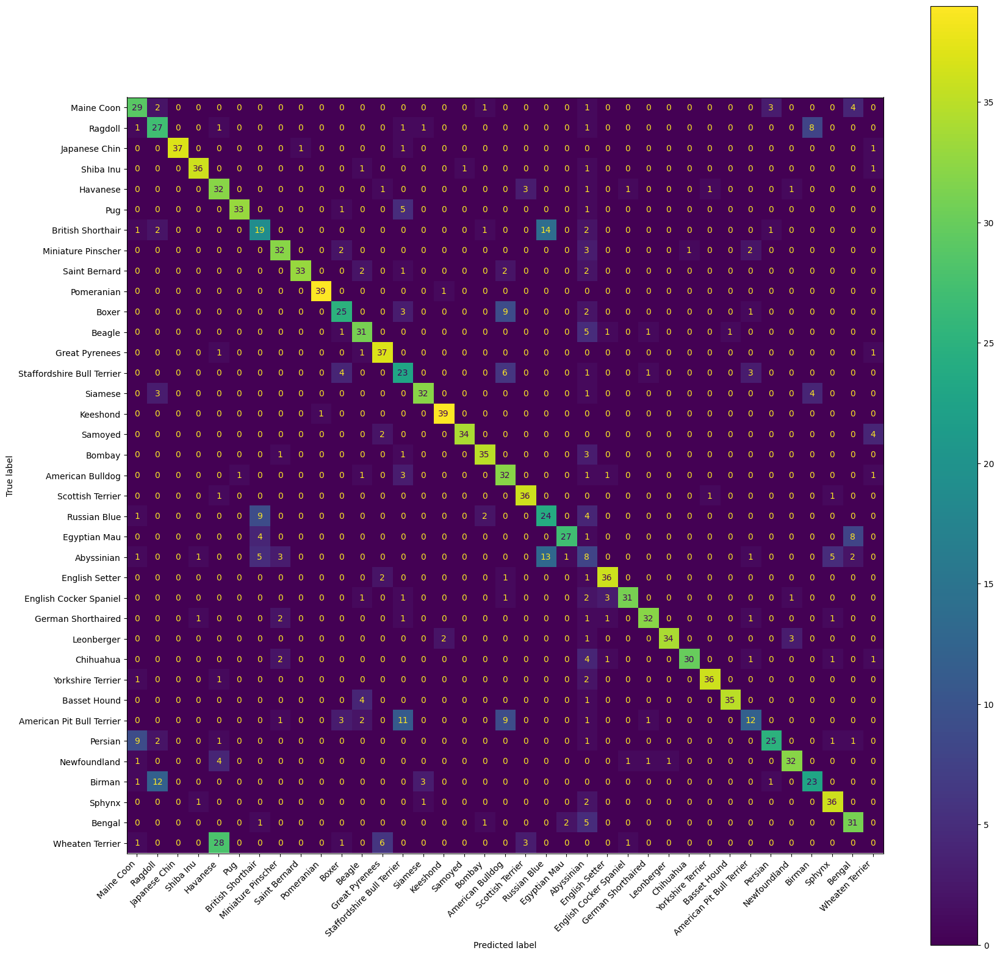

Final accuracy on test data: 0.7400135409614083


In [13]:
main(unlabeled_percentage=0.99, extra_layers=[None], epochs=10, enable_batch_norm=True, prediction_threshold=0.45)

[1,  2100] loss: 0.002
[2,  2100] loss: 0.001
[3,  2100] loss: 0.000
[4,  2100] loss: 0.000
[5,  2100] loss: 0.000
[6,  2100] loss: 0.000
[7,  2100] loss: 0.000
[8,  2100] loss: 0.000
[9,  2100] loss: 0.000
[10,  2100] loss: 0.000
[11,  2100] loss: 0.000
[12,  2100] loss: 0.000
[13,  2100] loss: 0.000
[14,  2100] loss: 0.000
[15,  2100] loss: 0.000
Finished Training
Accuracy on test data: 0.44211238997968855


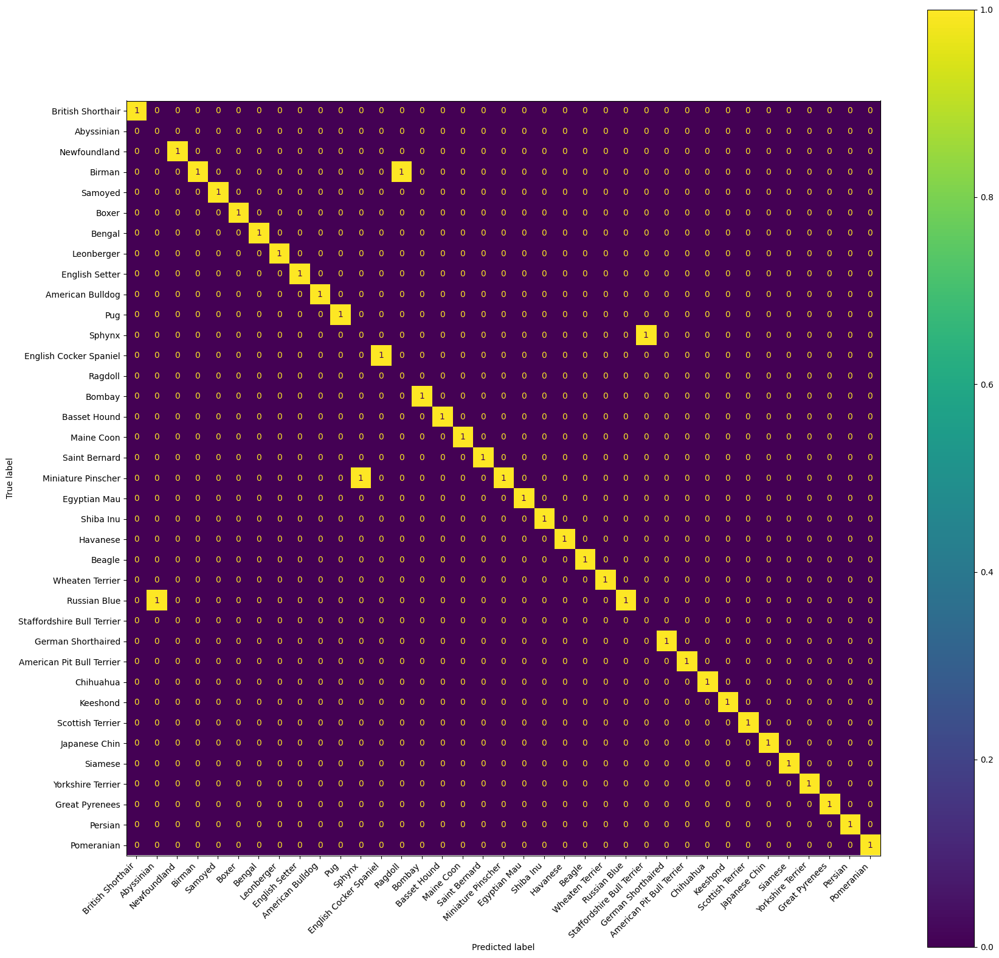

[1,  2075] loss: 0.001
Finished Training
Accuracy on test data: 0.4888287068381855


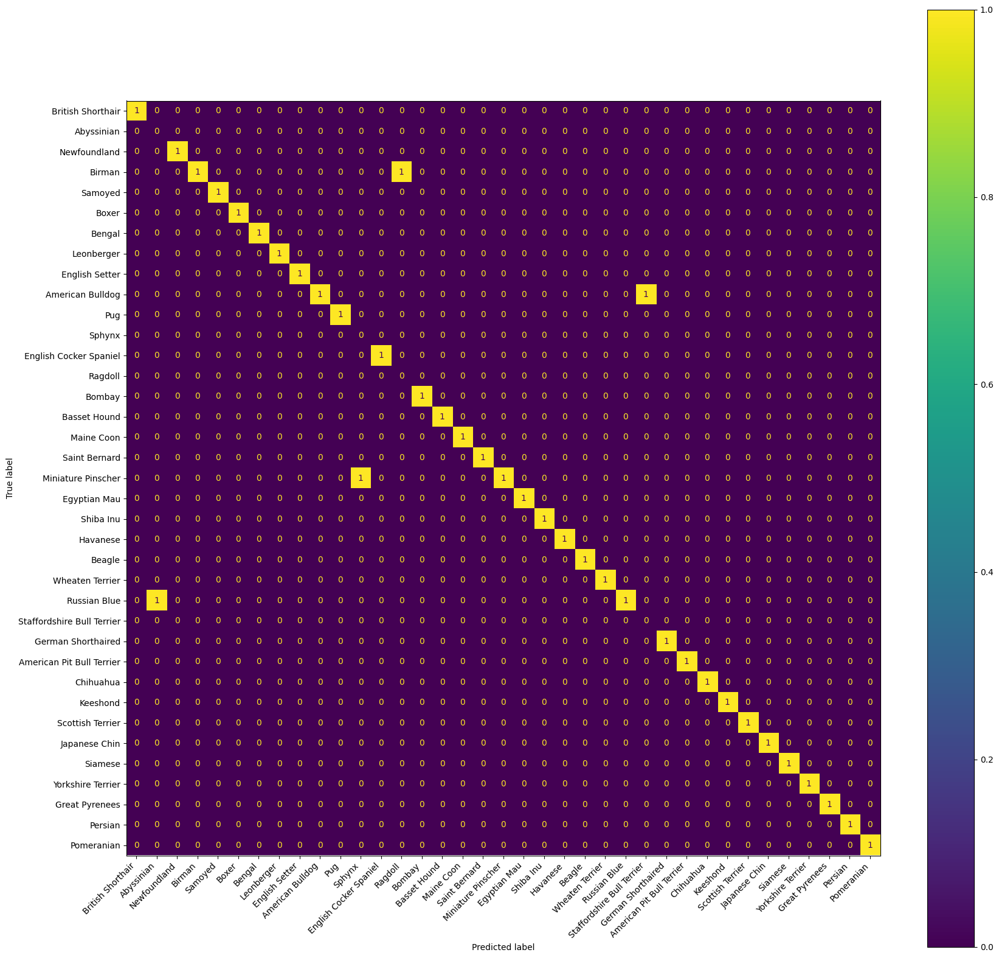

[1,  2075] loss: 0.001
Finished Training
Accuracy on test data: 0.4983073798239675


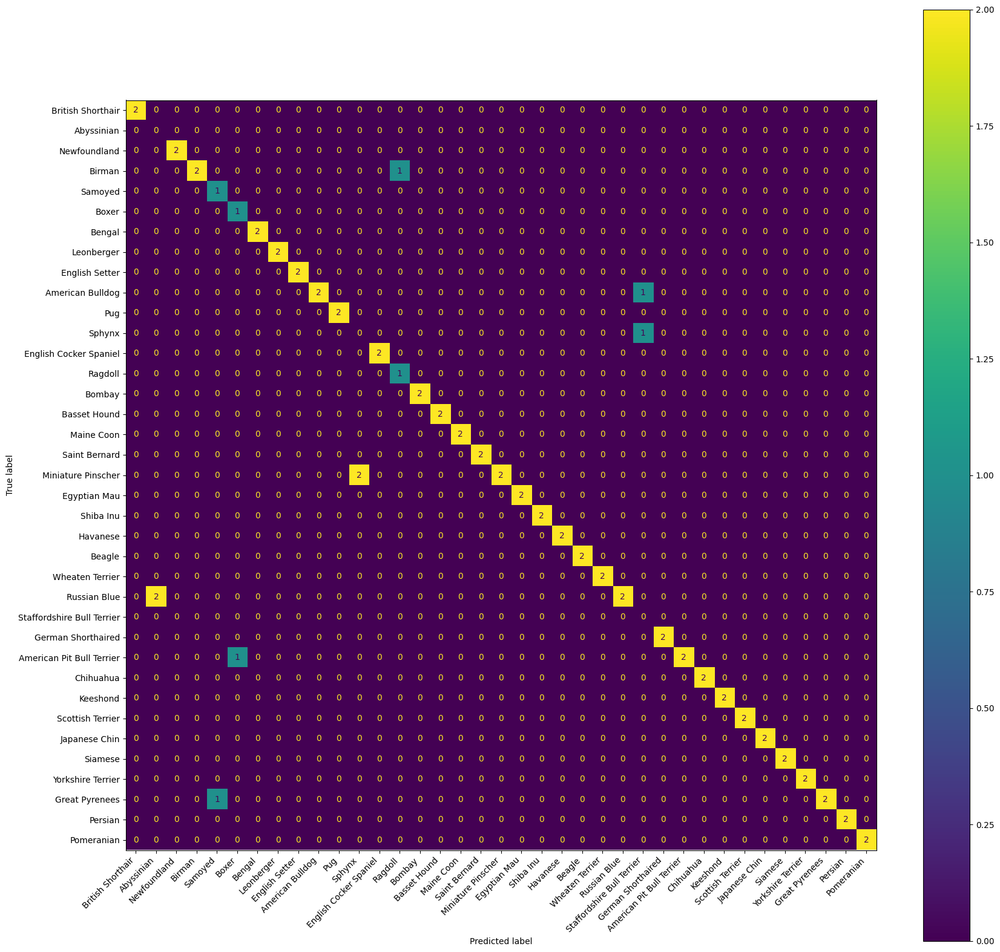

[1,  2125] loss: 0.002
Finished Training
Accuracy on test data: 0.5030467163168585


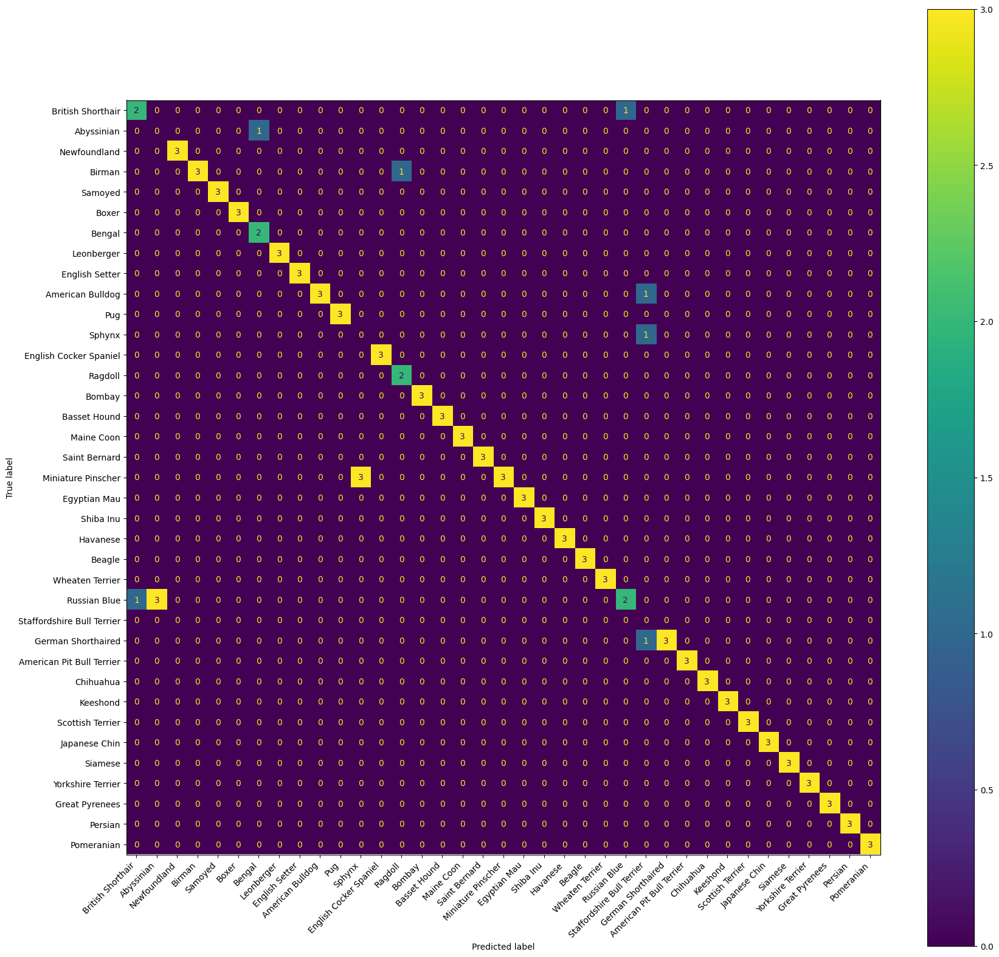

[1,  2150] loss: 0.002
Finished Training
Accuracy on test data: 0.5233581584292485


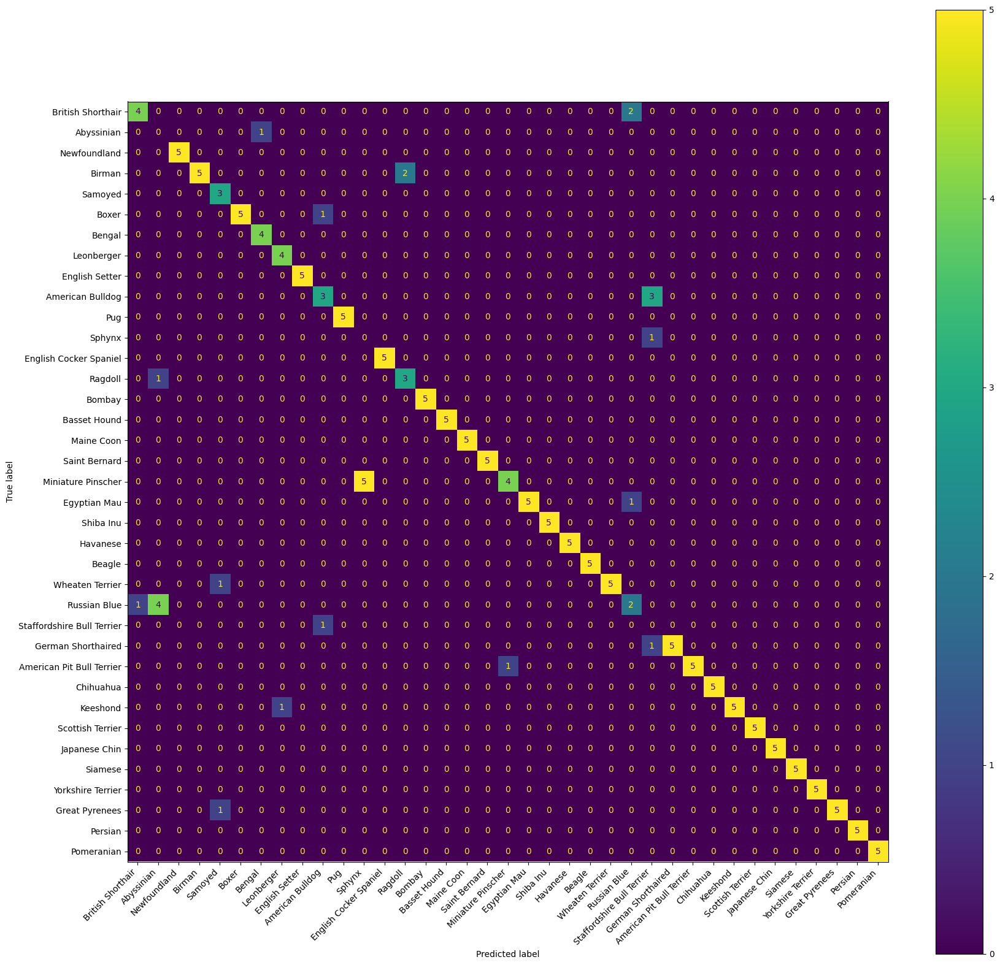

[1,  2225] loss: 0.004
Finished Training
Accuracy on test data: 0.5240352064996615


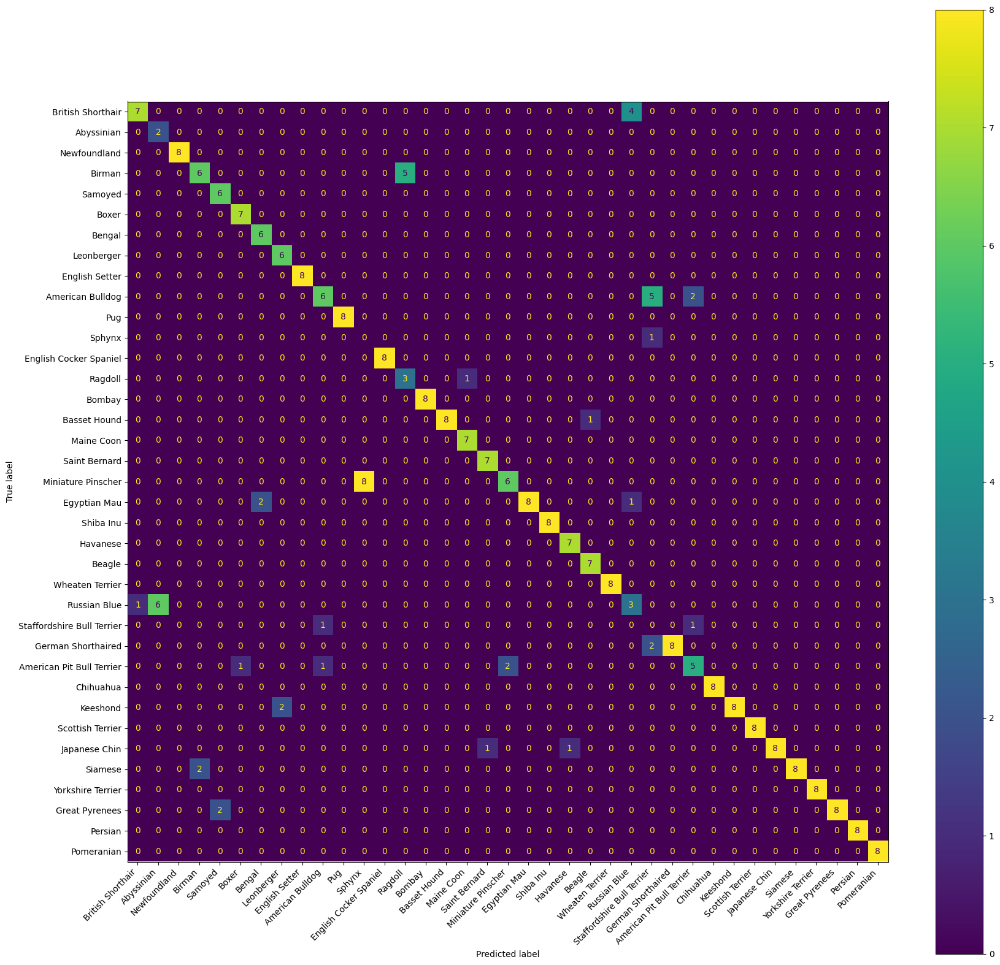

[1,  2350] loss: 0.006
Finished Training
Accuracy on test data: 0.5341909275558565


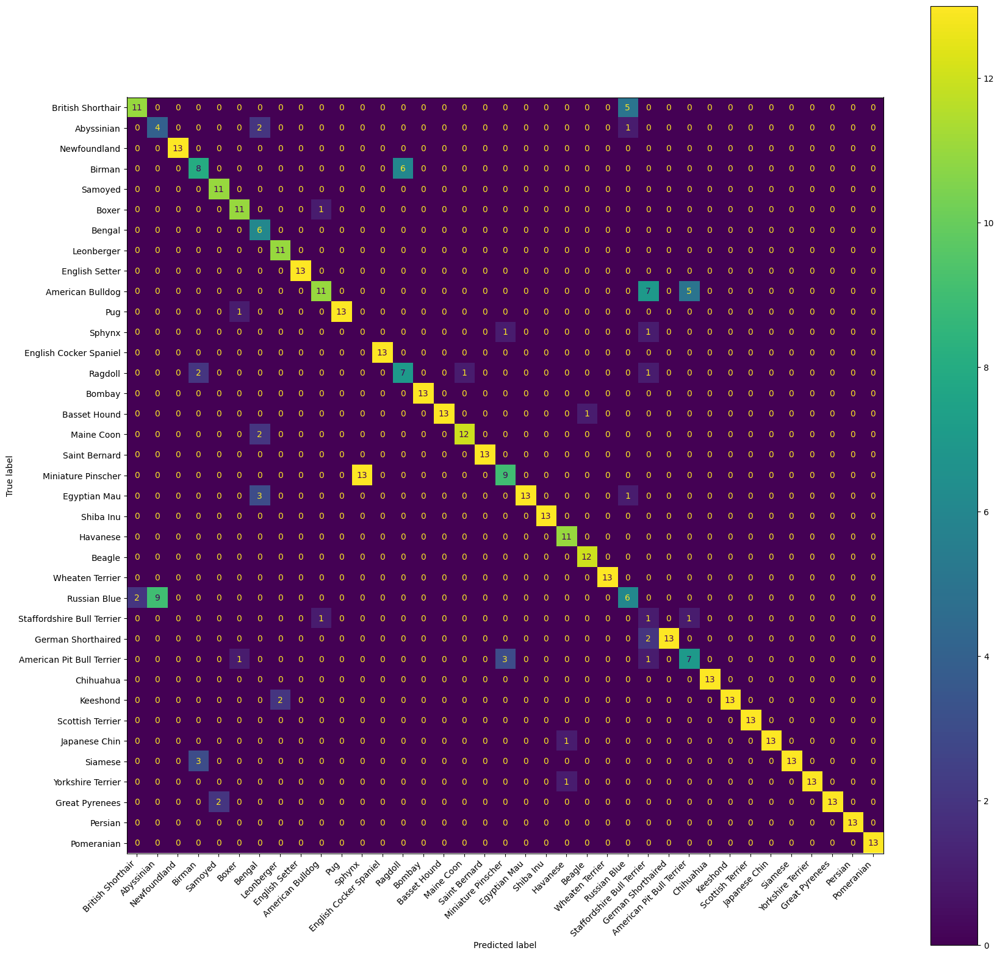

[1,  2525] loss: 0.009
Finished Training
Accuracy on test data: 0.5822613405551794


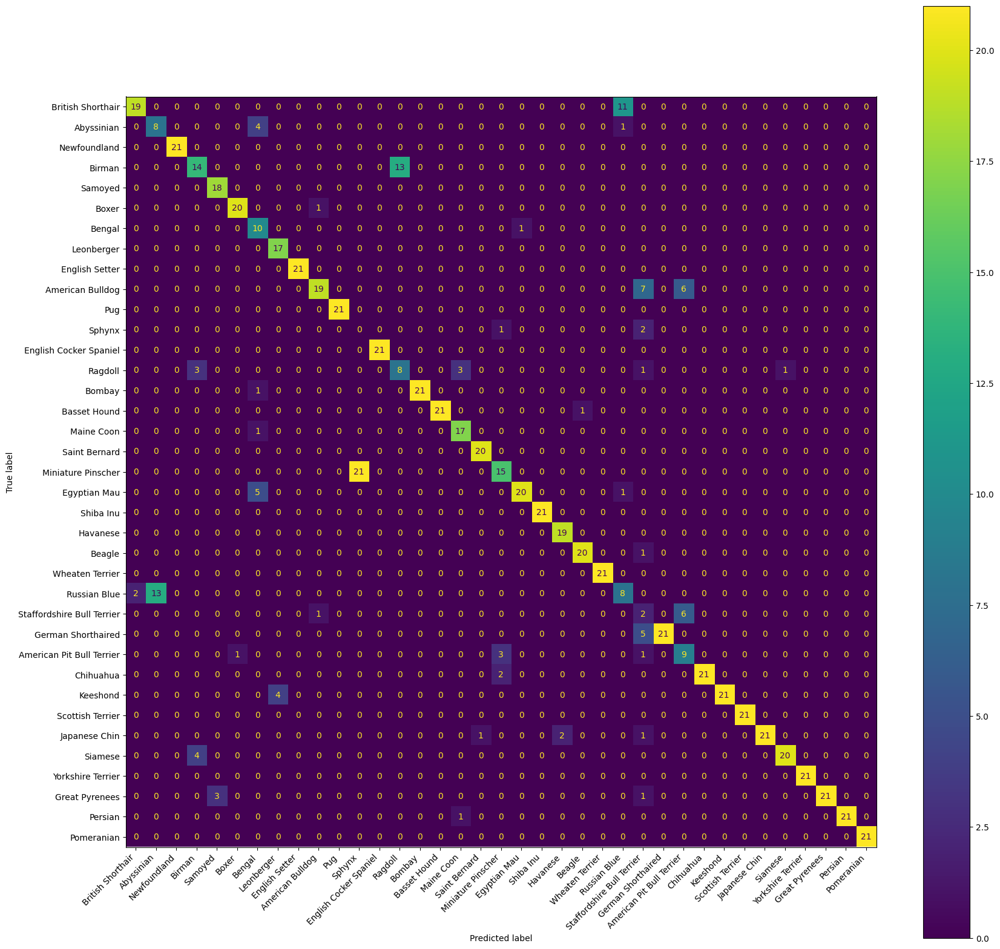

[1,  2825] loss: 0.014
Finished Training
Accuracy on test data: 0.5754908598510494


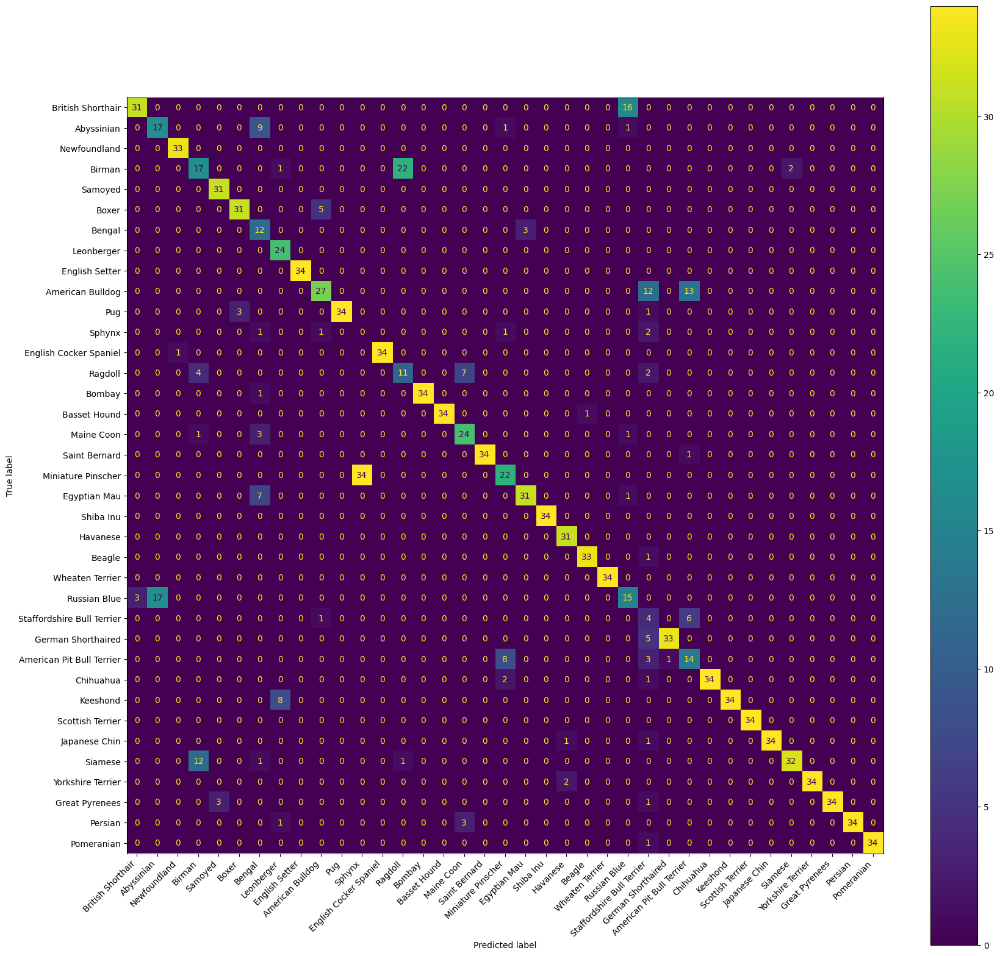

[1,  3300] loss: 0.021
Finished Training
Accuracy on test data: 0.6113744075829384


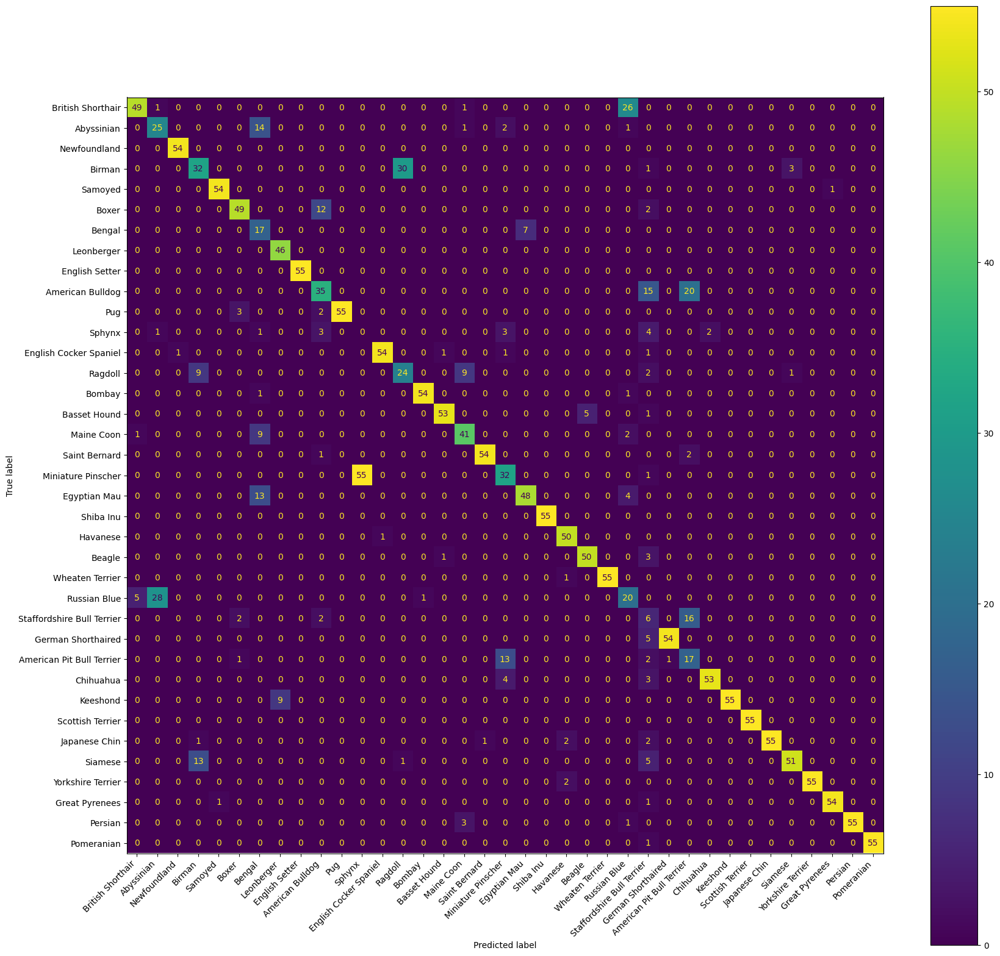

[1,  2000] loss: 0.033
[1,  4075] loss: 0.001
Finished Training
Accuracy on test data: 0.6337169939065673


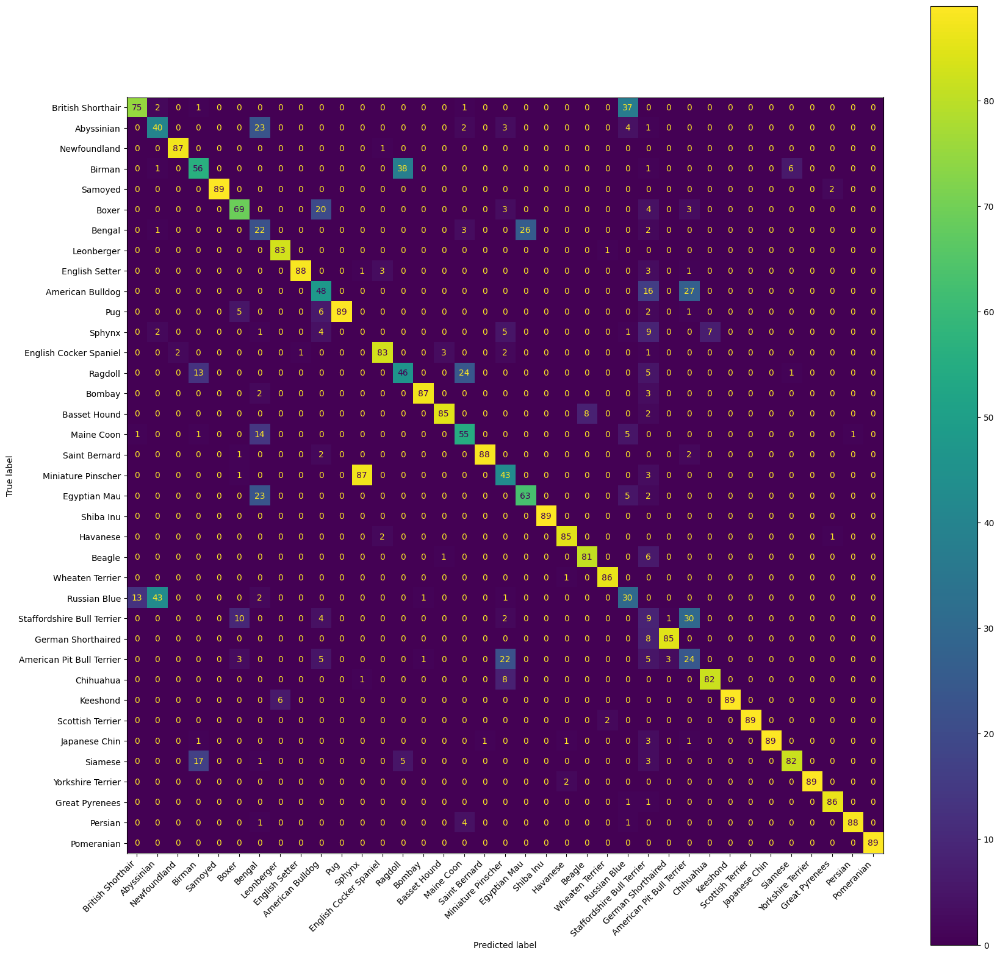

[1,  2000] loss: 0.034
[1,  5325] loss: 0.023
Finished Training
Accuracy on test data: 0.6574136763710223


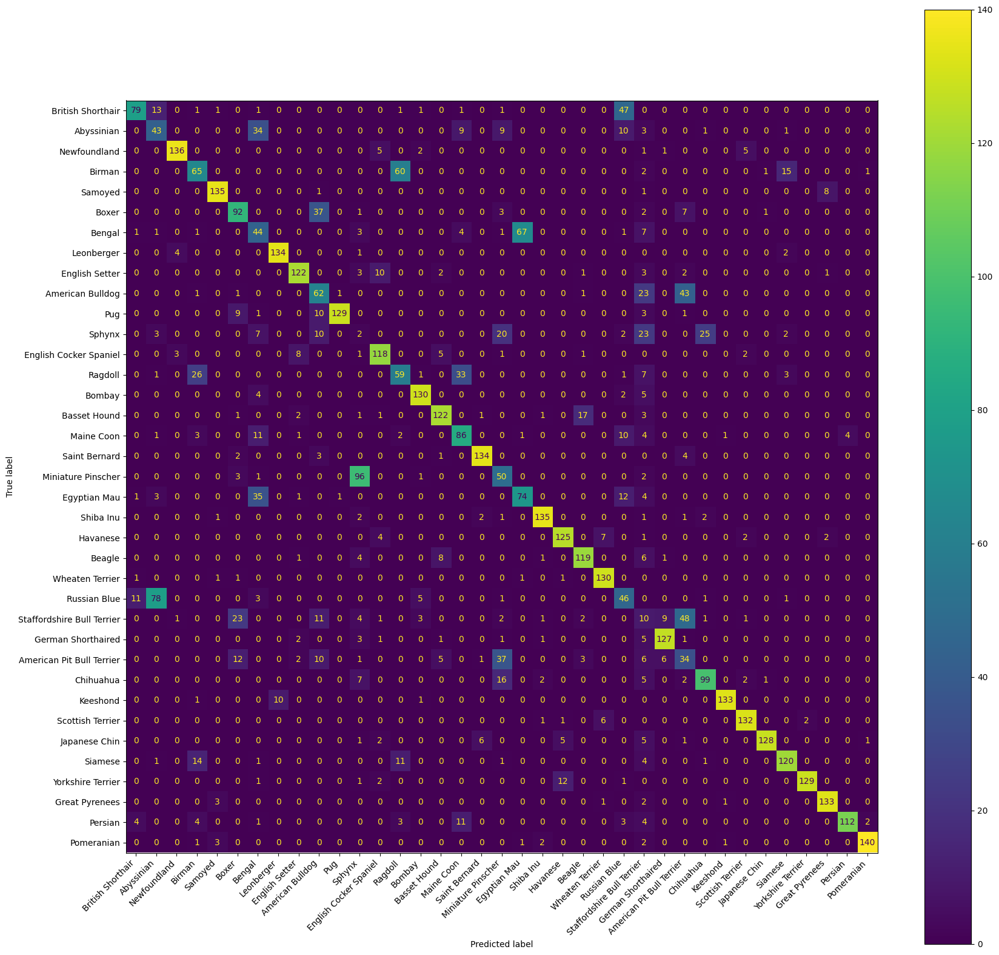

[1,  2000] loss: 0.039
[1,  4000] loss: 0.040
[1,  7175] loss: 0.023
Finished Training
Accuracy on test data: 0.6641841570751523


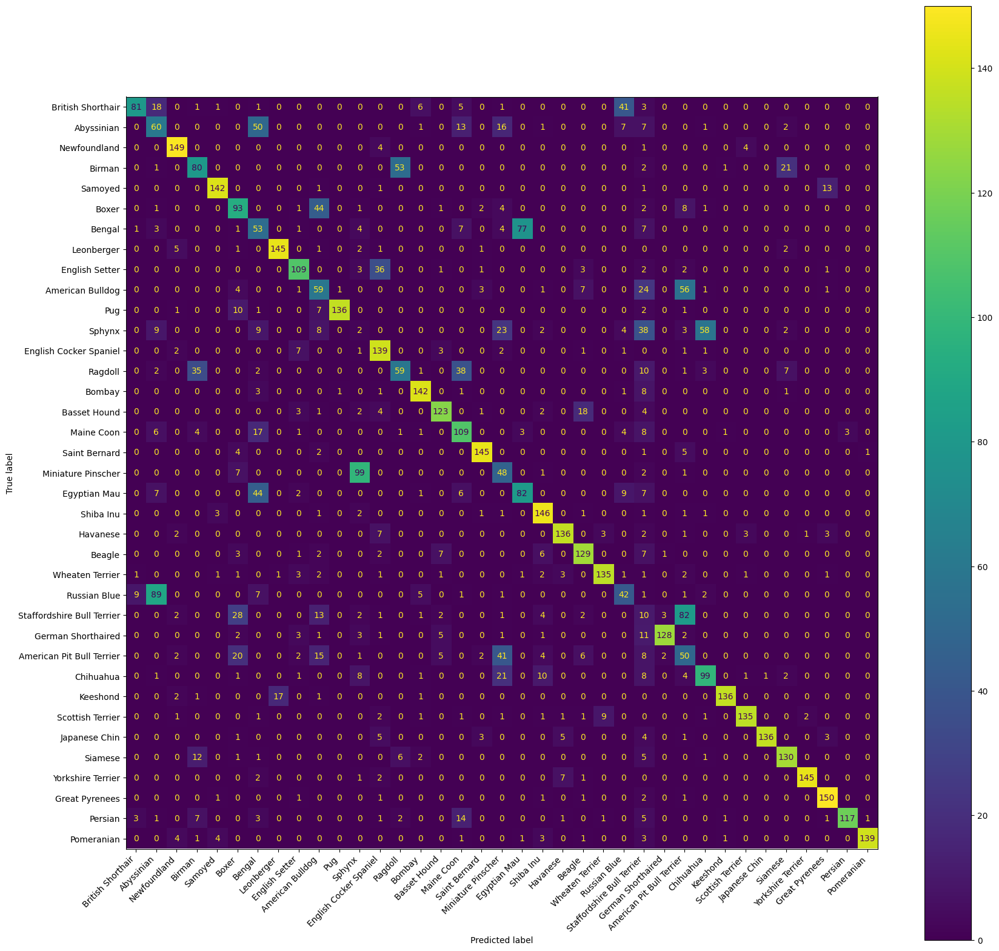

[1,  2000] loss: 0.040
[1,  4000] loss: 0.039
[1,  7875] loss: 0.037
Finished Training
Accuracy on test data: 0.6668923493568043
[1,  2000] loss: 0.036
[1,  4000] loss: 0.035
[1,  7875] loss: 0.033
[2,  2000] loss: 0.033
[2,  4000] loss: 0.034
[2,  7875] loss: 0.032
[3,  2000] loss: 0.031
[3,  4000] loss: 0.031
[3,  7875] loss: 0.030
[4,  2000] loss: 0.029
[4,  4000] loss: 0.029
[4,  7875] loss: 0.029
[5,  2000] loss: 0.028
[5,  4000] loss: 0.028
[5,  7875] loss: 0.027
Finished Training


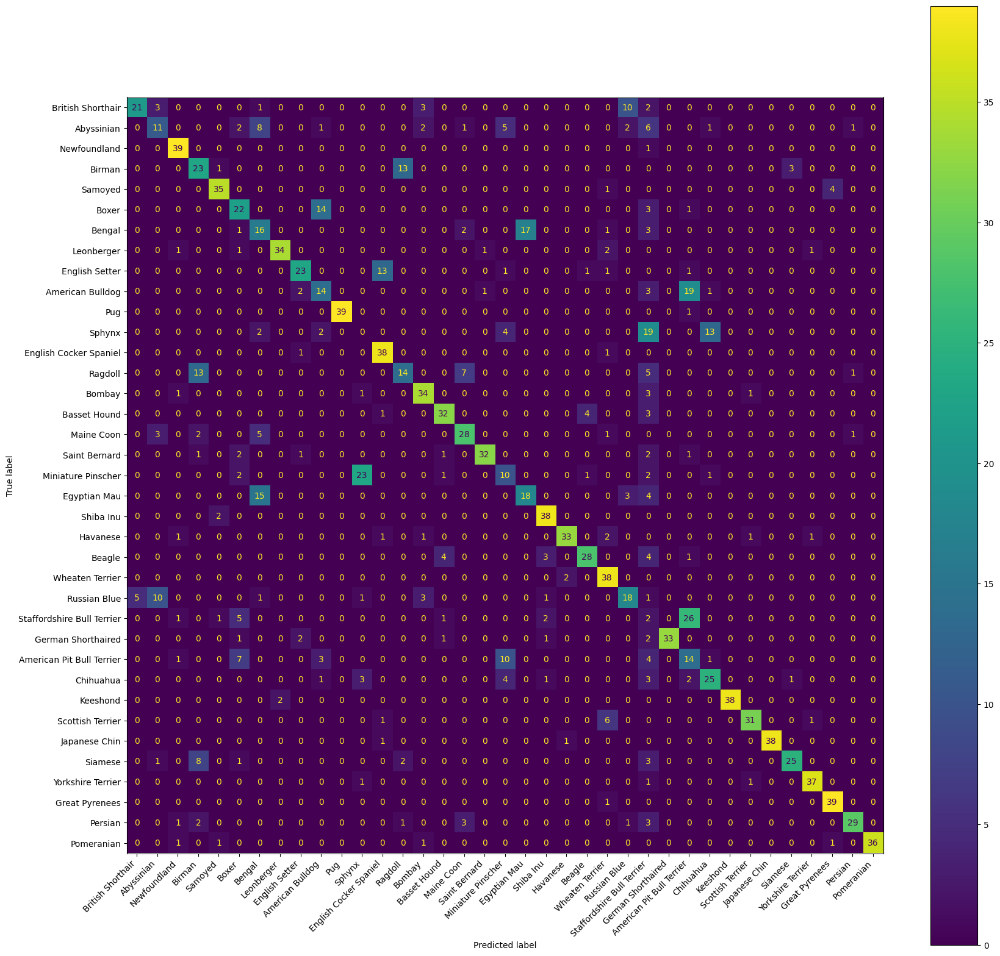

Final accuracy on test data: 0.6668923493568043


In [13]:
main(unlabeled_percentage=0.99, extra_layers=[None, None], epochs=10, enable_batch_norm=True, prediction_threshold=0.45)

[1,  2600] loss: 0.008
[2,  2600] loss: 0.004
[3,  2600] loss: 0.003
[4,  2600] loss: 0.002
[5,  2600] loss: 0.002
[6,  2600] loss: 0.002
[7,  2600] loss: 0.002
[8,  2600] loss: 0.001
[9,  2600] loss: 0.001
[10,  2600] loss: 0.001
[11,  2600] loss: 0.001
[12,  2600] loss: 0.001
[13,  2600] loss: 0.001
[14,  2600] loss: 0.001
[15,  2600] loss: 0.001
Finished Training
Accuracy on test data: 0.7921462423832092


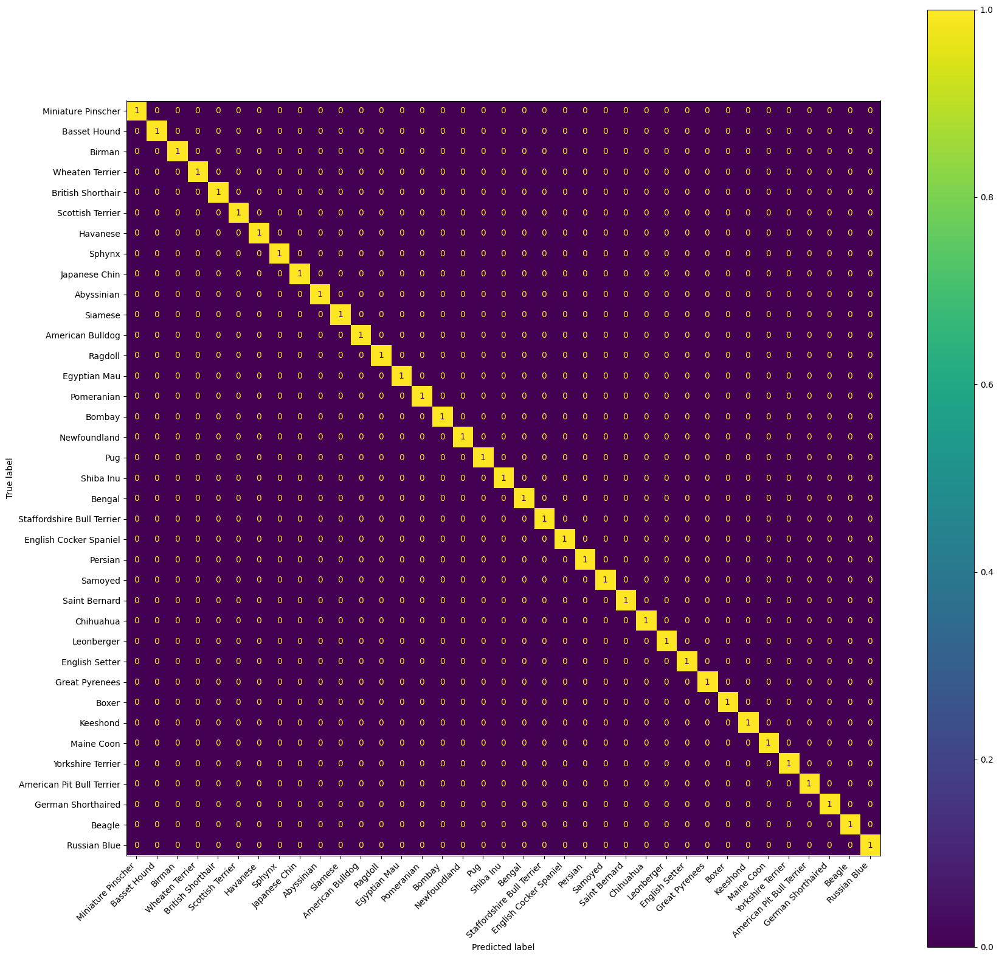

[1,  2600] loss: 0.010
Finished Training
Accuracy on test data: 0.7698036560595802


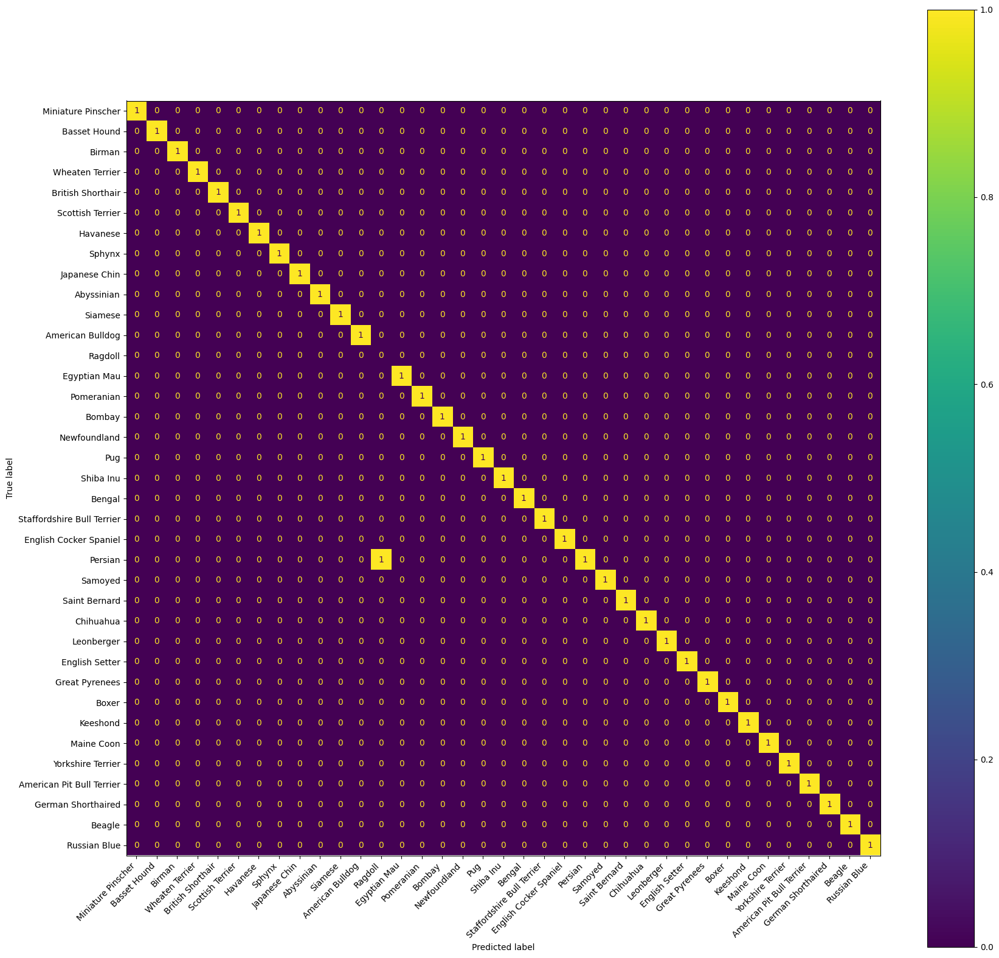

[1,  2600] loss: 0.010
Finished Training
Accuracy on test data: 0.7860528097494922


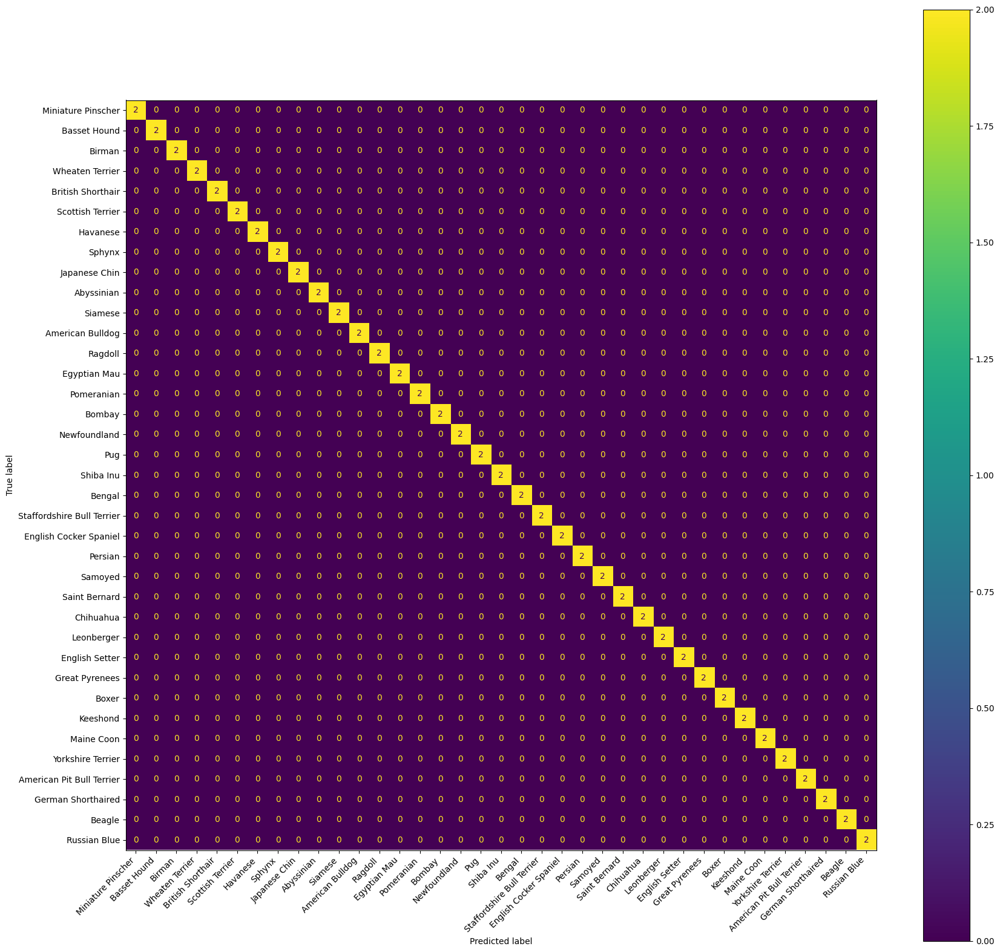

[1,  2650] loss: 0.011
Finished Training
Accuracy on test data: 0.7853757616790792


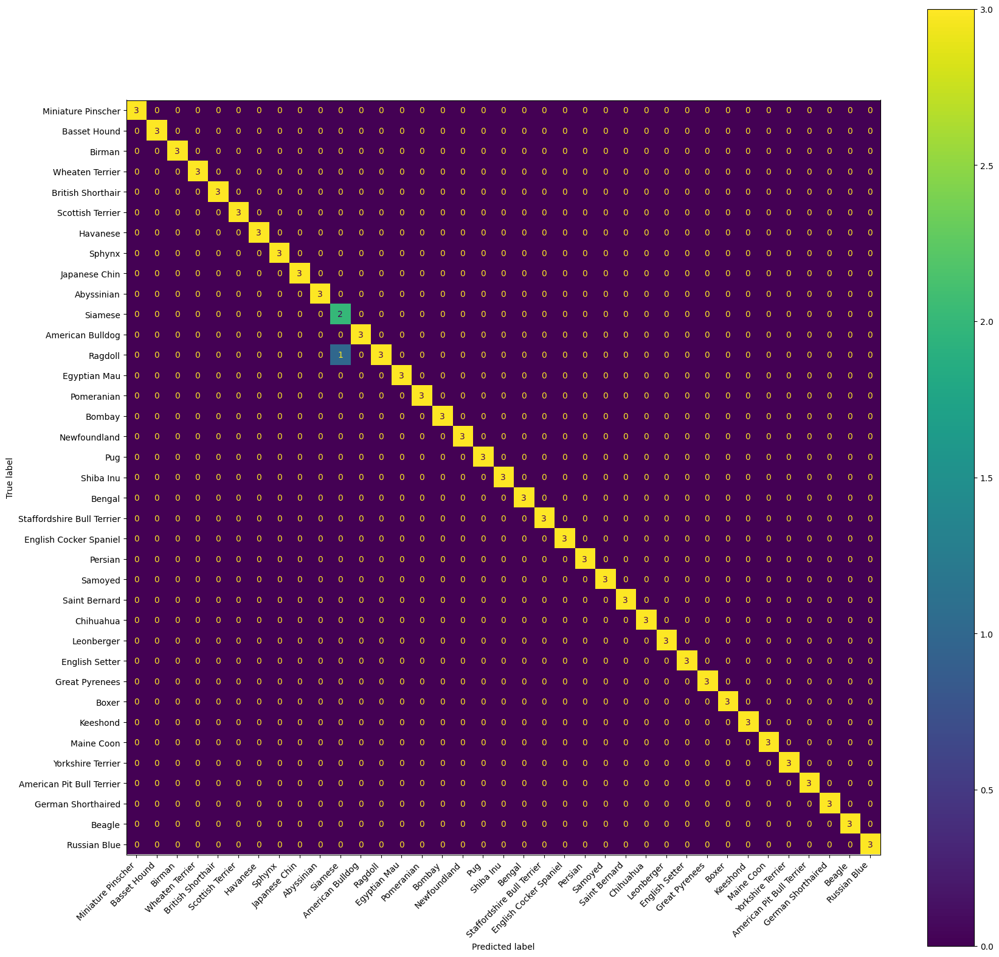

[1,  2675] loss: 0.010
Finished Training
Accuracy on test data: 0.7758970886932972


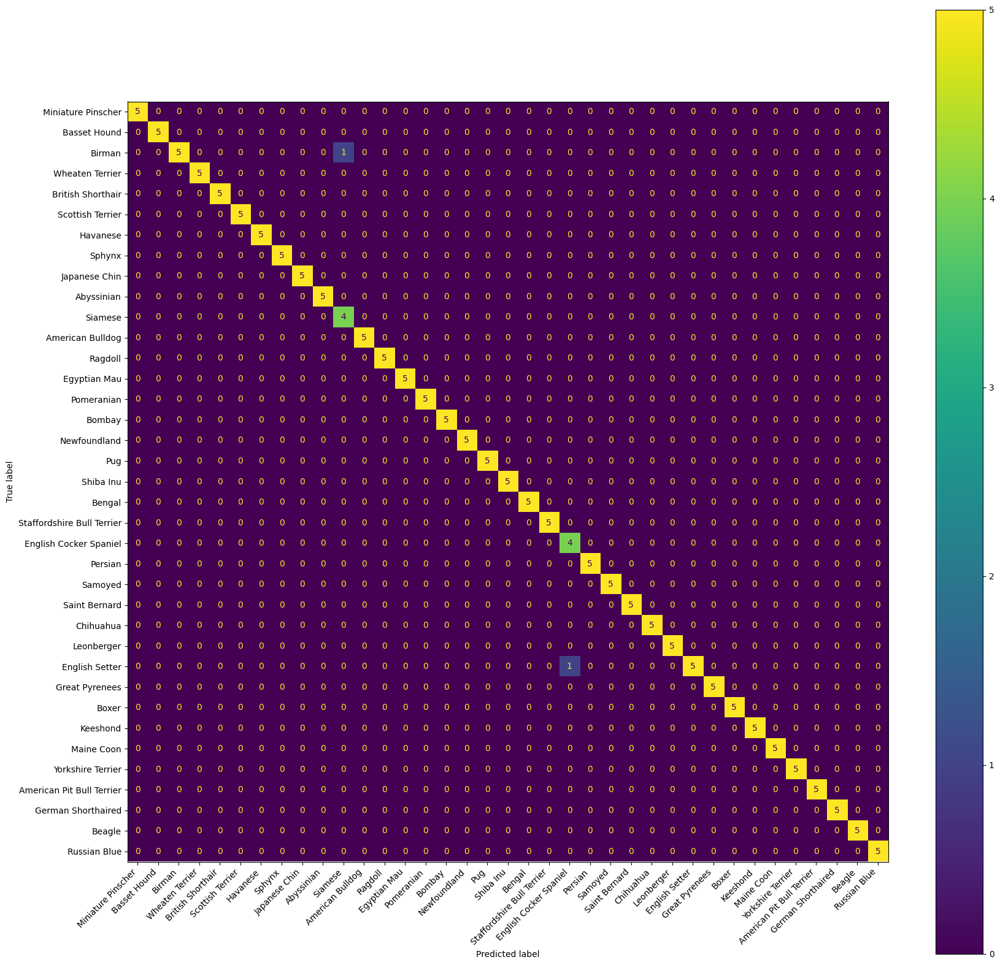

[1,  2750] loss: 0.012
Finished Training
Accuracy on test data: 0.7813134732566012


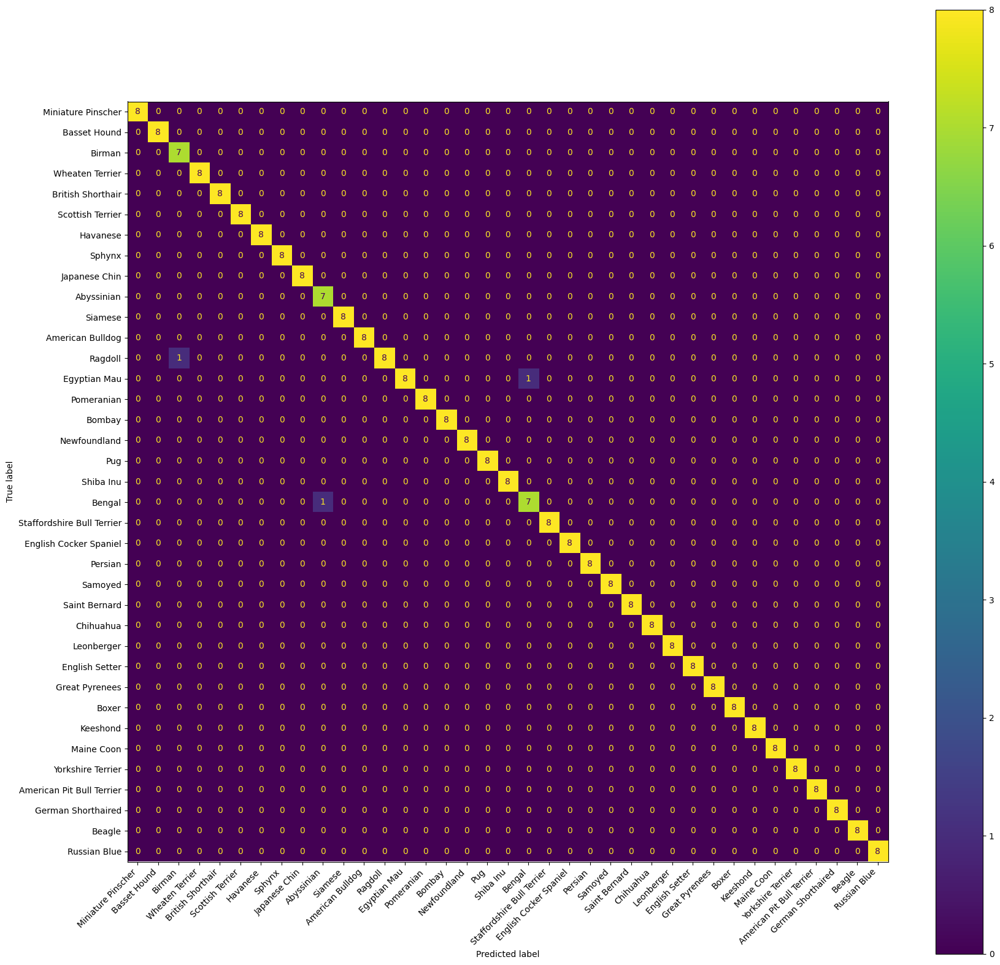

Error occurred at index tensor([6449]): Expected more than 1 value per channel when training, got input size torch.Size([1, 512])
[1,  2850] loss: 0.012
Finished Training
Accuracy on test data: 0.7880839539607312


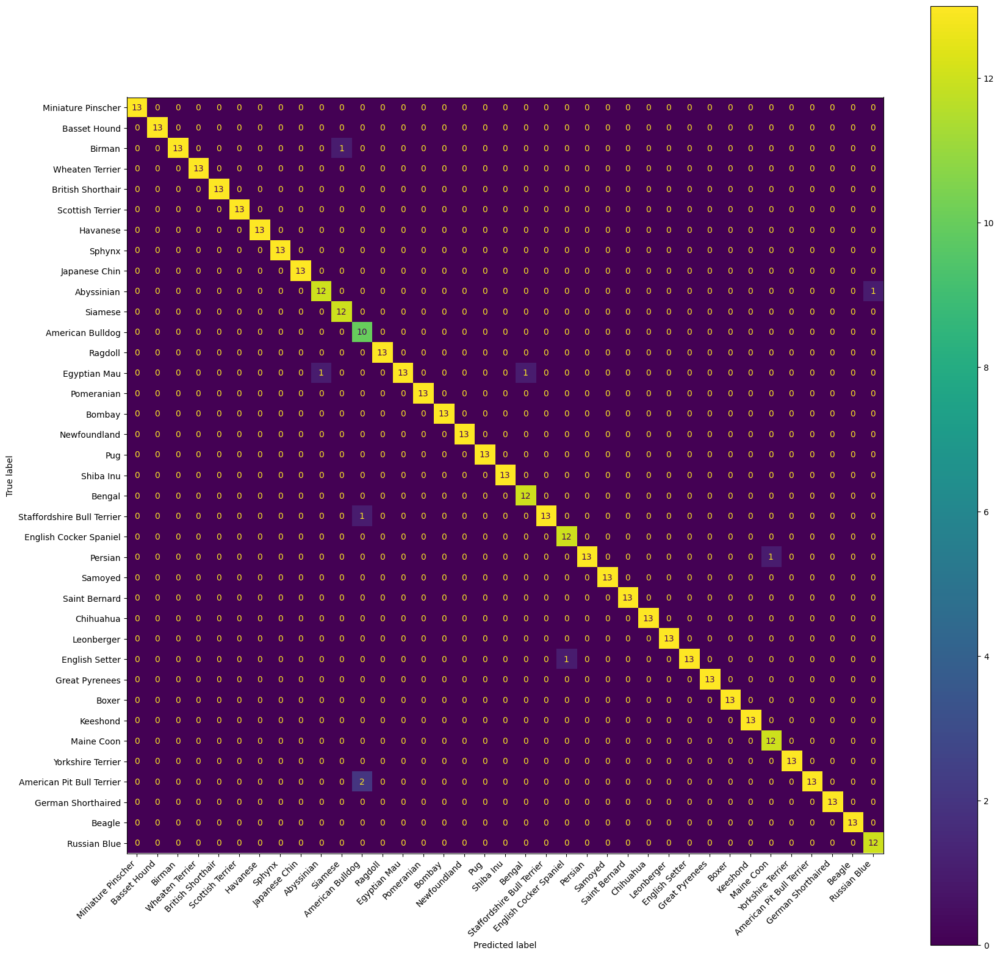

[1,  3050] loss: 0.015
Finished Training
Accuracy on test data: 0.7880839539607312


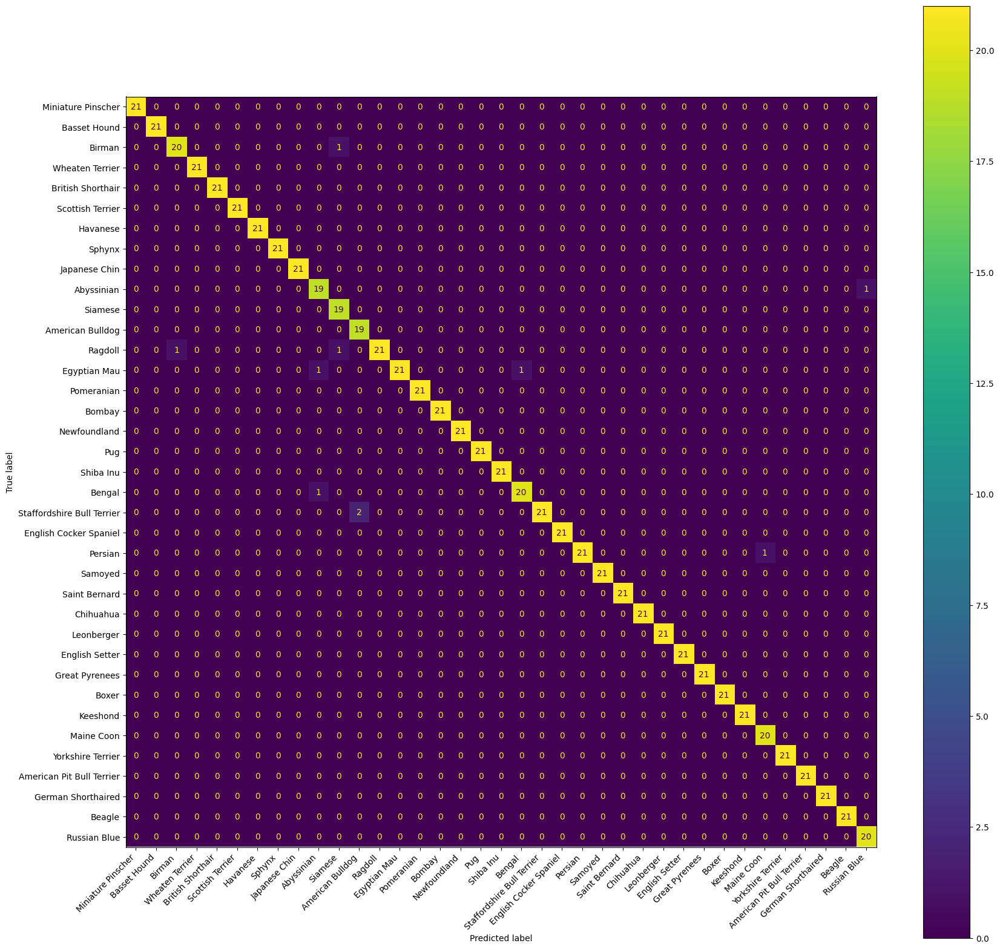

[1,  3350] loss: 0.019
Finished Training
Accuracy on test data: 0.7887610020311442


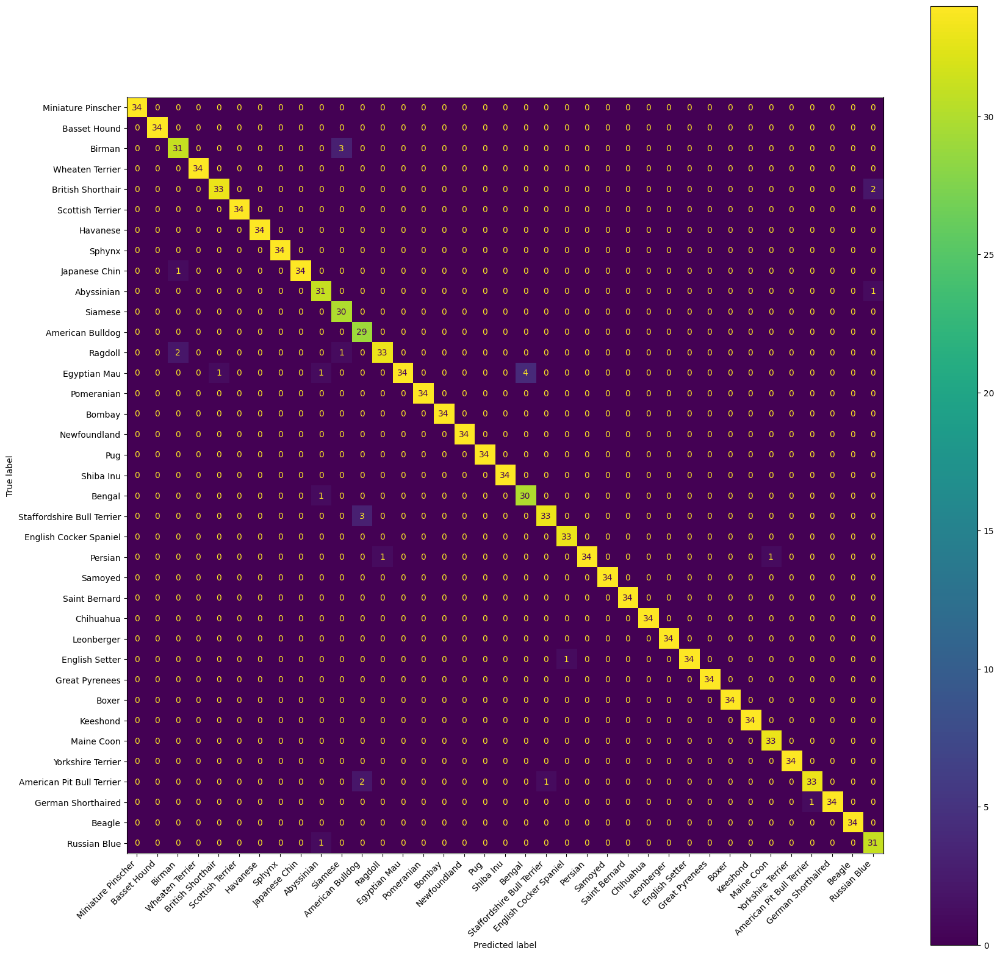

[1,  3825] loss: 0.025
Finished Training
Accuracy on test data: 0.8056872037914692


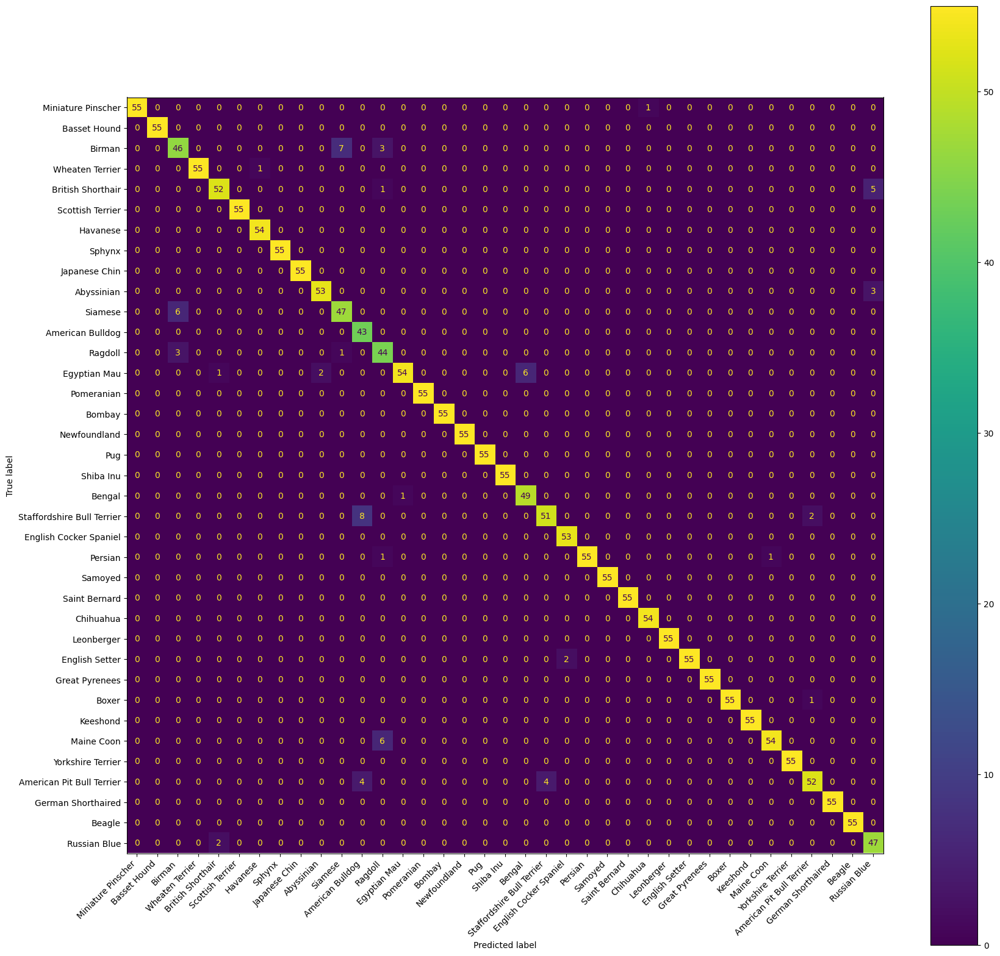

[1,  2000] loss: 0.028
[1,  4600] loss: 0.009
Finished Training
Accuracy on test data: 0.8232904536222072


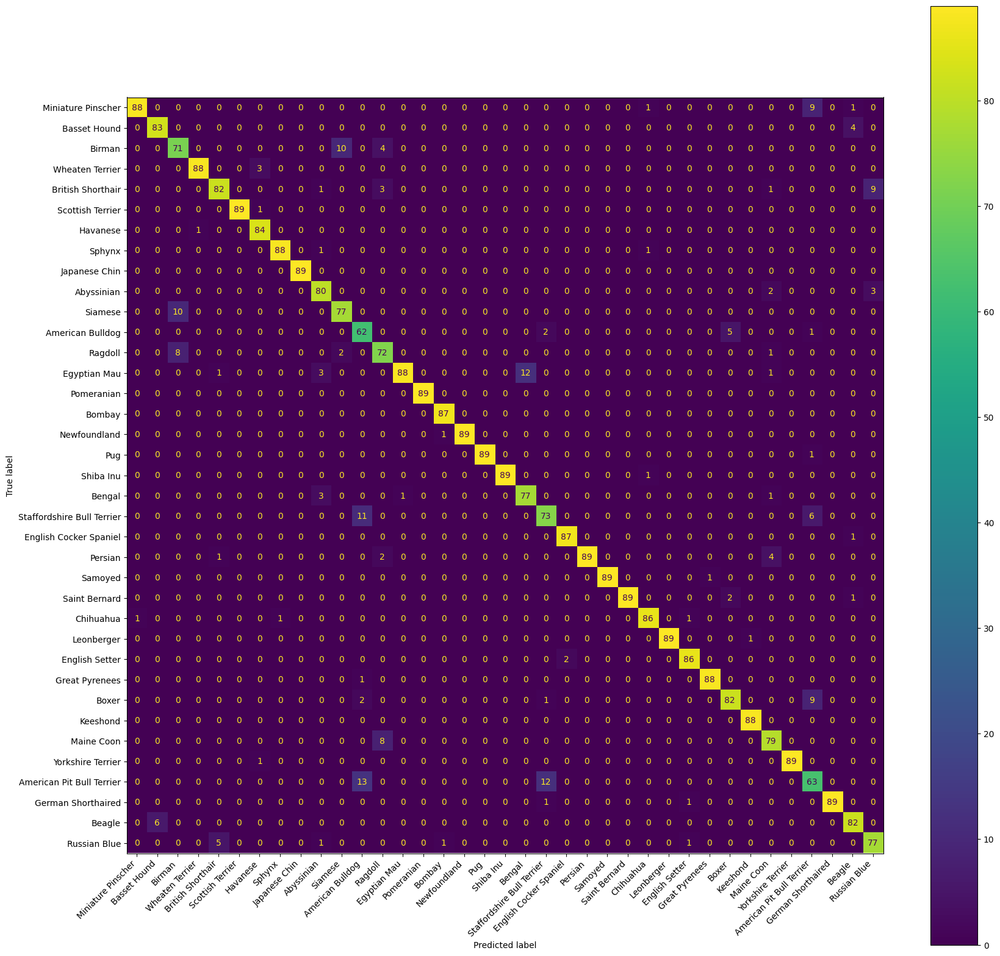

[1,  2000] loss: 0.027
[1,  5850] loss: 0.026
Finished Training
Accuracy on test data: 0.8212593094109681


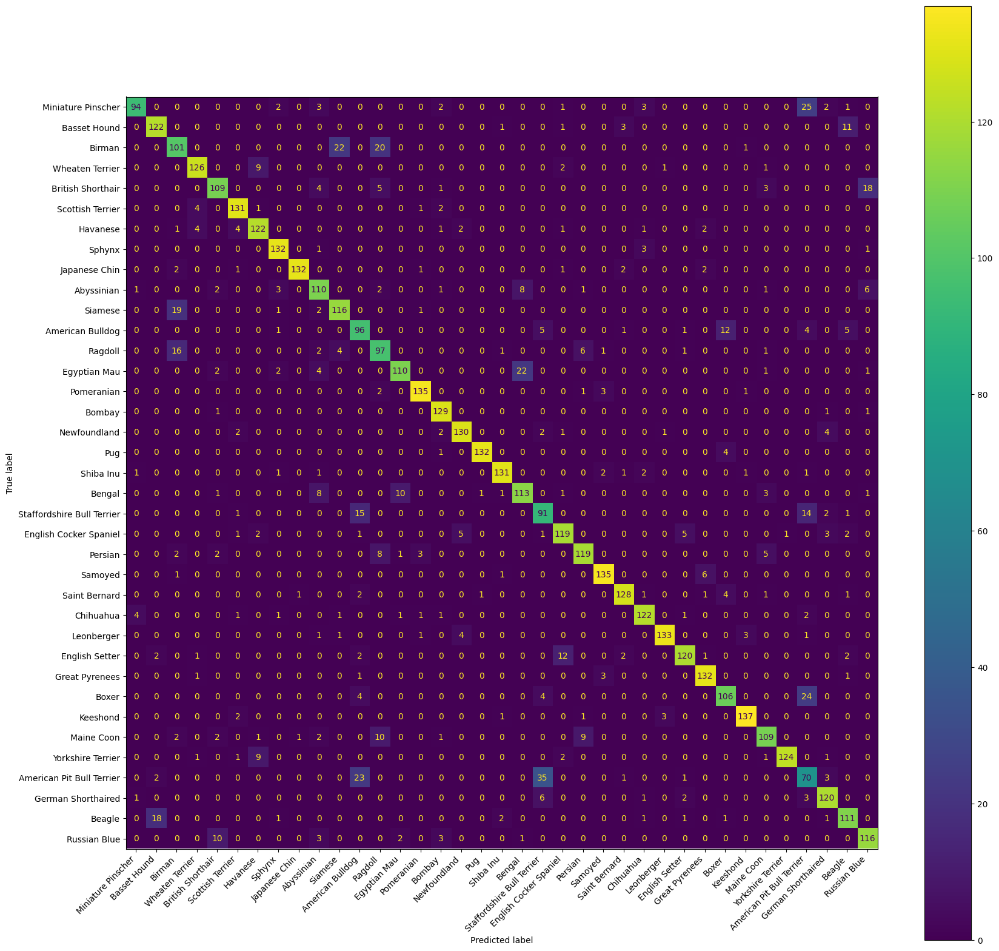

[1,  2000] loss: 0.034
[1,  4000] loss: 0.036
[1,  7650] loss: 0.027
Finished Training
Accuracy on test data: 0.8348002708192281


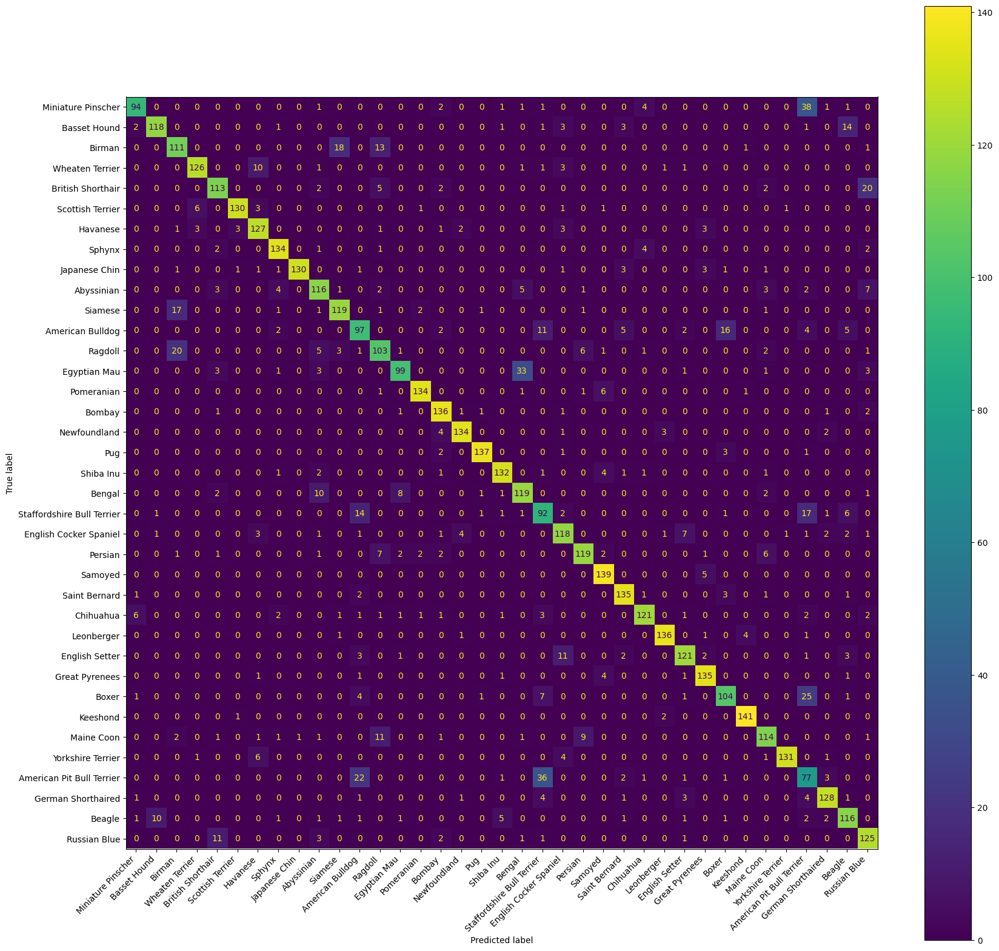

[1,  2000] loss: 0.032
[1,  4000] loss: 0.033
[1,  7875] loss: 0.031
Finished Training
Accuracy on test data: 0.8314150304671631
[1,  2000] loss: 0.029
[1,  4000] loss: 0.029
[1,  7875] loss: 0.028
[2,  2000] loss: 0.027
[2,  4000] loss: 0.027
[2,  7875] loss: 0.026
[3,  2000] loss: 0.026
[3,  4000] loss: 0.026
[3,  7875] loss: 0.023
[4,  2000] loss: 0.025
[4,  4000] loss: 0.024
[4,  7875] loss: 0.023
[5,  2000] loss: 0.023
[5,  4000] loss: 0.023
[5,  7875] loss: 0.022
Finished Training


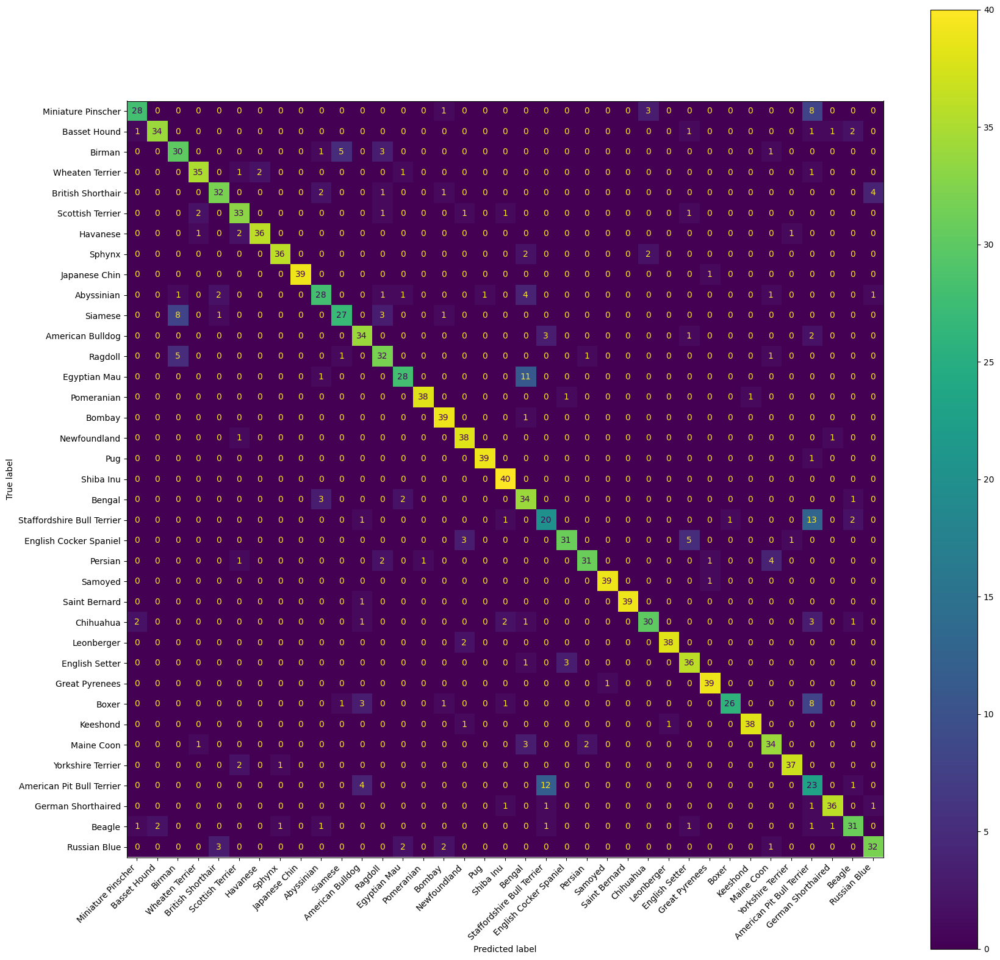

Final accuracy on test data: 0.8395396073121192


In [16]:
main(unlabeled_percentage=0.9, extra_layers=[None], epochs=10, enable_batch_norm=True, prediction_threshold=0.45)

[1,  2000] loss: 0.034
[1,  5000] loss: 0.012
[2,  2000] loss: 0.019
[2,  5000] loss: 0.010
[3,  2000] loss: 0.017
[3,  5000] loss: 0.009
[4,  2000] loss: 0.015
[4,  5000] loss: 0.008
[5,  2000] loss: 0.014
[5,  5000] loss: 0.007
Finished Training
Accuracy on test data: 0.8544346648612051


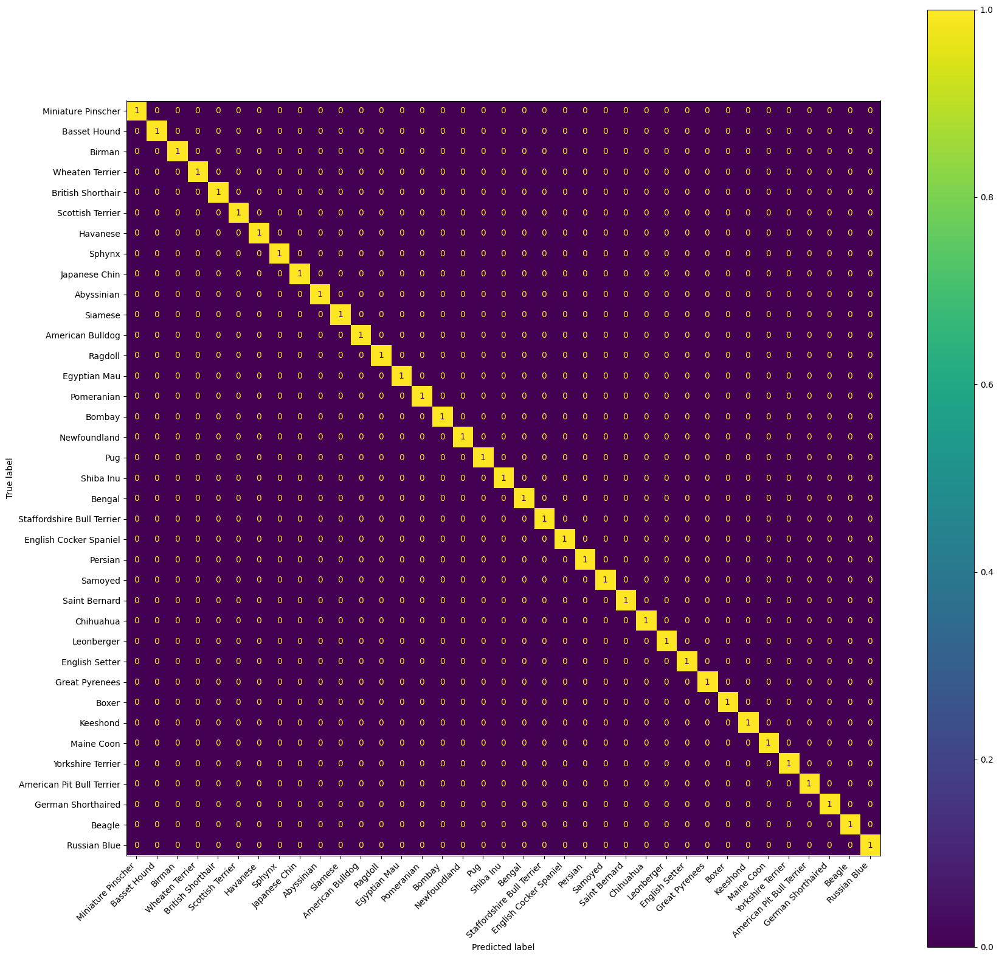

[1,  2000] loss: 0.037
[1,  5000] loss: 0.019
Finished Training
Accuracy on test data: 0.8544346648612051


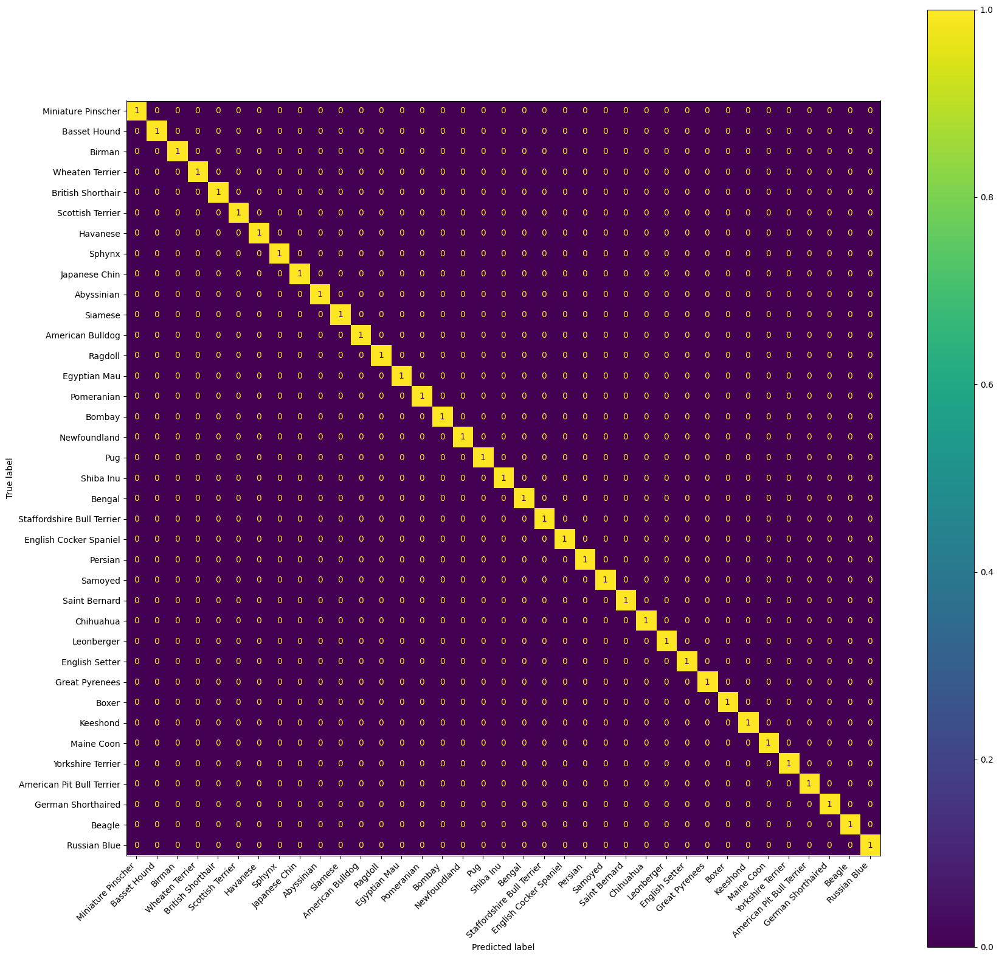

[1,  2000] loss: 0.034
[1,  5000] loss: 0.018
Finished Training
Accuracy on test data: 0.8591740013540962


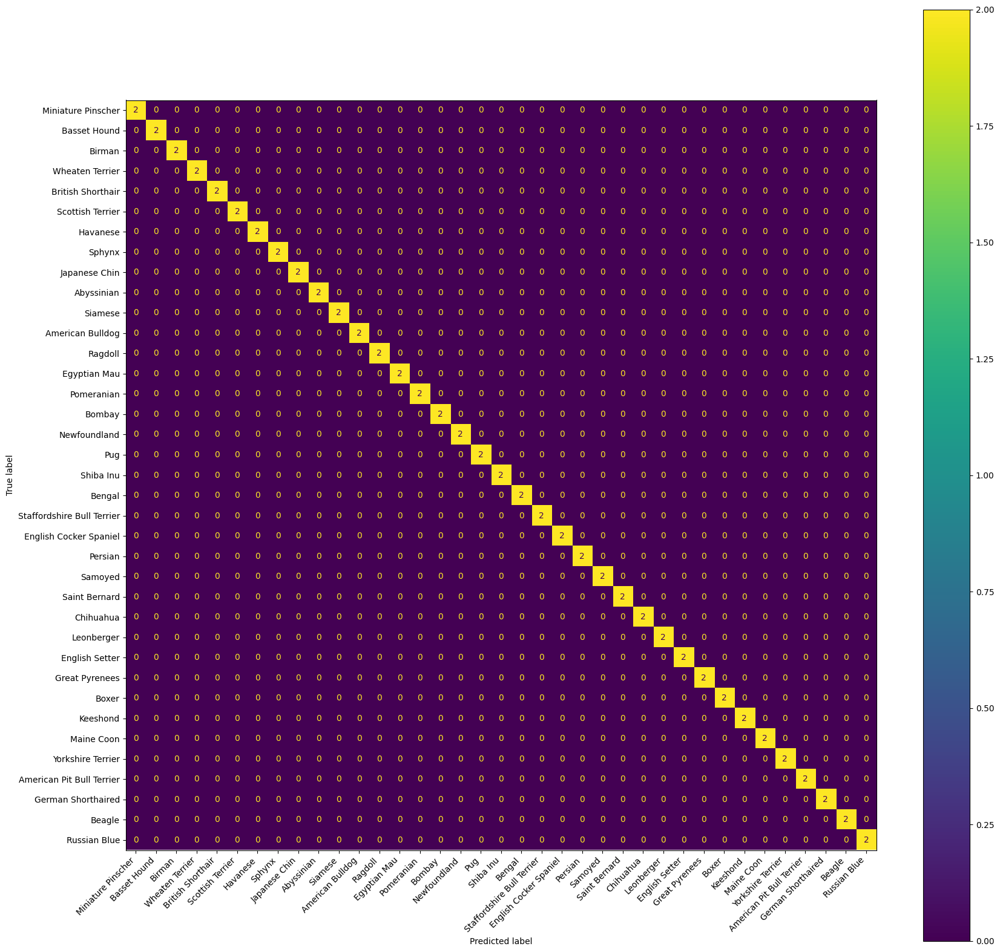

[1,  2000] loss: 0.032
[1,  5050] loss: 0.017
Finished Training
Accuracy on test data: 0.8429248476641842


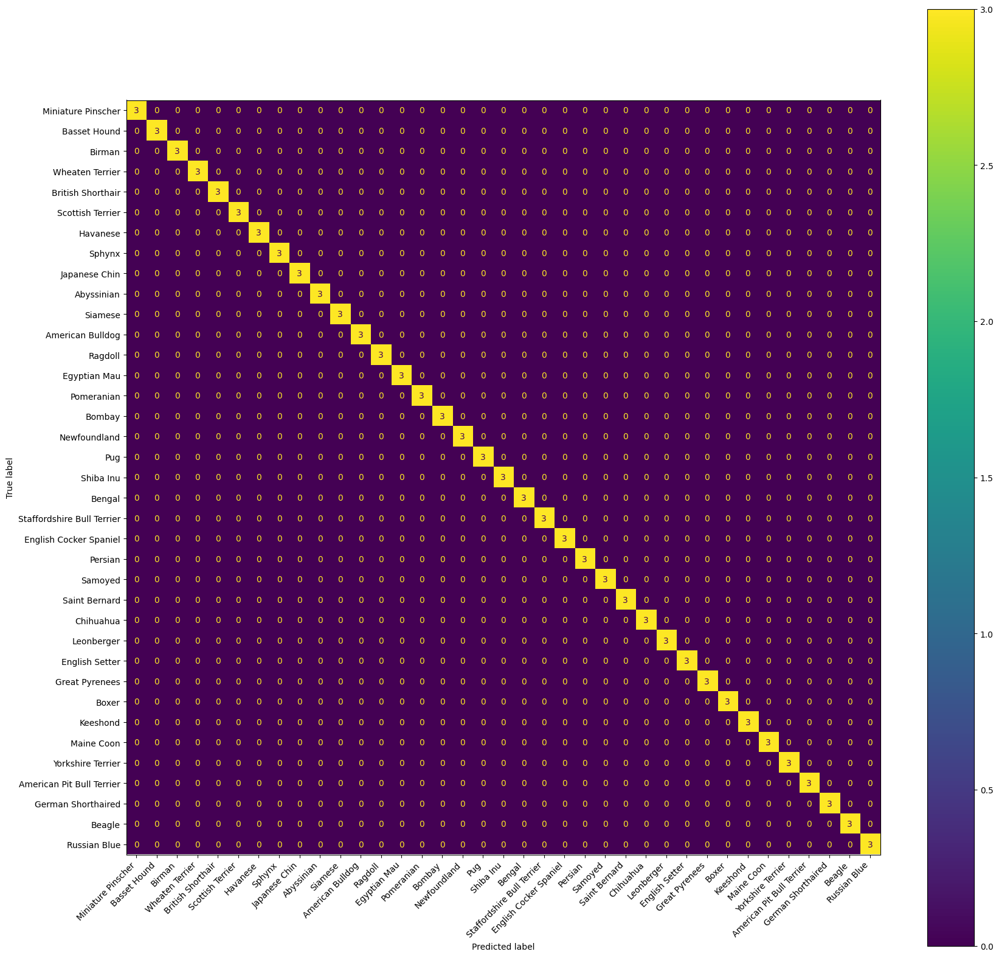

[1,  2000] loss: 0.030
[1,  5075] loss: 0.017
Finished Training
Accuracy on test data: 0.8510494245091401


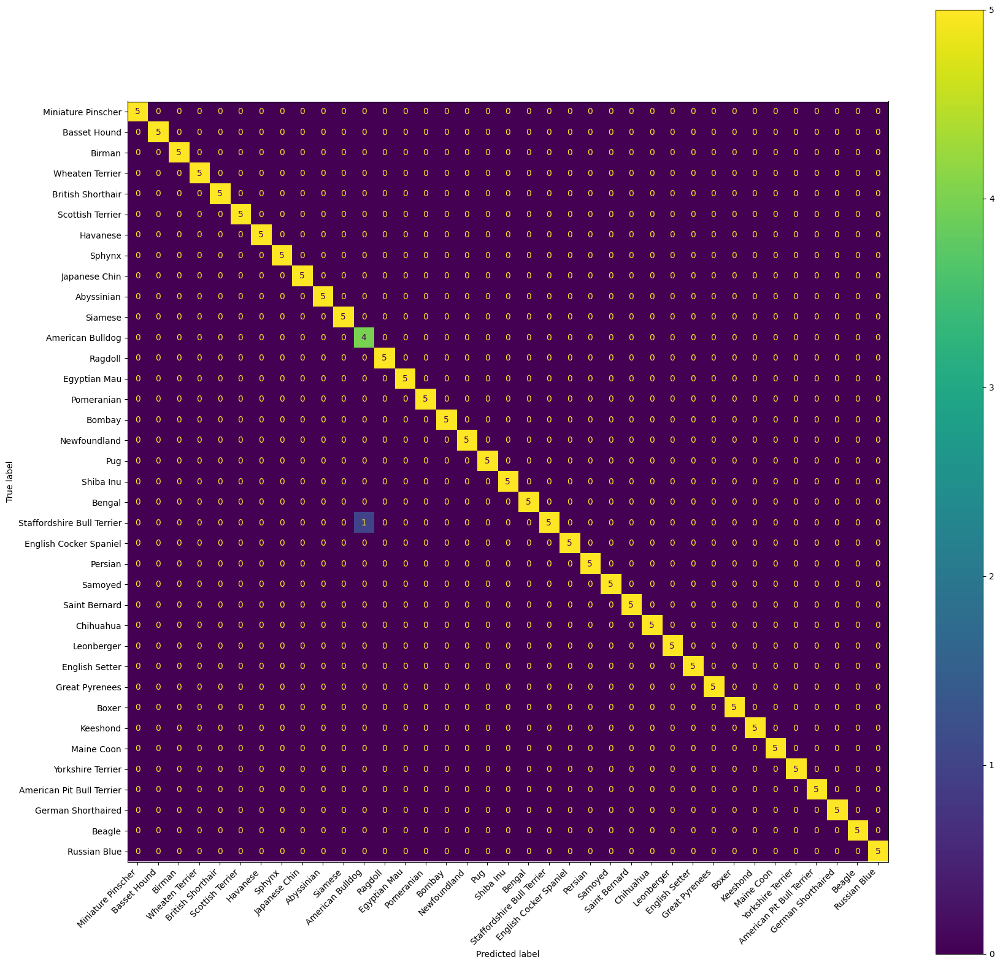

[1,  2000] loss: 0.028
[1,  5150] loss: 0.016
Finished Training
Accuracy on test data: 0.8605280974949221


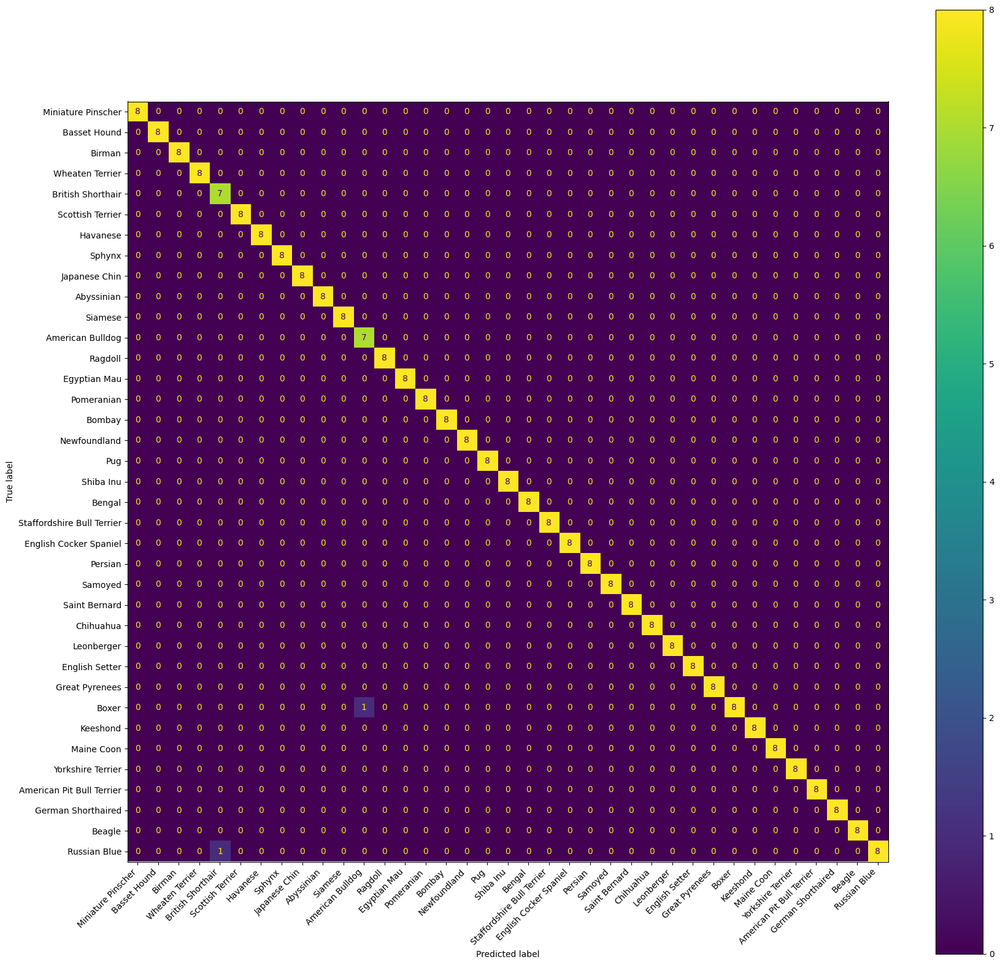

[1,  2000] loss: 0.025
Error occurred at index tensor([7158]): Expected more than 1 value per channel when training, got input size torch.Size([1, 512])
[1,  5250] loss: 0.017
Finished Training
Accuracy on test data: 0.8436018957345972


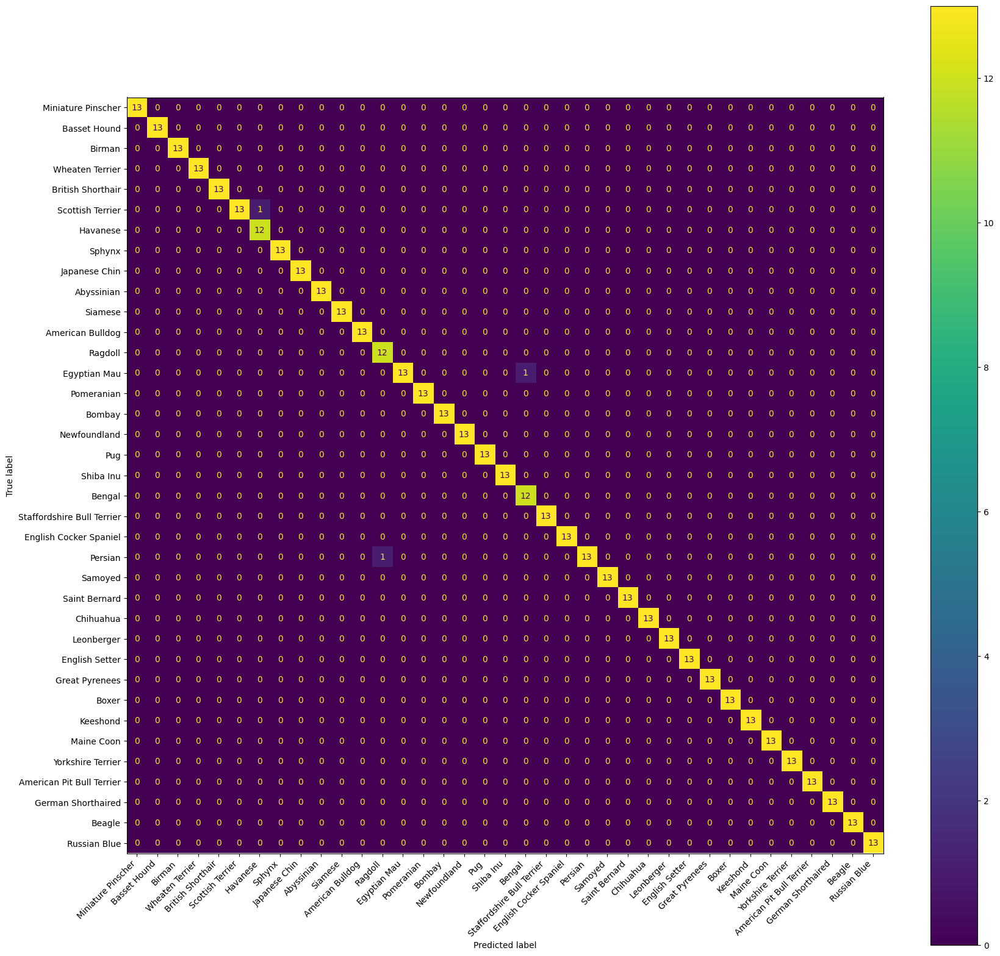

[1,  2000] loss: 0.024
[1,  5450] loss: 0.018
Finished Training
Accuracy on test data: 0.8544346648612051


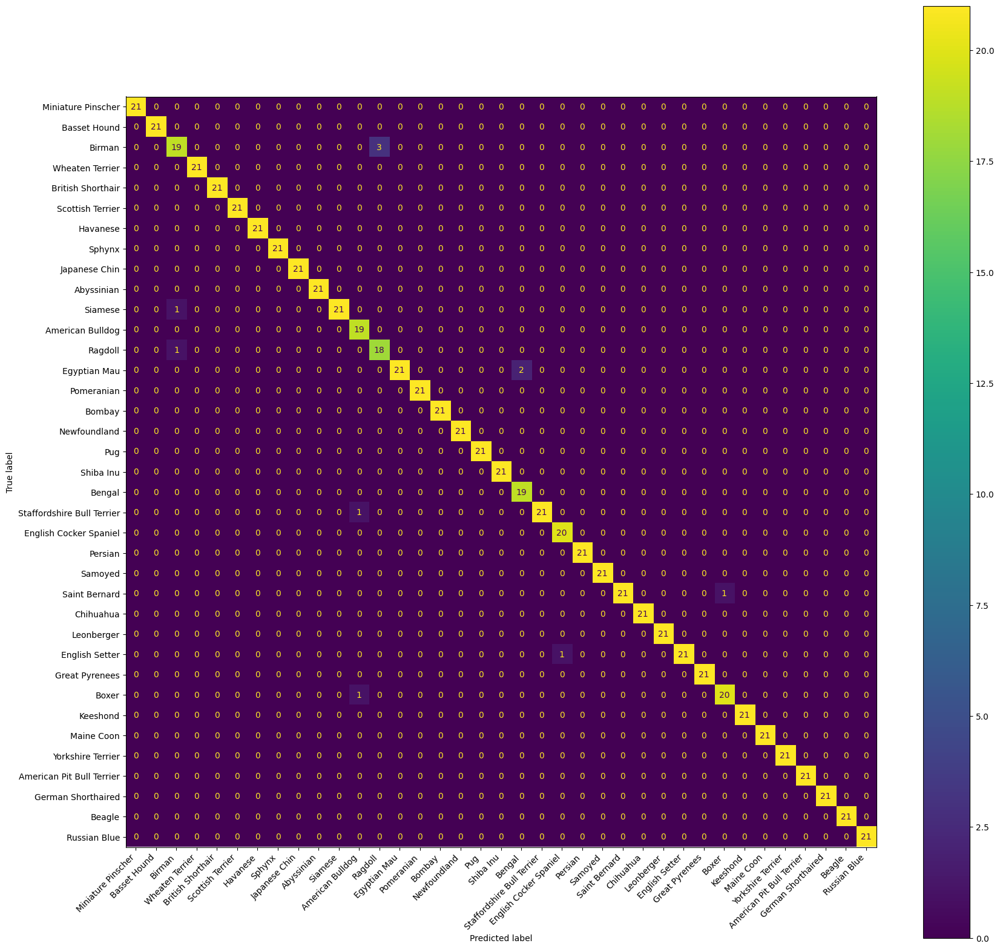

[1,  2000] loss: 0.022
[1,  5750] loss: 0.020
Finished Training
Accuracy on test data: 0.8618821936357481


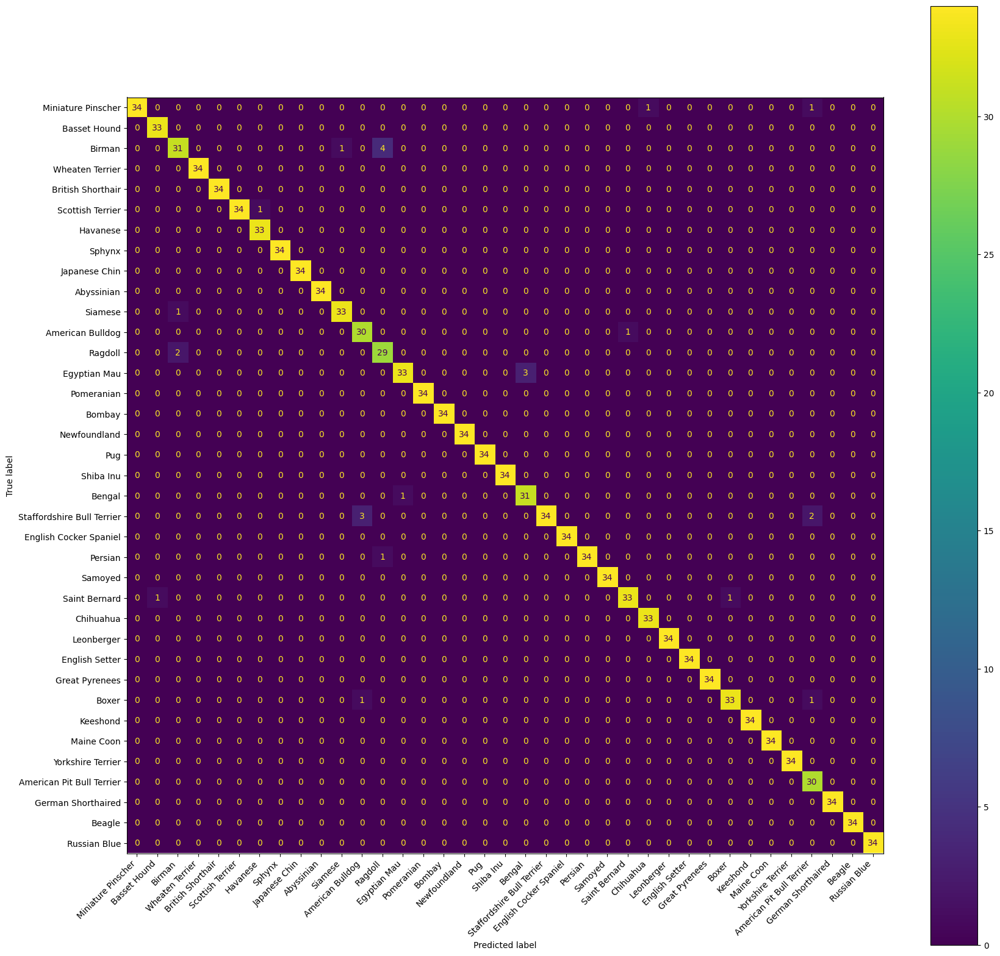

[1,  2000] loss: 0.022
[1,  4000] loss: 0.022
[1,  6225] loss: 0.003
Finished Training
Accuracy on test data: 0.8476641841570751


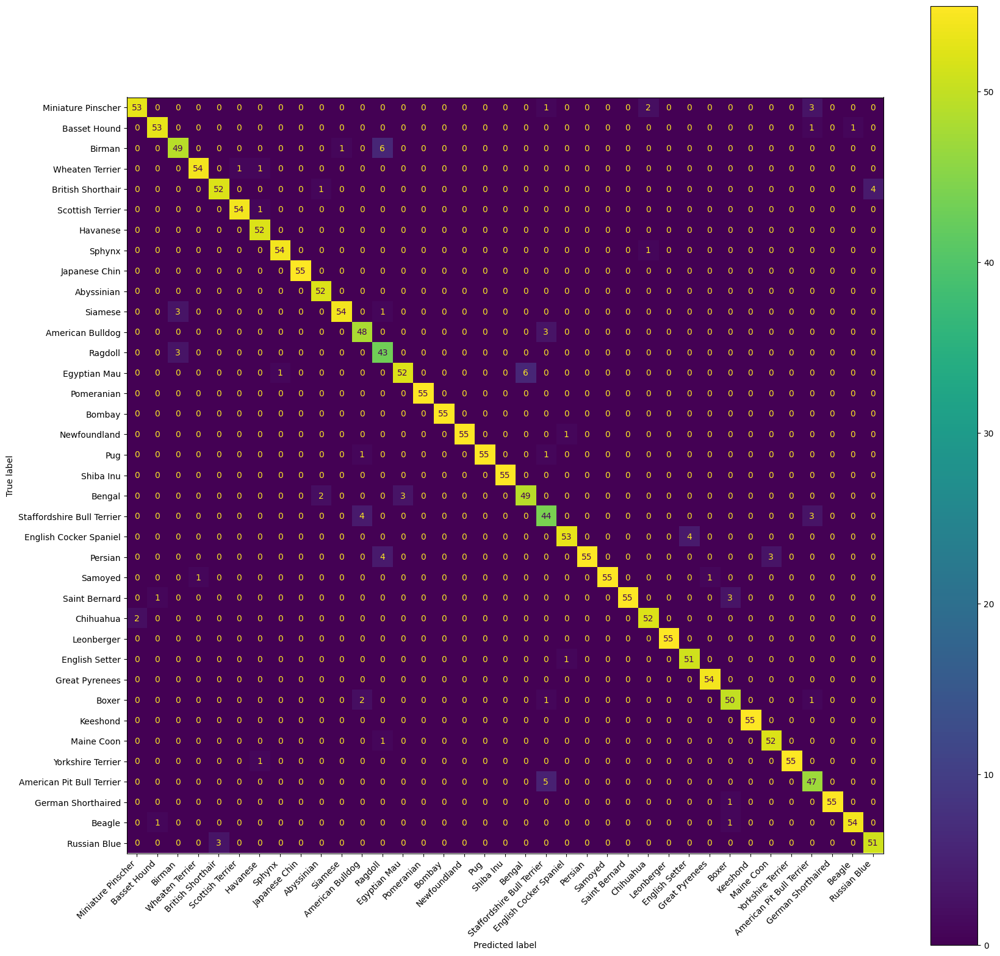

[1,  2000] loss: 0.022
[1,  4000] loss: 0.023
[1,  7000] loss: 0.011
Finished Training
Accuracy on test data: 0.8612051455653351


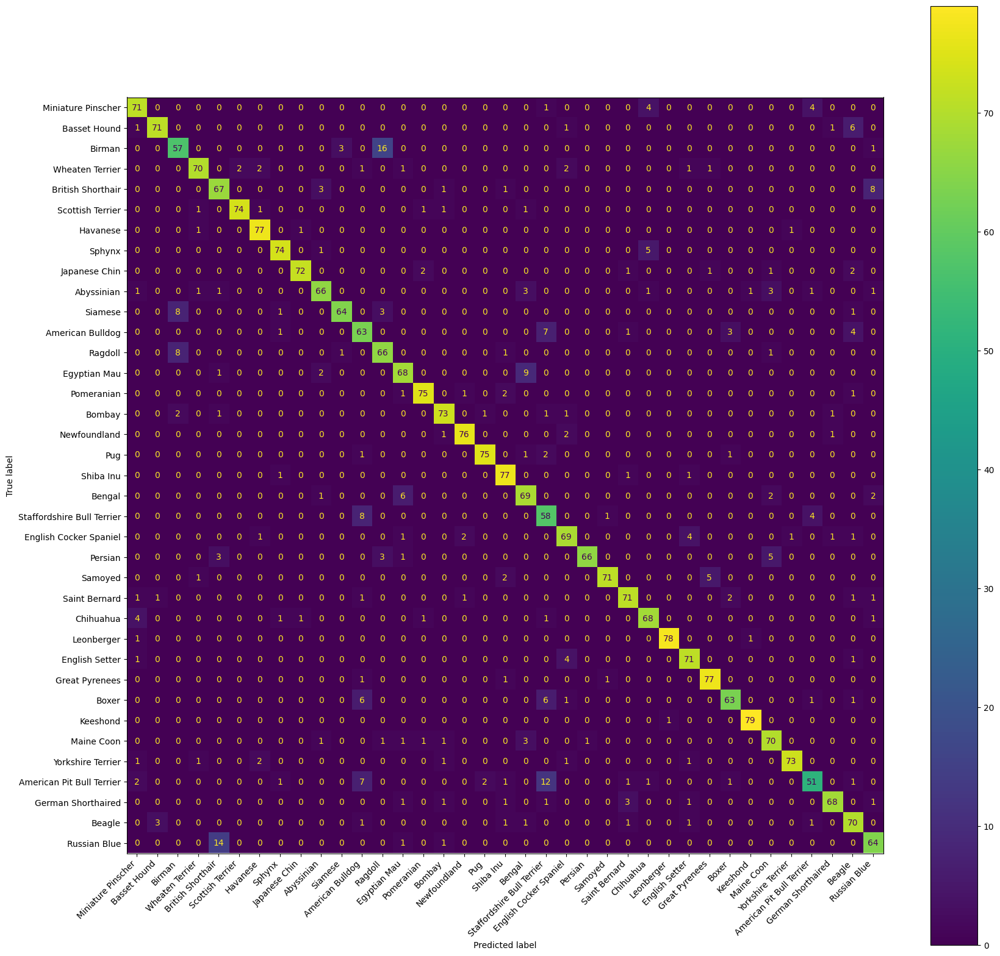

[1,  2000] loss: 0.026
[1,  4000] loss: 0.025
Error occurred at index tensor([3167]): Expected more than 1 value per channel when training, got input size torch.Size([1, 512])
[1,  7875] loss: 0.024
Finished Training
Accuracy on test data: 0.8625592417061612


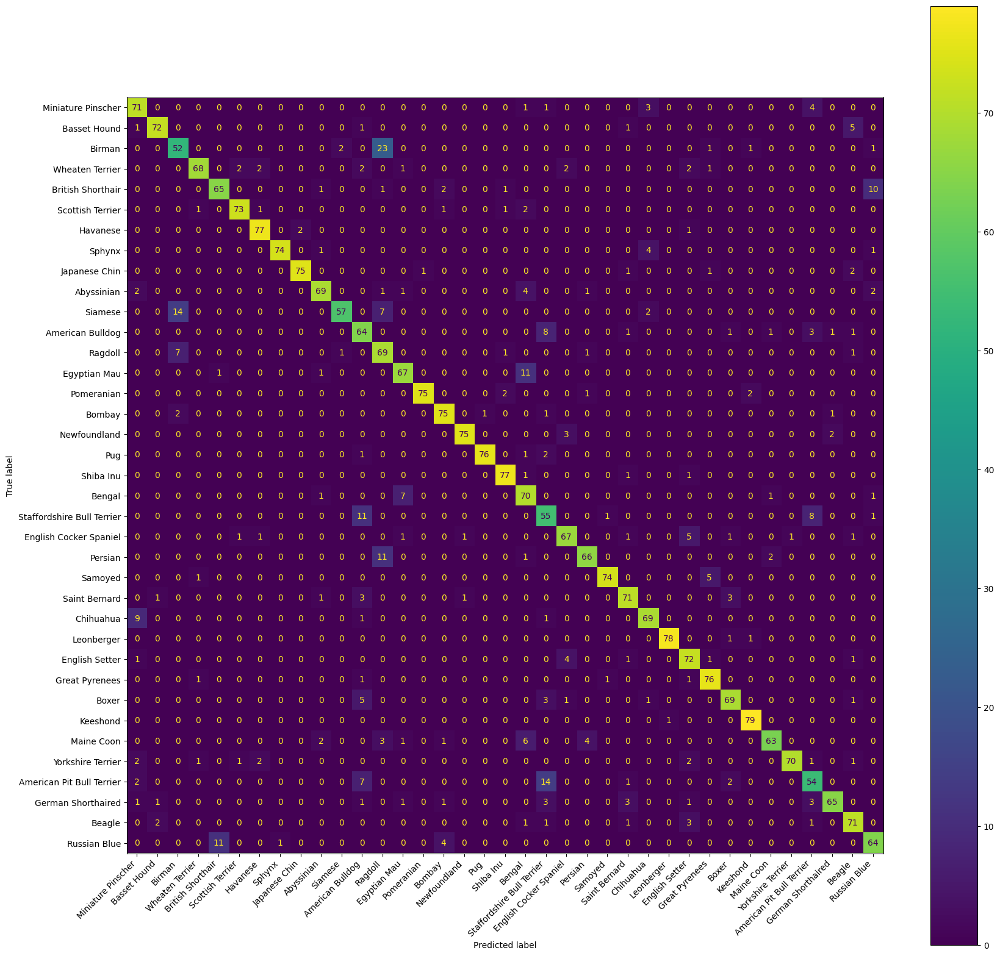

[1,  2000] loss: 0.024
[1,  4000] loss: 0.025
[1,  7925] loss: 0.025
Finished Training
Accuracy on test data: 0.8503723764387271
[1,  2000] loss: 0.023
[1,  4000] loss: 0.023
[1,  7925] loss: 0.022
[2,  2000] loss: 0.022
[2,  4000] loss: 0.021
[2,  7925] loss: 0.022
[3,  2000] loss: 0.019
[3,  4000] loss: 0.020
[3,  7925] loss: 0.020
[4,  2000] loss: 0.019
[4,  4000] loss: 0.019
[4,  7925] loss: 0.018
[5,  2000] loss: 0.017
[5,  4000] loss: 0.018
[5,  7925] loss: 0.018
Finished Training


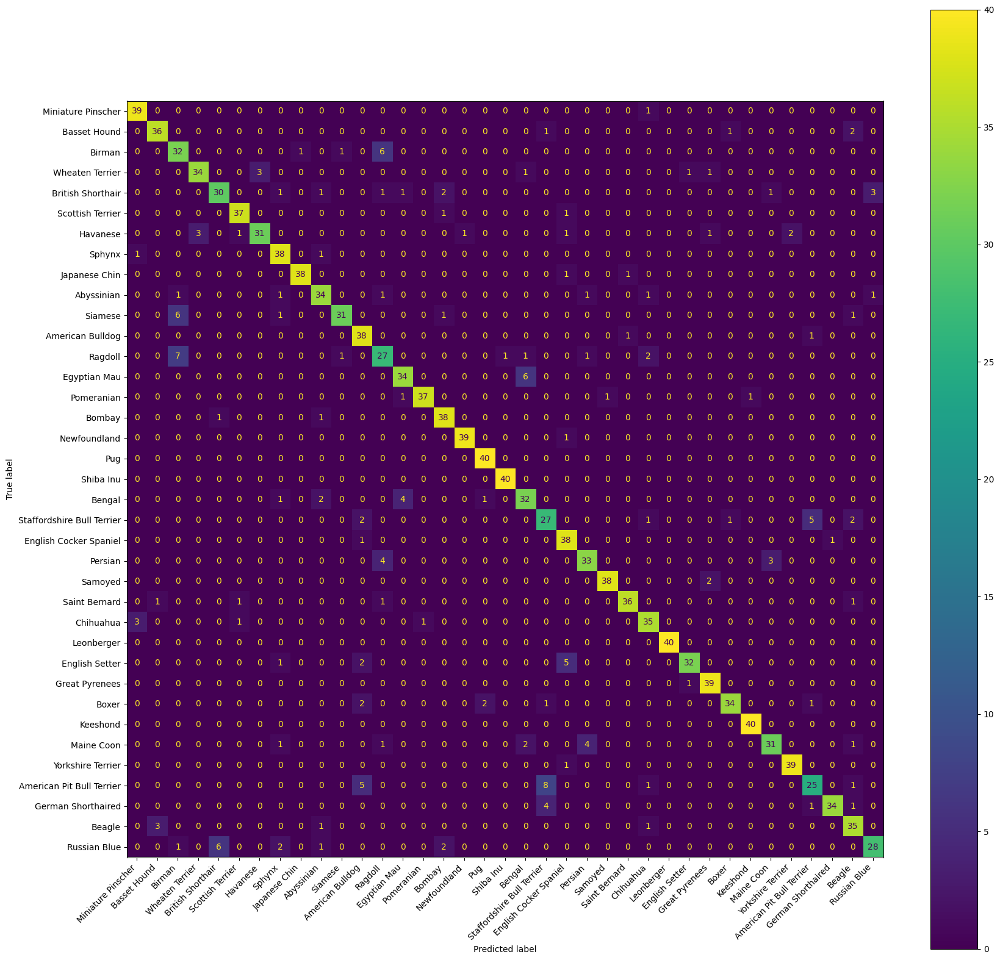

Final accuracy on test data: 0.8727149627623562


In [15]:
main(unlabeled_percentage=0.5, extra_layers=[None], epochs=10, enable_batch_norm=True, prediction_threshold=0.45)